<a href="https://colab.research.google.com/github/fangyu070899/GAI_project4_Technical_Integration_of_DDPM_and_DIP/blob/main/main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [16]:
from google.colab import drive
import sys
drive.mount('/content/drive')
sys.path.append('/content/drive/MyDrive/Colab Notebooks/GAI_project4')
sys.path.append('/content/drive/MyDrive/Colab Notebooks/GAI_project4/ddpm_models')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [17]:
# ! pip install --upgrade setuptools
# ! pip install torch
# ! pip install scikit-image==0.16.2
# ! pip install pytorch-ignite
# ! pip3 install einops

# Import libs

In [18]:
import pandas as pd

"""
DIP
"""
from __future__ import print_function
%matplotlib inline

import os
#os.environ['CUDA_VISIBLE_DEVICES'] = '3'

from skimage.metrics import peak_signal_noise_ratio as compare_psnr

from dip_models import *
from dip_utils.denoising_utils  import *

"""
DDPM
"""
from UNet import *
from DDPM import *
# Import of libraries
import random
import imageio
import numpy as np
from argparse import ArgumentParser

from tqdm.auto import tqdm
import matplotlib.pyplot as plt

import einops
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.utils.data import DataLoader

import torchvision
from torchsummary import summary
from torchvision.transforms import Compose, ToTensor, Lambda, Resize
from torchvision.datasets.mnist import MNIST, FashionMNIST

# Setup

In [84]:
"""
DIP
"""
torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor

imsize =-1
PLOT = True
sigma = 25
sigma_ = sigma/255.

INPUT = 'noise' # 'meshgrid'
pad = 'reflection'
OPT_OVER = 'net' # 'net,input'

reg_noise_std = 1./30. # set to 1./20. for sigma=50
LR = 0.01

OPTIMIZER='adam' # 'LBFGS'
show_every = 100
exp_weight=0.99

num_iter = 3000
input_depth = 1
figsize = 4

net = get_net(input_depth, 'skip', pad,
                  skip_n33d=128,
                  skip_n33u=128,
                  skip_n11=4,
                  num_scales=3,
                  upsample_mode='bilinear').type(dtype)

# Compute number of parameters
s  = sum([np.prod(list(p.size())) for p in net.parameters()]);
print ('Number of params: %d' % s)

# Loss
mse = torch.nn.MSELoss().type(dtype)

"""
DDPM
"""
# Setting reproducibility
SEED = 0
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)

# Definitions
STORE_PATH_MNIST = f"ddpm_model_mnist.pt"
STORE_PATH_FASHION = f"ddpm_model_fashion.pt"

no_train = False
fashion = True
batch_size = 128
n_epochs = 100
lr = 0.001
store_path = "ddpm_fashion.pt" if fashion else "ddpm_mnist.pt"

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

Number of params: 1250369
cuda


# Show Image

In [20]:
def show_images(images, title=""):
    """Shows the provided images as sub-pictures in a square"""

    # Converting images to CPU numpy arrays
    if type(images) is torch.Tensor:
        images = images.detach().cpu().numpy()

    # Defining number of rows and columns
    fig = plt.figure(figsize=(8, 8))
    rows = int(len(images) ** (1 / 2))
    cols = round(len(images) / rows)

    # Populating figure with sub-plots
    idx = 0
    for r in range(rows):
        for c in range(cols):
            fig.add_subplot(rows, cols, idx + 1)

            if idx < len(images):
                plt.imshow(images[idx][0], cmap="gray")
                idx += 1
    fig.suptitle(title, fontsize=30)

    # Showing the figure
    plt.show()

# Shows the first batch of images
def show_first_batch(loader):
    for batch in loader:
        show_images(batch[0], "Images in the first batch")
        break

def show_forward(ddpm, loader, device):
    # Showing the forward process
    for batch in loader:
        imgs = batch[0]

        show_images(imgs, "Original images")

        for percent in [0.25, 0.5, 0.75, 1]:
            show_images(
                ddpm(imgs.to(device),
                     [int(percent * ddpm.n_steps) - 1 for _ in range(len(imgs))]),
                f"DDPM Noisy images {int(percent * 100)}%"
            )
        break

# Load Data

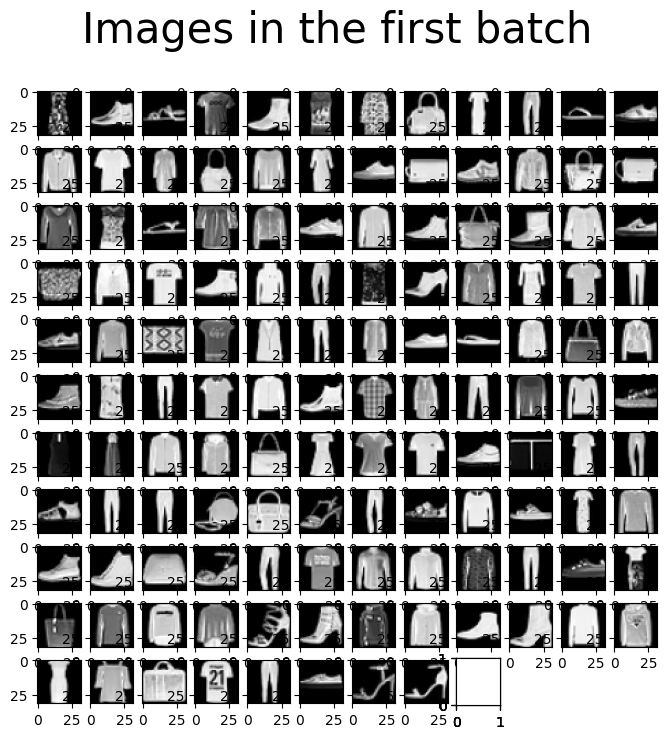

In [21]:
# Loading the data (converting each image into a tensor and normalizing between [-1, 1])
transform = Compose([
    ToTensor(),
    Lambda(lambda x: (x - 0.5) * 2),
    Resize(size=((32,32)))]
)
ds_fn = FashionMNIST if fashion else MNIST
dataset = ds_fn("./datasets", download=True, train=True, transform=transform)
loader = DataLoader(dataset, batch_size, shuffle=True)

show_first_batch(loader)

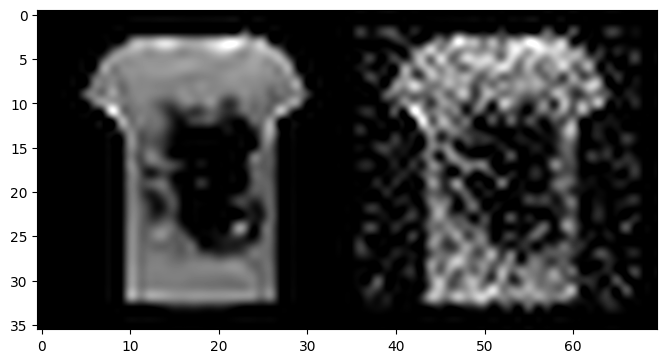

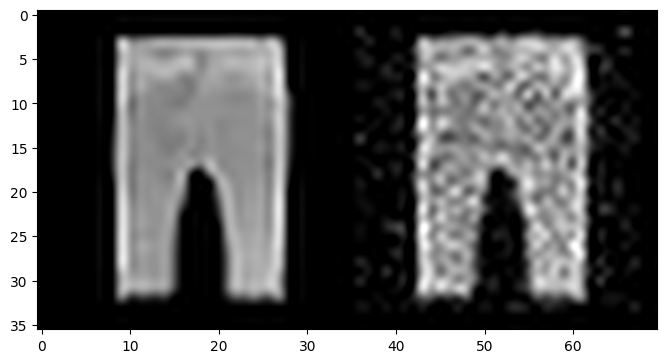

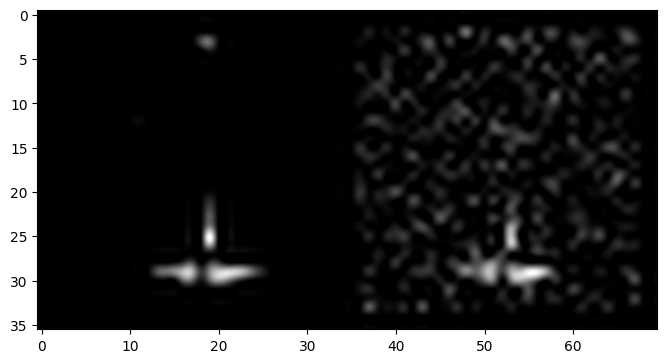

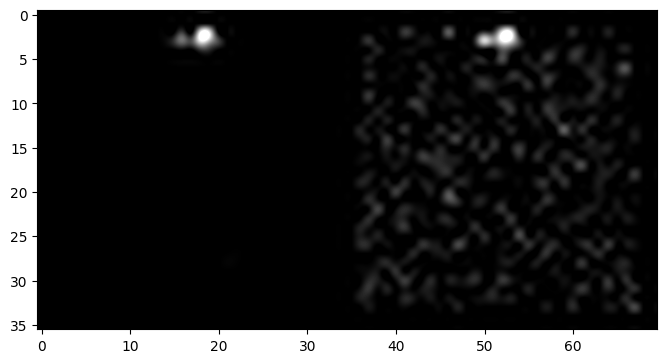

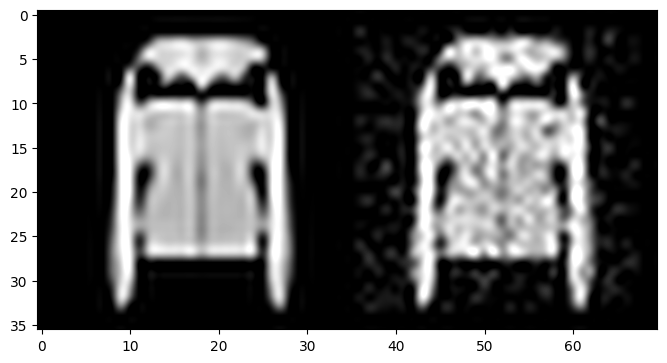

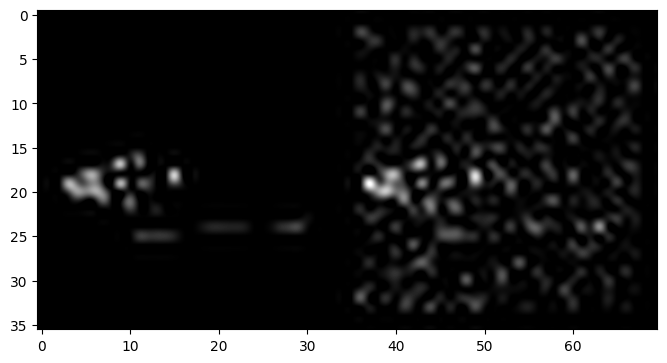

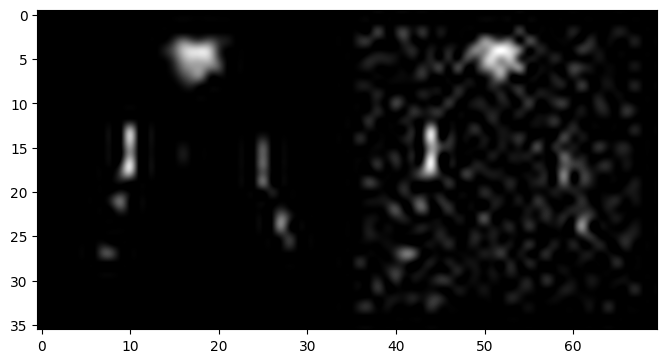

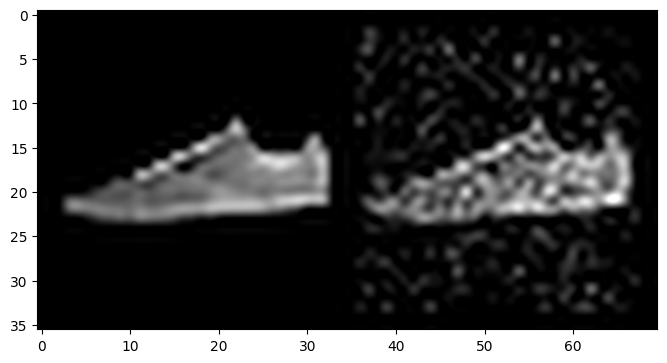

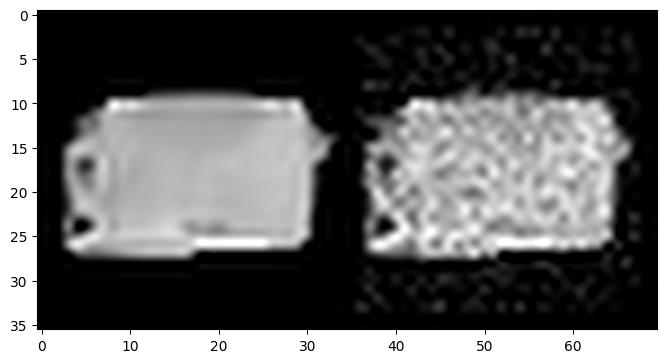

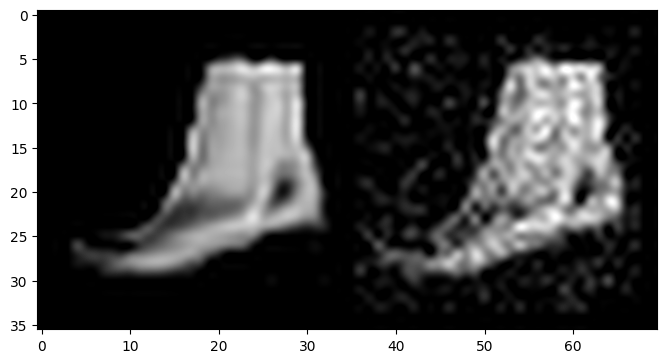

In [22]:
images = np.empty((10, 2, 1, 32, 32))
count = 0

for batch in loader:
  labels = batch[1].detach().cpu().numpy()
  # print(labels)
  for l in range(len(labels)):
    if labels[l] == count:
      imgs = batch[0].detach().cpu().numpy()[l]
      img_pil = np_to_pil(imgs)
      img_np = pil_to_np(img_pil)

      img_noisy_pil, img_noisy_np = get_noisy_image(img_np, sigma_)

      if PLOT:
          plot_image_grid([img_np, img_noisy_np] , 4, 6);

      img_pair = np.stack([img_np, img_noisy_np], axis=0)

      images[count] = img_pair
      count += 1
      if count == 10: break


# Optimize

In [23]:
out_json = []
out_avg = None
last_net = None
psrn_noisy_last = 0
i = 0

def closure():

    global i, out_avg, psrn_noisy_last, last_net, net_input

    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)

    out = net(net_input)

    # print(f"out.shape:{out.shape}")

    # Smoothing
    if out_avg is None:
        out_avg = out.detach()
    else:
        out_avg = out_avg * exp_weight + out.detach() * (1 - exp_weight)

    total_loss = mse(out, img_noisy_torch)
    total_loss.backward()

    psrn_noisy = compare_psnr(img_noisy_np, out.detach().cpu().numpy()[0])
    psrn_gt    = compare_psnr(img_np, out.detach().cpu().numpy()[0])
    psrn_gt_sm = compare_psnr(img_np, out_avg.detach().cpu().numpy()[0])

    # Note that we do not have GT for the "snail" example
    # So 'PSRN_gt', 'PSNR_gt_sm' make no sense
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np, 0, 1),
                         np.clip(torch_to_np(out_avg), 0, 1)], factor=figsize, nrow=1)
        print (f'Iteration {i}    Loss {total_loss.item()}   PSNR_noisy: {psrn_noisy}   PSRN_gt:{psrn_gt}  PSNR_gt_sm: {psrn_gt_sm}' )
        out_json.append({"Loss":total_loss.item(),"PSNR_noisy":psrn_noisy,"PSRN_gt":psrn_gt,"PSNR_gt_sm":psrn_gt_sm})

    # Backtracking
    if i % show_every:
        if psrn_noisy - psrn_noisy_last < -5:
            print('Falling back to previous checkpoint.')

            for new_param, net_param in zip(last_net, net.parameters()):
                net_param.data.copy_(new_param.cuda())

            return total_loss*0
        else:
            last_net = [x.detach().cpu() for x in net.parameters()]
            psrn_noisy_last = psrn_noisy

    i += 1

    return total_loss


Starting optimization with ADAM


<ipython-input-23-f9b21c61f574>:27: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psrn_noisy = compare_psnr(img_noisy_np, out.detach().cpu().numpy()[0])
<ipython-input-23-f9b21c61f574>:28: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psrn_gt    = compare_psnr(img_np, out.detach().cpu().numpy()[0])
<ipython-input-23-f9b21c61f574>:29: UserWarning: Inputs have mismatched dtype.  Setting data_range based on image_true.
  psrn_gt_sm = compare_psnr(img_np, out_avg.detach().cpu().numpy()[0])


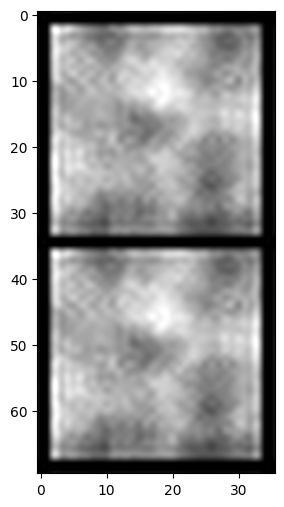

Iteration 0    Loss 0.13110476732254028   PSNR_noisy: 9.004889348066058   PSRN_gt:8.635448038442854  PSNR_gt_sm: 8.635448038442854


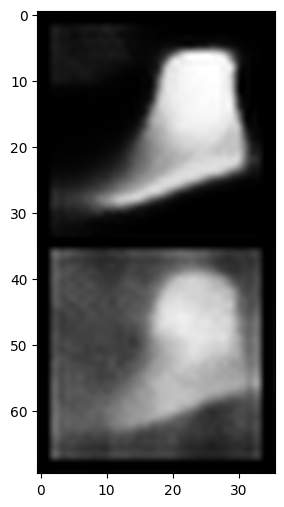

Iteration 100    Loss 0.010673025622963905   PSNR_noisy: 10.490982396119472   PSRN_gt:10.574121663485318  PSNR_gt_sm: 11.388582805219691


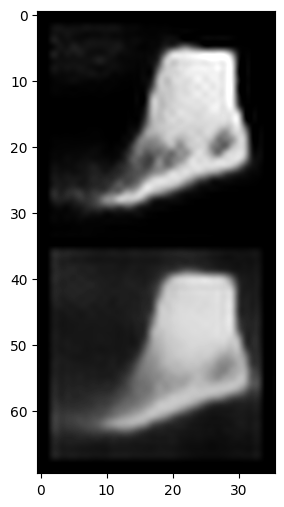

Iteration 200    Loss 0.007064435631036758   PSNR_noisy: 10.280524384465137   PSRN_gt:10.351786456328016  PSNR_gt_sm: 11.033521984084004


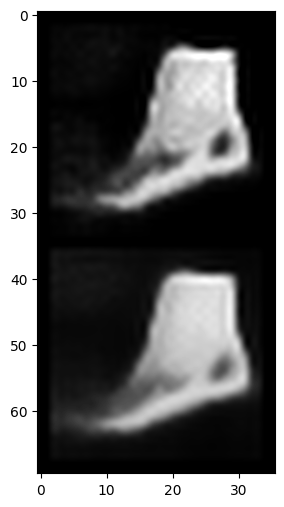

Iteration 300    Loss 0.006257896311581135   PSNR_noisy: 10.33827084444681   PSRN_gt:10.412850400352998  PSNR_gt_sm: 10.607995737917953


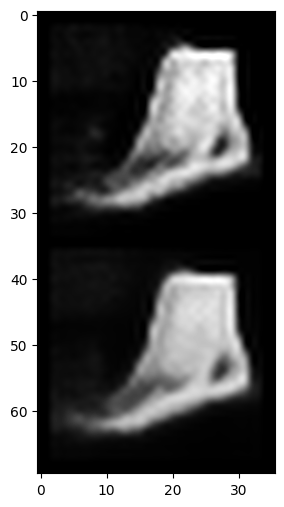

Iteration 400    Loss 0.005106193013489246   PSNR_noisy: 10.135483378628587   PSRN_gt:10.195108974495488  PSNR_gt_sm: 10.40962539002055


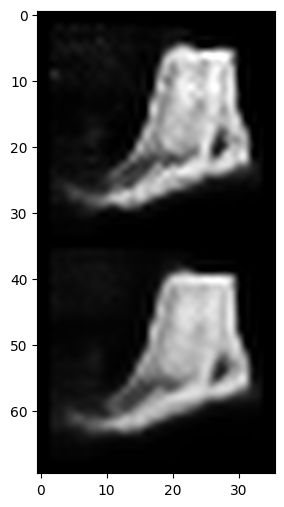

Iteration 500    Loss 0.004510660655796528   PSNR_noisy: 10.142044709073186   PSRN_gt:10.194939275461845  PSNR_gt_sm: 10.326826576142887


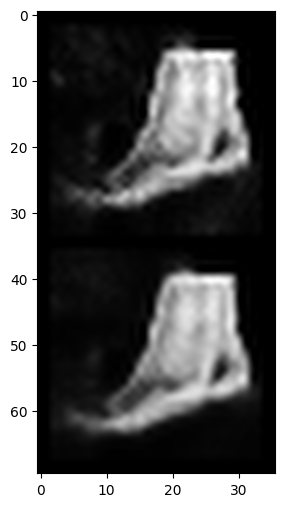

Iteration 600    Loss 0.0037290966138243675   PSNR_noisy: 10.21910342111174   PSRN_gt:10.260527010480633  PSNR_gt_sm: 10.306298531992121


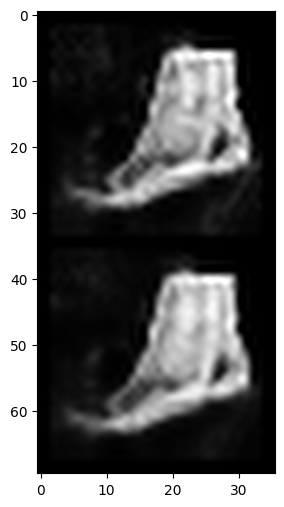

Iteration 700    Loss 0.0035890797153115273   PSNR_noisy: 10.406906509780791   PSRN_gt:10.444073135971493  PSNR_gt_sm: 10.300104590749672


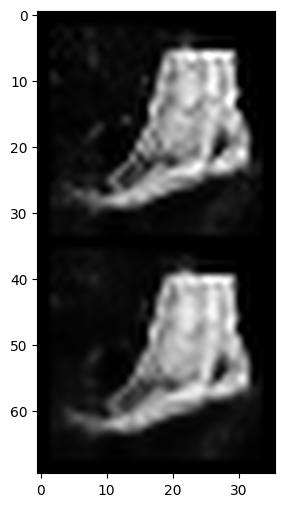

Iteration 800    Loss 0.0027505098842084408   PSNR_noisy: 10.369309499082675   PSRN_gt:10.416185156418267  PSNR_gt_sm: 10.286431270494782


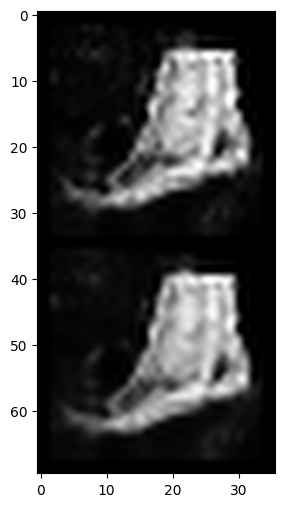

Iteration 900    Loss 0.0023614848032593727   PSNR_noisy: 10.115585583066338   PSRN_gt:10.157878737194334  PSNR_gt_sm: 10.274114379889042


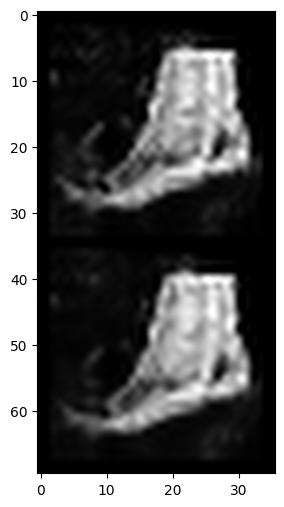

Iteration 1000    Loss 0.0025864052586257458   PSNR_noisy: 10.242196750001211   PSRN_gt:10.275506665834907  PSNR_gt_sm: 10.26127788007649


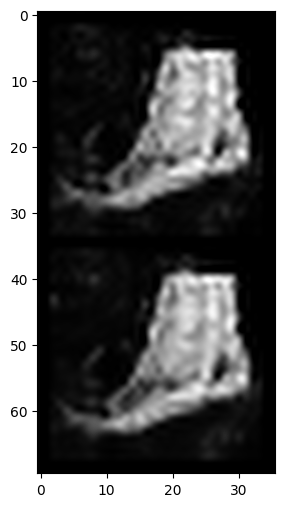

Iteration 1100    Loss 0.0021664327941834927   PSNR_noisy: 10.01999116503029   PSRN_gt:10.057899179608121  PSNR_gt_sm: 10.25093490816463


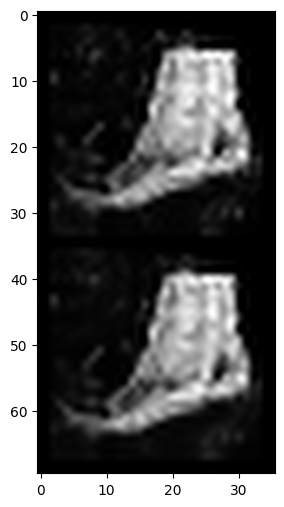

Iteration 1200    Loss 0.0019379170844331384   PSNR_noisy: 10.055017196690038   PSRN_gt:10.09432214731498  PSNR_gt_sm: 10.242230404143008


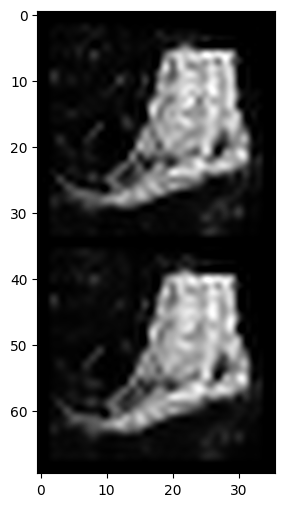

Iteration 1300    Loss 0.0017668753862380981   PSNR_noisy: 10.210196633915515   PSRN_gt:10.249915690175673  PSNR_gt_sm: 10.235334268994905


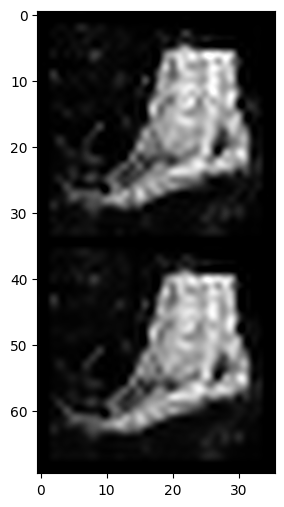

Iteration 1400    Loss 0.0016027693636715412   PSNR_noisy: 10.098448835941419   PSRN_gt:10.138957964013294  PSNR_gt_sm: 10.227604290689092


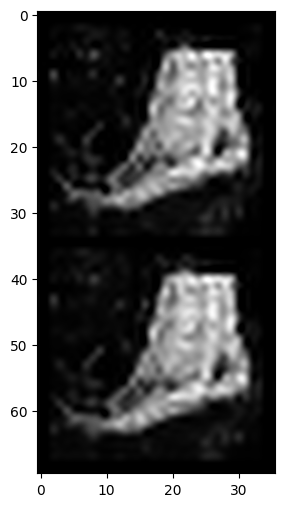

Iteration 1500    Loss 0.0013519730418920517   PSNR_noisy: 10.157103403420358   PSRN_gt:10.203393364400855  PSNR_gt_sm: 10.218577272862069


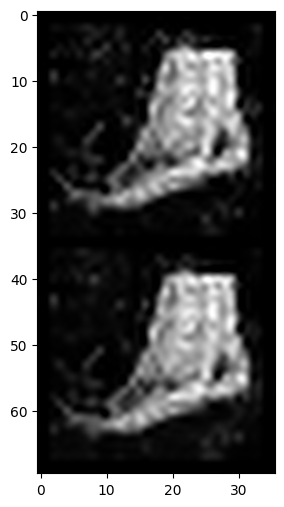

Iteration 1600    Loss 0.001316371839493513   PSNR_noisy: 10.200143032282686   PSRN_gt:10.24388688584278  PSNR_gt_sm: 10.207714448255867


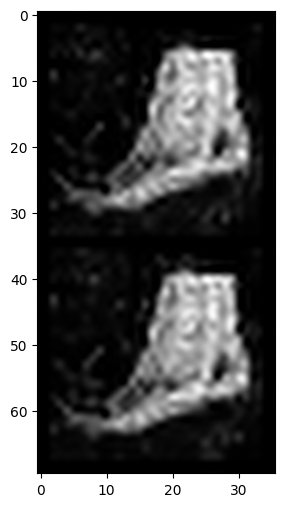

Iteration 1700    Loss 0.00129144755192101   PSNR_noisy: 10.01436089682793   PSRN_gt:10.055467136941417  PSNR_gt_sm: 10.200406027024991


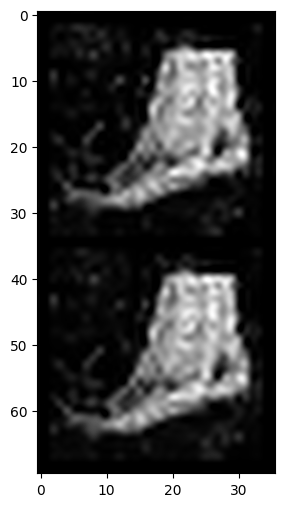

Iteration 1800    Loss 0.0010462157661095262   PSNR_noisy: 10.112799877871128   PSRN_gt:10.148830338903325  PSNR_gt_sm: 10.190798891573882


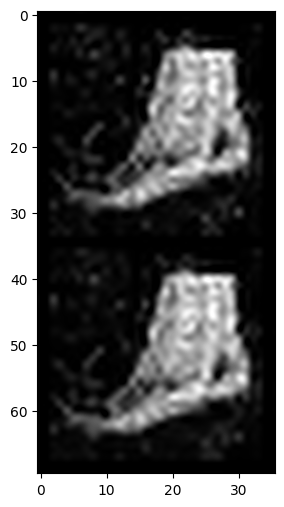

Iteration 1900    Loss 0.0008875557687133551   PSNR_noisy: 10.257225742619314   PSRN_gt:10.299477131967132  PSNR_gt_sm: 10.184248343936538


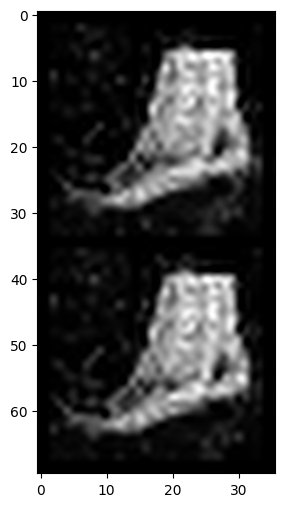

Iteration 2000    Loss 0.00128916185349226   PSNR_noisy: 10.077052993807587   PSRN_gt:10.117839482417246  PSNR_gt_sm: 10.176923700657518


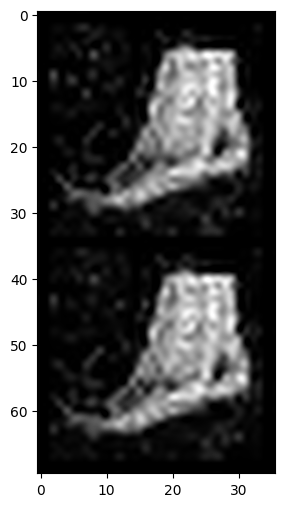

Iteration 2100    Loss 0.0009698081994429231   PSNR_noisy: 10.132343776538216   PSRN_gt:10.17450038200112  PSNR_gt_sm: 10.171725336646489


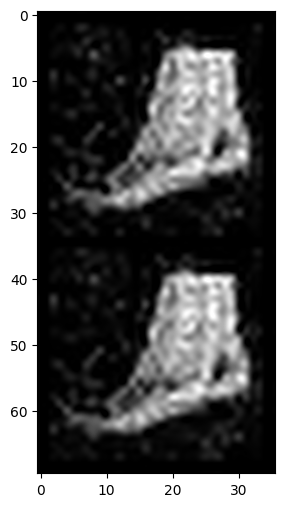

Iteration 2200    Loss 0.000755268381908536   PSNR_noisy: 9.982705713677852   PSRN_gt:10.015772057156232  PSNR_gt_sm: 10.16334624793727


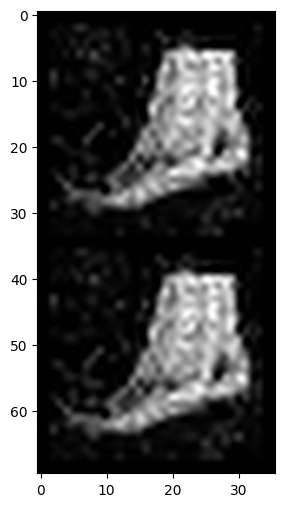

Iteration 2300    Loss 0.000624127103947103   PSNR_noisy: 10.059779081228243   PSRN_gt:10.103743724707785  PSNR_gt_sm: 10.162445624240748


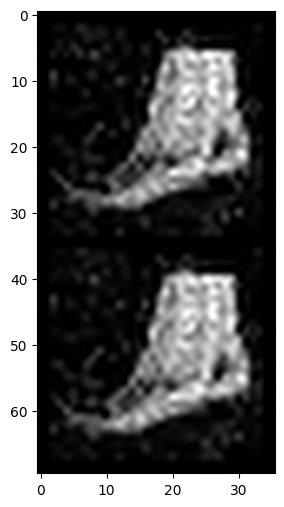

Iteration 2400    Loss 0.0006806810852140188   PSNR_noisy: 10.168734539267156   PSRN_gt:10.215611971275951  PSNR_gt_sm: 10.155639183872724


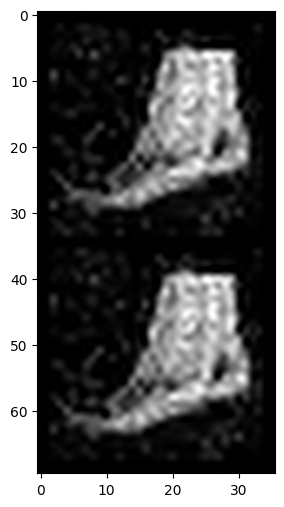

Iteration 2500    Loss 0.0007104576798155904   PSNR_noisy: 9.985416842694995   PSRN_gt:10.029631585649433  PSNR_gt_sm: 10.1523517877403


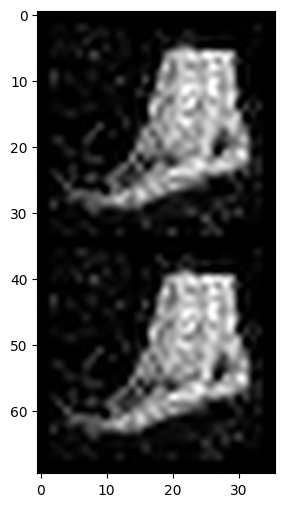

Iteration 2600    Loss 0.0006539887981489301   PSNR_noisy: 10.059635054697814   PSRN_gt:10.10577641421335  PSNR_gt_sm: 10.14951237278379


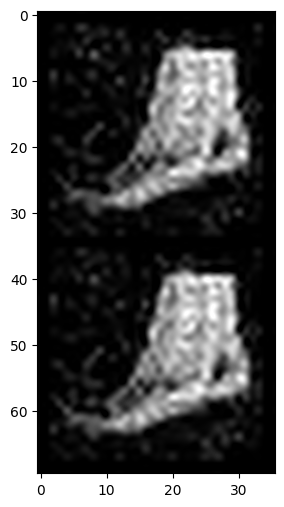

Iteration 2700    Loss 0.0006977524608373642   PSNR_noisy: 10.179333814250587   PSRN_gt:10.230830580595228  PSNR_gt_sm: 10.146939817767791


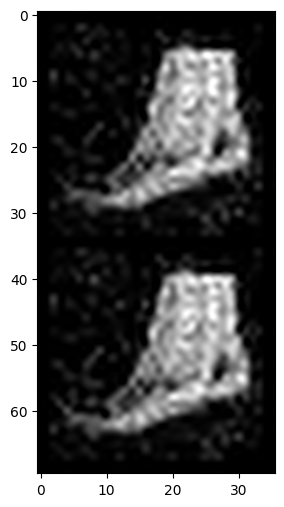

Iteration 2800    Loss 0.0004779710725415498   PSNR_noisy: 10.034646137494219   PSRN_gt:10.079023834521458  PSNR_gt_sm: 10.14458761189715


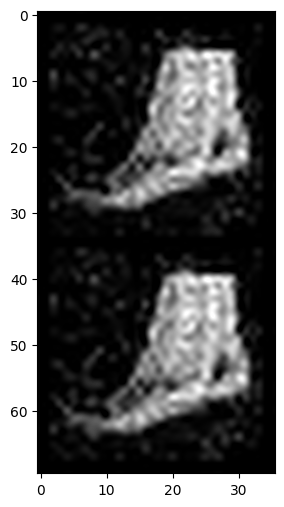

Iteration 2900    Loss 0.0005195195553824306   PSNR_noisy: 10.041573182911293   PSRN_gt:10.078572654896934  PSNR_gt_sm: 10.143538908776987
Starting optimization with ADAM


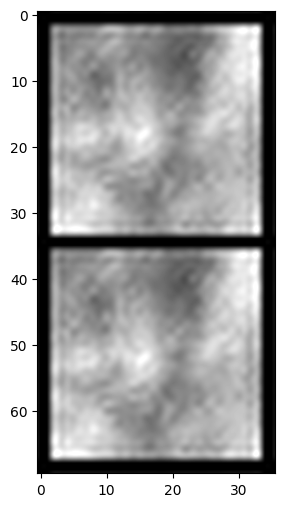

Iteration 0    Loss 0.13014854490756989   PSNR_noisy: 8.839188828499601   PSRN_gt:8.559944441541916  PSNR_gt_sm: 8.559944441541916


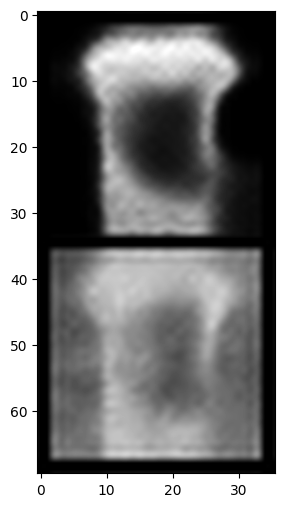

Iteration 100    Loss 0.010746066458523273   PSNR_noisy: 10.529710420076476   PSRN_gt:10.811389705863535  PSNR_gt_sm: 11.028510218463449


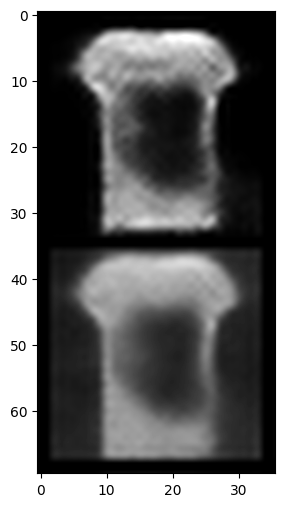

Iteration 200    Loss 0.006970216054469347   PSNR_noisy: 10.440405136986769   PSRN_gt:10.728705471531079  PSNR_gt_sm: 11.124493817546794


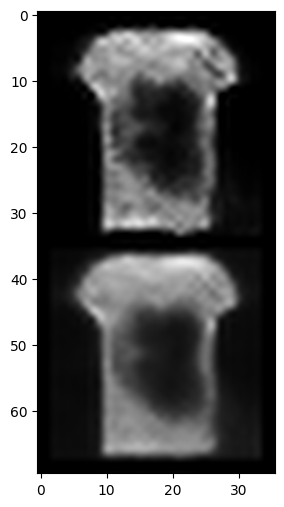

Iteration 300    Loss 0.006288706324994564   PSNR_noisy: 10.298595023703731   PSRN_gt:10.579782466576004  PSNR_gt_sm: 10.913544974760022


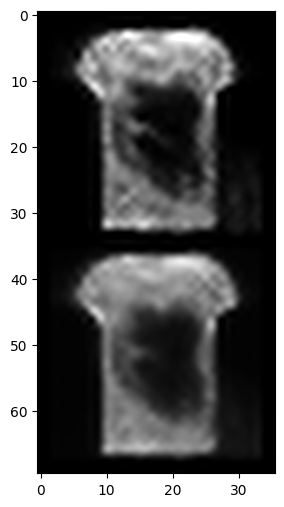

Iteration 400    Loss 0.005170747637748718   PSNR_noisy: 10.389672459835339   PSRN_gt:10.667404297744811  PSNR_gt_sm: 10.767562329851168


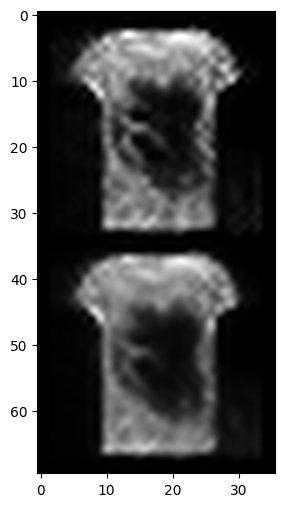

Iteration 500    Loss 0.004405205603688955   PSNR_noisy: 10.433785392031265   PSRN_gt:10.69559994991489  PSNR_gt_sm: 10.693061388006985


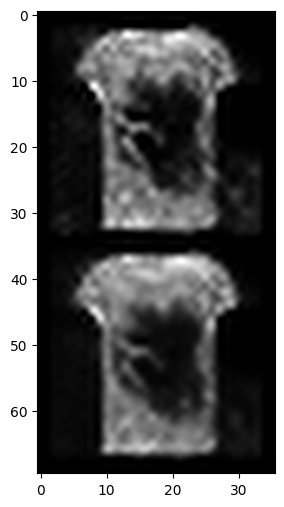

Iteration 600    Loss 0.0040100920014083385   PSNR_noisy: 10.314394952114386   PSRN_gt:10.556652116162876  PSNR_gt_sm: 10.643677515835543


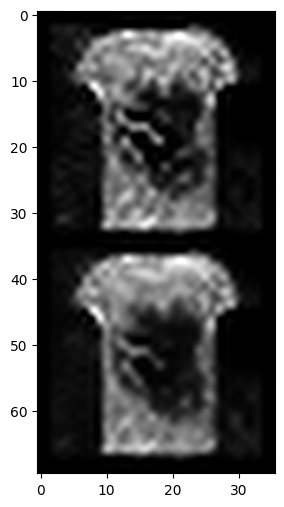

Iteration 700    Loss 0.003311749314889312   PSNR_noisy: 10.319491695918263   PSRN_gt:10.56185352570358  PSNR_gt_sm: 10.610007826472874


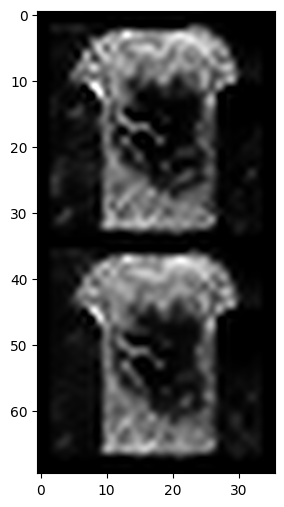

Iteration 800    Loss 0.0030170646496117115   PSNR_noisy: 10.16526513311135   PSRN_gt:10.380859378299647  PSNR_gt_sm: 10.570970908606778


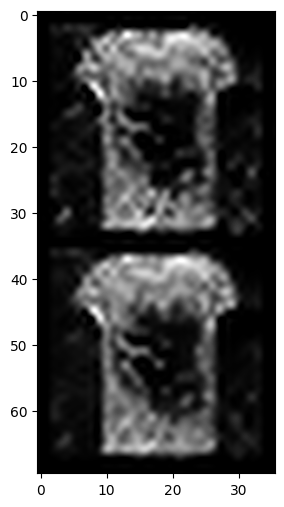

Iteration 900    Loss 0.0026893075555562973   PSNR_noisy: 10.180861571138236   PSRN_gt:10.406081233452955  PSNR_gt_sm: 10.54316723724515


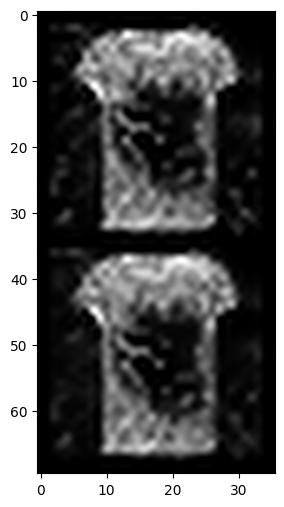

Iteration 1000    Loss 0.002011590637266636   PSNR_noisy: 10.184667208268925   PSRN_gt:10.398007961815035  PSNR_gt_sm: 10.521167941476861


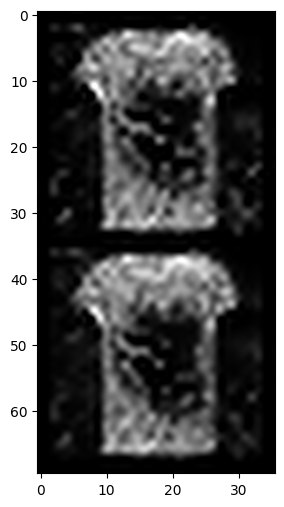

Iteration 1100    Loss 0.0022890670225024223   PSNR_noisy: 10.329349346440903   PSRN_gt:10.558867187921795  PSNR_gt_sm: 10.499735842021236


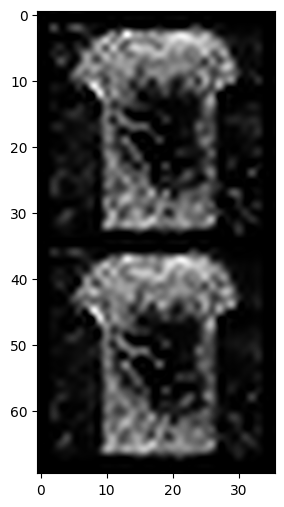

Iteration 1200    Loss 0.001825547544285655   PSNR_noisy: 10.145998434214345   PSRN_gt:10.357563837028415  PSNR_gt_sm: 10.477242481076821


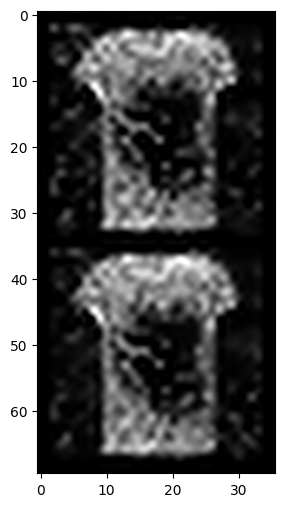

Iteration 1300    Loss 0.001458741375245154   PSNR_noisy: 10.084536582181853   PSRN_gt:10.30025773315013  PSNR_gt_sm: 10.46024037423534


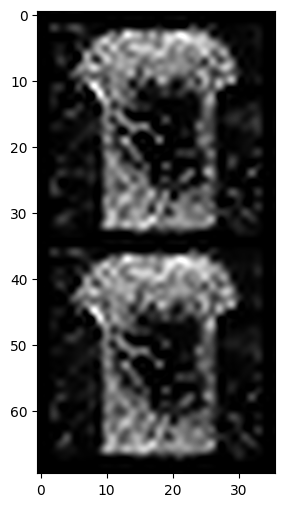

Iteration 1400    Loss 0.0011560696875676513   PSNR_noisy: 10.110077075641426   PSRN_gt:10.327305943266428  PSNR_gt_sm: 10.439974942497518


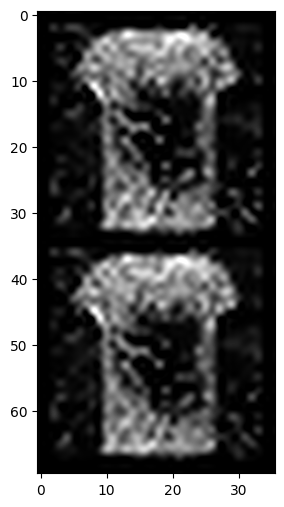

Iteration 1500    Loss 0.0010680798441171646   PSNR_noisy: 10.118956172933416   PSRN_gt:10.332758503850236  PSNR_gt_sm: 10.42533889431185


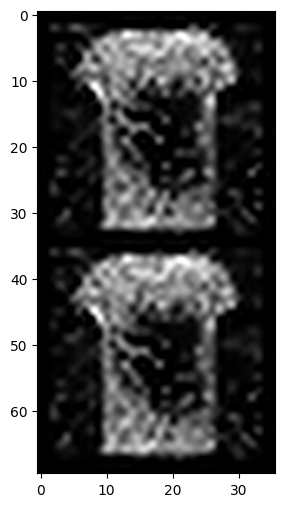

Iteration 1600    Loss 0.0009010374778881669   PSNR_noisy: 10.185644023570926   PSRN_gt:10.401691358569272  PSNR_gt_sm: 10.416312180920412


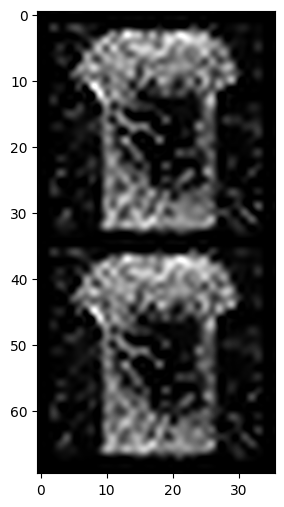

Iteration 1700    Loss 0.0008102530846372247   PSNR_noisy: 10.176303234794862   PSRN_gt:10.392151828763012  PSNR_gt_sm: 10.406089826757821


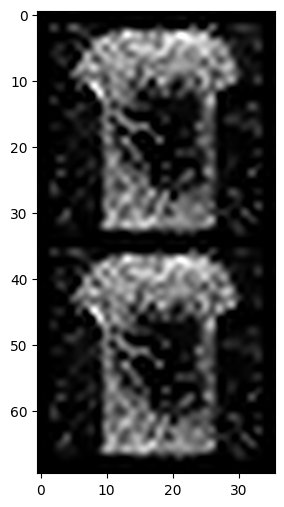

Iteration 1800    Loss 0.0007834234274923801   PSNR_noisy: 10.153418805720221   PSRN_gt:10.35778576345451  PSNR_gt_sm: 10.395542986190796


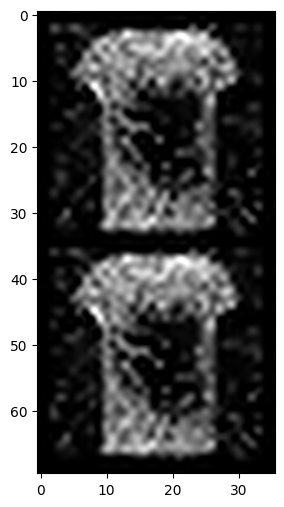

Iteration 1900    Loss 0.0007971347076818347   PSNR_noisy: 10.077990883059528   PSRN_gt:10.29436524916659  PSNR_gt_sm: 10.385106574041309


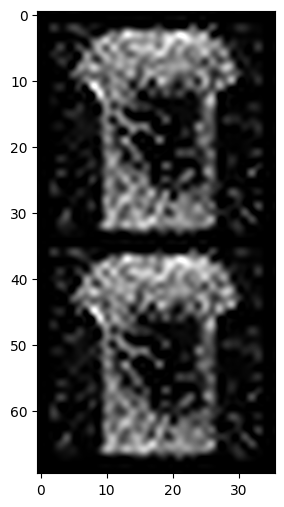

Iteration 2000    Loss 0.0006103962659835815   PSNR_noisy: 10.172546697500504   PSRN_gt:10.39009008306378  PSNR_gt_sm: 10.379758976426226


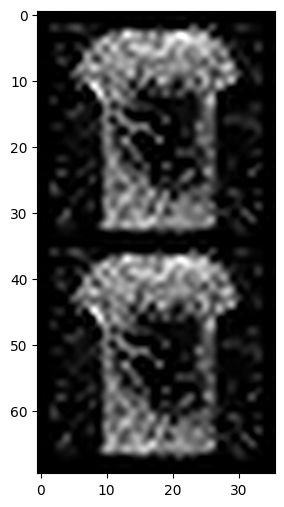

Iteration 2100    Loss 0.0005113125080242753   PSNR_noisy: 10.218601296627952   PSRN_gt:10.44056889162189  PSNR_gt_sm: 10.37425619969885


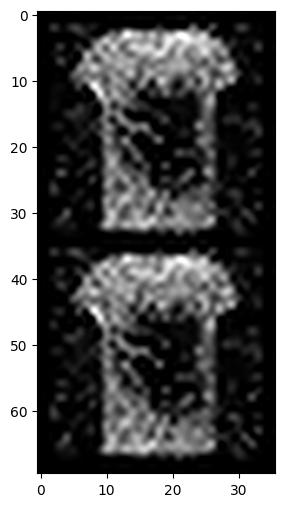

Iteration 2200    Loss 0.0005636028945446014   PSNR_noisy: 10.21622558680428   PSRN_gt:10.434770477259088  PSNR_gt_sm: 10.367543236836978


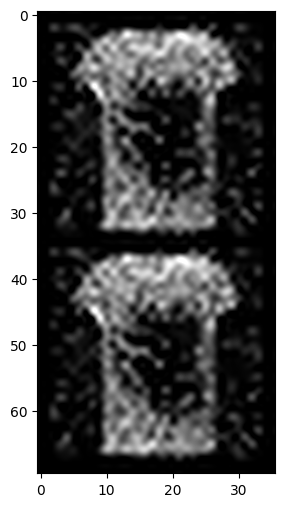

Iteration 2300    Loss 0.00032867799745872617   PSNR_noisy: 10.128621201140431   PSRN_gt:10.331618806072715  PSNR_gt_sm: 10.360673519140583


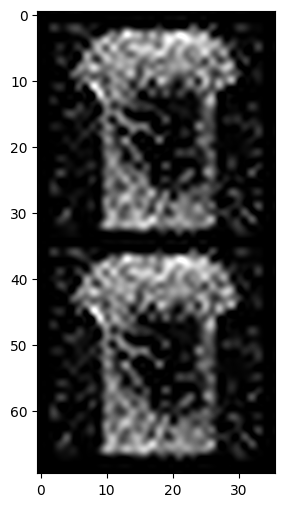

Iteration 2400    Loss 0.00034361809957772493   PSNR_noisy: 10.124495900303792   PSRN_gt:10.343471487691474  PSNR_gt_sm: 10.357493592367213


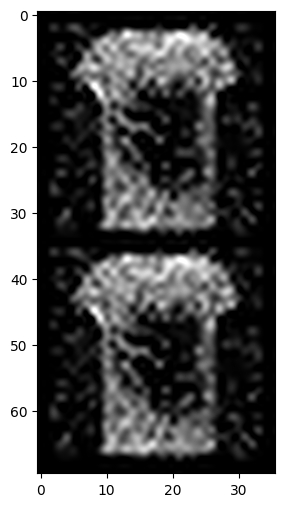

Iteration 2500    Loss 0.00027611799305304885   PSNR_noisy: 10.13732816152322   PSRN_gt:10.352982877690488  PSNR_gt_sm: 10.354604002470047


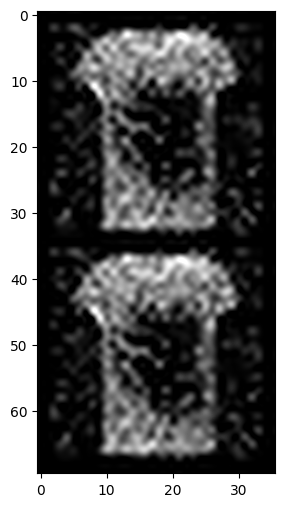

Iteration 2600    Loss 0.00033559129224158823   PSNR_noisy: 10.12249710754986   PSRN_gt:10.331652680263517  PSNR_gt_sm: 10.349892384197153


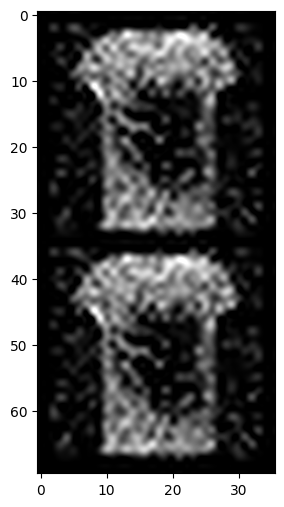

Iteration 2700    Loss 0.0003077691071666777   PSNR_noisy: 10.146392831808642   PSRN_gt:10.359351542322628  PSNR_gt_sm: 10.349007458861784


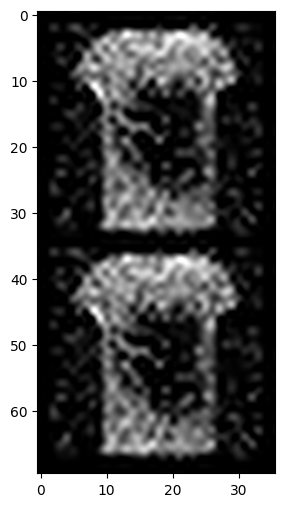

Iteration 2800    Loss 0.0003227384586352855   PSNR_noisy: 10.199125244550668   PSRN_gt:10.412398536372194  PSNR_gt_sm: 10.346303844202762


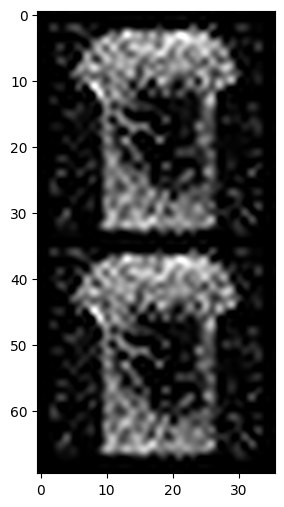

Iteration 2900    Loss 0.0002673952840268612   PSNR_noisy: 10.157354281739758   PSRN_gt:10.374725182011108  PSNR_gt_sm: 10.342337378167024
Starting optimization with ADAM


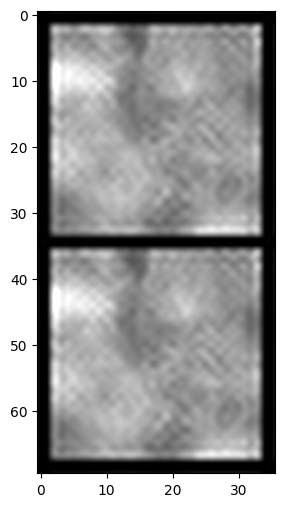

Iteration 0    Loss 0.15031073987483978   PSNR_noisy: 5.909647846414625   PSRN_gt:5.386858078429249  PSNR_gt_sm: 5.386858078429249


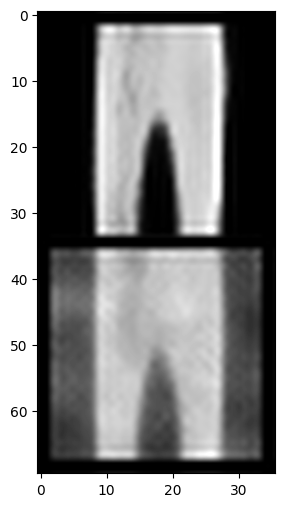

Iteration 100    Loss 0.019303835928440094   PSNR_noisy: 8.203348398479275   PSRN_gt:7.719850175255529  PSNR_gt_sm: 7.456339669227914


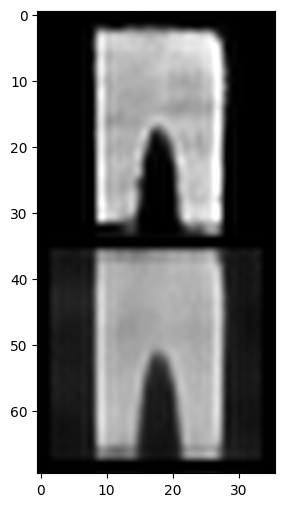

Iteration 200    Loss 0.008588626980781555   PSNR_noisy: 7.589767786973662   PSRN_gt:7.162914231224745  PSNR_gt_sm: 7.661447078186965


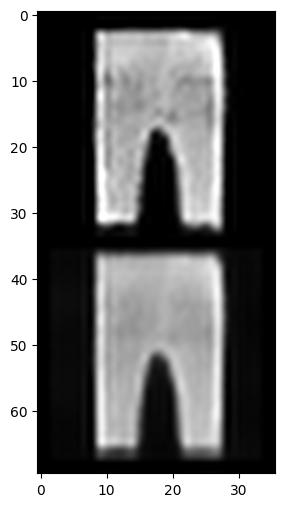

Iteration 300    Loss 0.005979286506772041   PSNR_noisy: 7.727457209043265   PSRN_gt:7.297367074488342  PSNR_gt_sm: 7.510777771965379


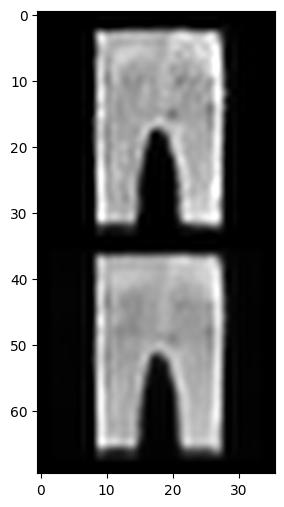

Iteration 400    Loss 0.005586659535765648   PSNR_noisy: 7.649238559520432   PSRN_gt:7.220516020890859  PSNR_gt_sm: 7.39521298475625


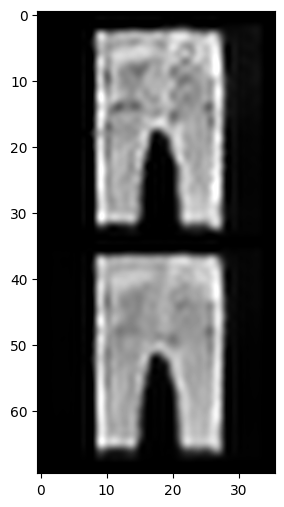

Iteration 500    Loss 0.00458076735958457   PSNR_noisy: 7.595115783168312   PSRN_gt:7.158871942938751  PSNR_gt_sm: 7.337733937990196


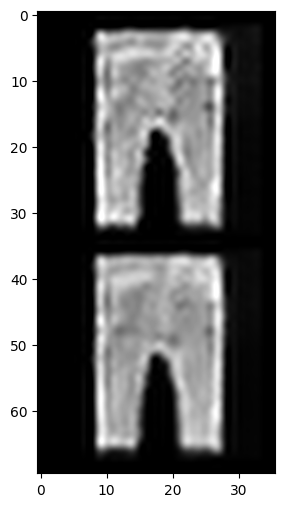

Iteration 600    Loss 0.004295302554965019   PSNR_noisy: 7.637254192122293   PSRN_gt:7.204099068192933  PSNR_gt_sm: 7.30509092935314


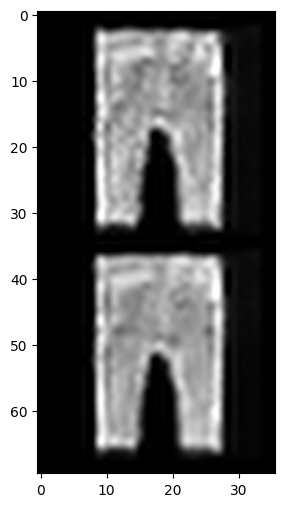

Iteration 700    Loss 0.0040410105139017105   PSNR_noisy: 7.667241482968576   PSRN_gt:7.228698092256776  PSNR_gt_sm: 7.285422474604346


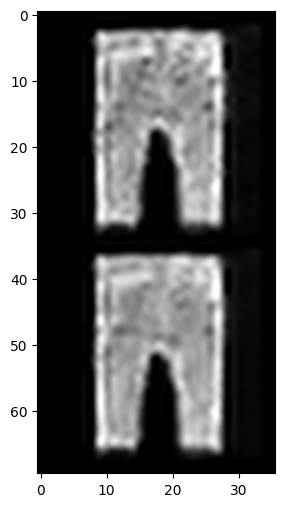

Iteration 800    Loss 0.003602072596549988   PSNR_noisy: 7.78119567697183   PSRN_gt:7.339655761559244  PSNR_gt_sm: 7.273717164449632


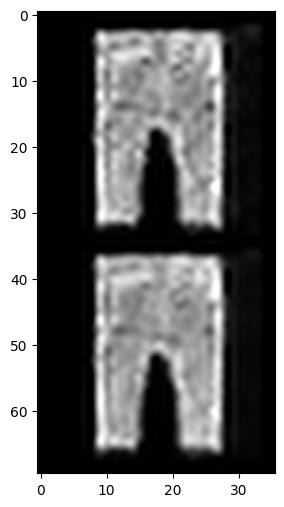

Iteration 900    Loss 0.003133363788947463   PSNR_noisy: 7.758196949666045   PSRN_gt:7.320040449284326  PSNR_gt_sm: 7.265257358451926


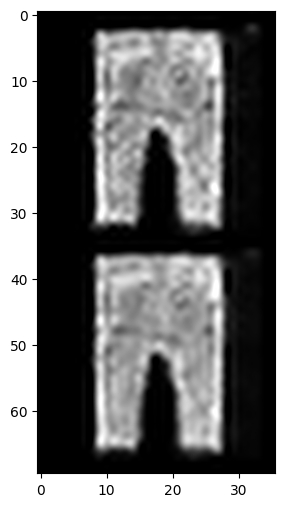

Iteration 1000    Loss 0.0029640421271324158   PSNR_noisy: 7.693936309878713   PSRN_gt:7.264402676027441  PSNR_gt_sm: 7.258579389206352


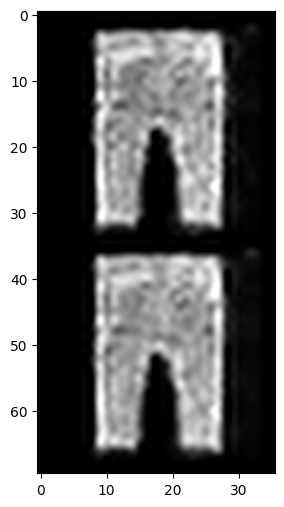

Iteration 1100    Loss 0.0027417747769504786   PSNR_noisy: 7.619394925121702   PSRN_gt:7.19345081346538  PSNR_gt_sm: 7.250938861013653


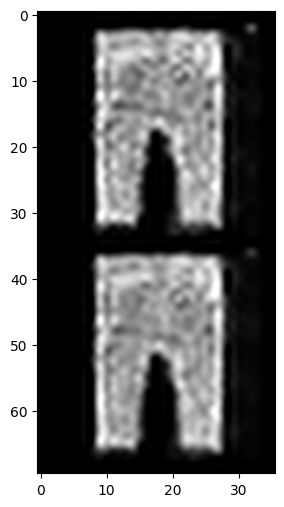

Iteration 1200    Loss 0.0021664982195943594   PSNR_noisy: 7.609373551554493   PSRN_gt:7.174147557913276  PSNR_gt_sm: 7.243187576813808


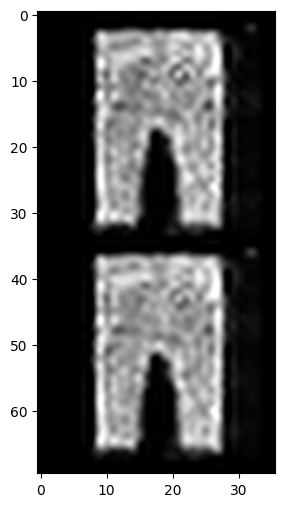

Iteration 1300    Loss 0.0023478898219764233   PSNR_noisy: 7.79352274621628   PSRN_gt:7.354133687990233  PSNR_gt_sm: 7.237758347279852


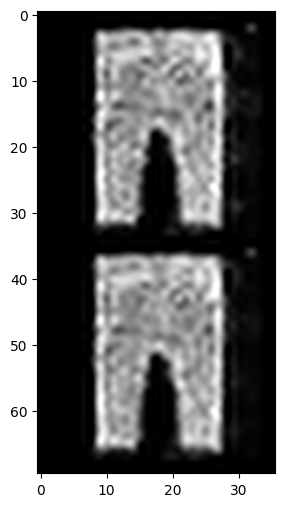

Iteration 1400    Loss 0.0019078144105151296   PSNR_noisy: 7.5437127298061295   PSRN_gt:7.111293480784794  PSNR_gt_sm: 7.230946454146247


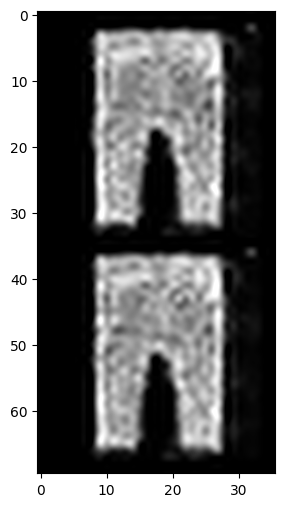

Iteration 1500    Loss 0.002251644851639867   PSNR_noisy: 7.634650605769267   PSRN_gt:7.200014720335595  PSNR_gt_sm: 7.2254241475960495


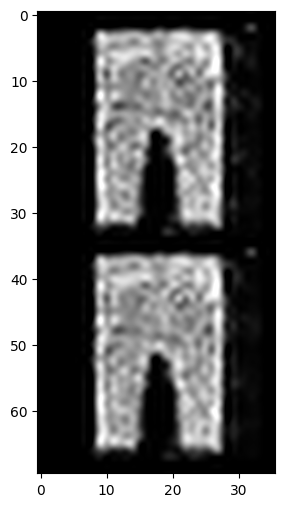

Iteration 1600    Loss 0.0016146493144333363   PSNR_noisy: 7.66158153721687   PSRN_gt:7.226042181441709  PSNR_gt_sm: 7.220343148465091


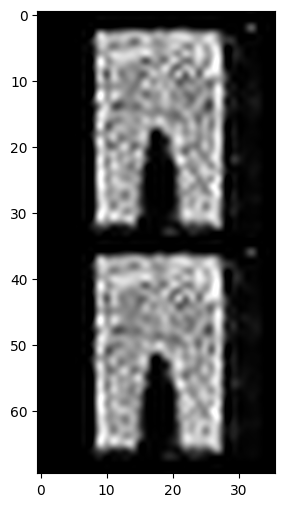

Iteration 1700    Loss 0.0015475965337827802   PSNR_noisy: 7.65516254828694   PSRN_gt:7.222207157885099  PSNR_gt_sm: 7.21606597574606


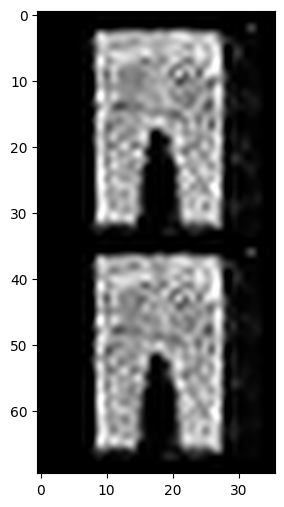

Iteration 1800    Loss 0.0017797290347516537   PSNR_noisy: 7.534607817541801   PSRN_gt:7.103037187951541  PSNR_gt_sm: 7.212536635789516


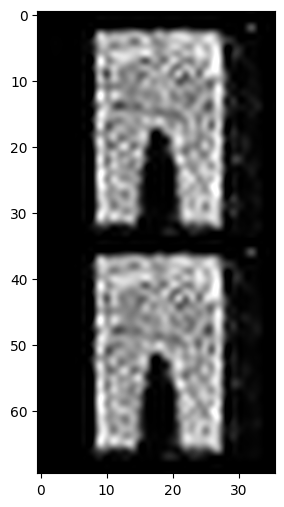

Iteration 1900    Loss 0.0013249210314825177   PSNR_noisy: 7.61050934290571   PSRN_gt:7.181015389510672  PSNR_gt_sm: 7.210057590695666


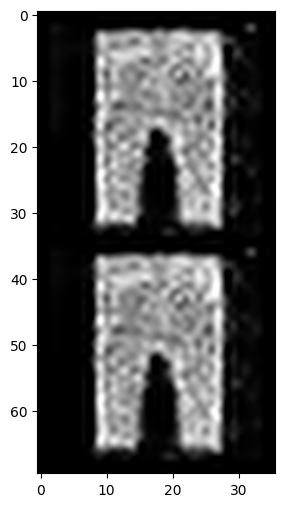

Iteration 2000    Loss 0.001179644139483571   PSNR_noisy: 7.647050539116616   PSRN_gt:7.208476172660547  PSNR_gt_sm: 7.208326218938314


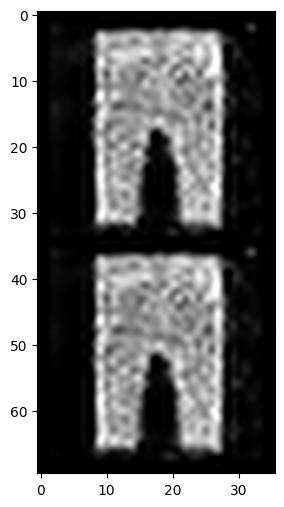

Iteration 2100    Loss 0.0011552325449883938   PSNR_noisy: 7.493790374286813   PSRN_gt:7.060315831908646  PSNR_gt_sm: 7.206517475402179


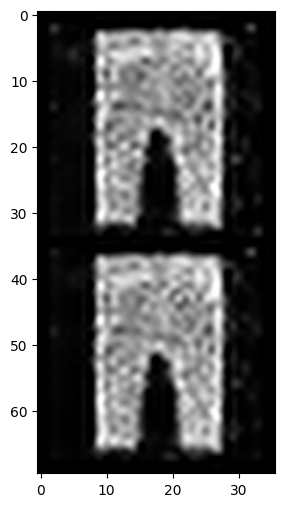

Iteration 2200    Loss 0.00110554916318506   PSNR_noisy: 7.699848936967713   PSRN_gt:7.255013804541805  PSNR_gt_sm: 7.2026725122322315


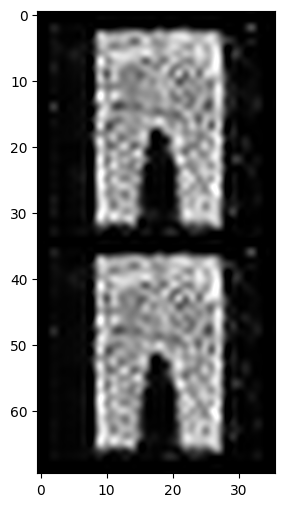

Iteration 2300    Loss 0.0008305415976792574   PSNR_noisy: 7.581003048723975   PSRN_gt:7.140654505259222  PSNR_gt_sm: 7.19955039526316


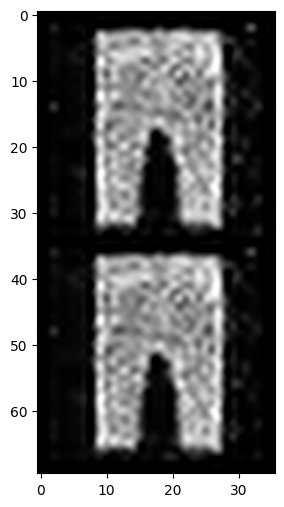

Iteration 2400    Loss 0.000820268876850605   PSNR_noisy: 7.503045378665359   PSRN_gt:7.063909754014052  PSNR_gt_sm: 7.195223075447567


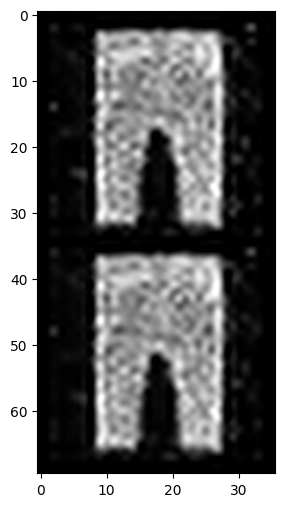

Iteration 2500    Loss 0.0006260592490434647   PSNR_noisy: 7.568454953334701   PSRN_gt:7.12880096324761  PSNR_gt_sm: 7.192572959773024


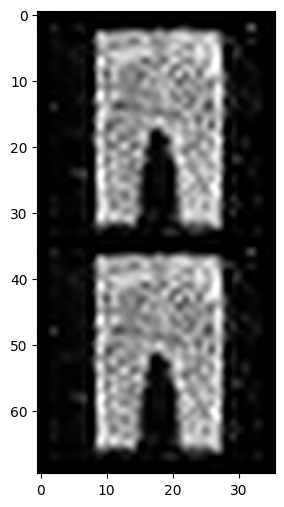

Iteration 2600    Loss 0.000690102984663099   PSNR_noisy: 7.5017148378596925   PSRN_gt:7.063519399955391  PSNR_gt_sm: 7.1899269404026


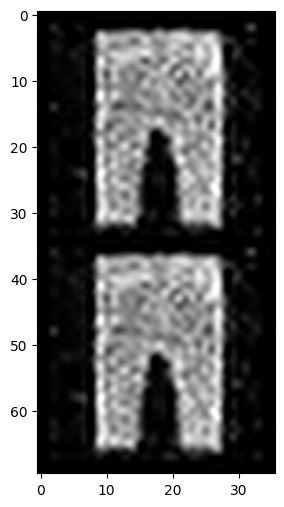

Iteration 2700    Loss 0.0004346403293311596   PSNR_noisy: 7.59961886554713   PSRN_gt:7.159978999500436  PSNR_gt_sm: 7.186812258576742


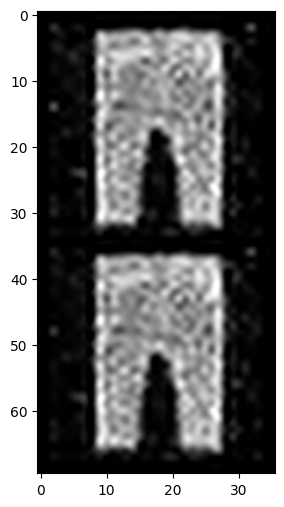

Iteration 2800    Loss 0.0004897750914096832   PSNR_noisy: 7.552216556888675   PSRN_gt:7.109501019111114  PSNR_gt_sm: 7.18556382081167


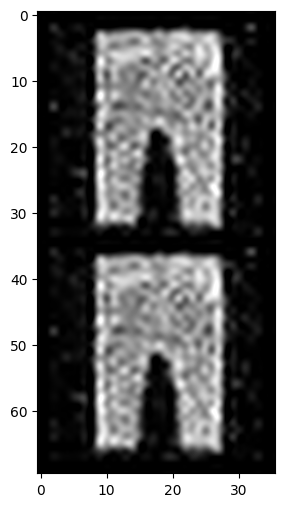

Iteration 2900    Loss 0.00039671367267146707   PSNR_noisy: 7.636578324994621   PSRN_gt:7.194452554715757  PSNR_gt_sm: 7.183581729954929
Starting optimization with ADAM


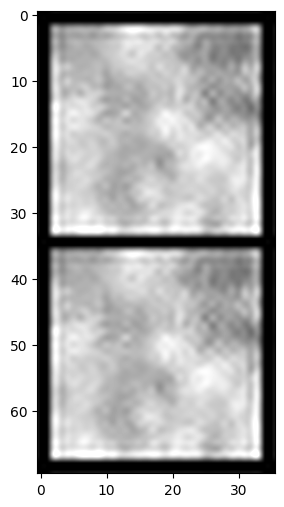

Iteration 0    Loss 0.2938106060028076   PSNR_noisy: 5.297021099563337   PSRN_gt:4.7618843369700805  PSNR_gt_sm: 4.7618843369700805


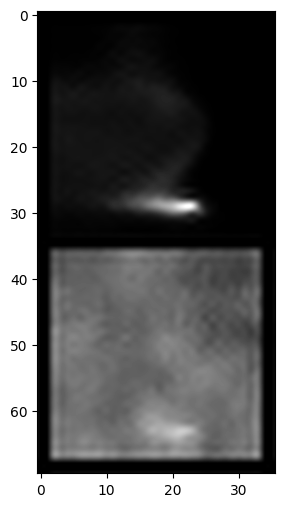

Iteration 100    Loss 0.004108640365302563   PSNR_noisy: 20.147587635251945   PSRN_gt:22.23705163156826  PSNR_gt_sm: 12.499446955501789


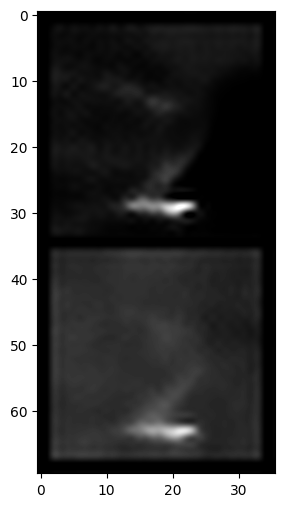

Iteration 200    Loss 0.0033047515898942947   PSNR_noisy: 20.431575505323266   PSRN_gt:22.256267380837112  PSNR_gt_sm: 18.281227394036158


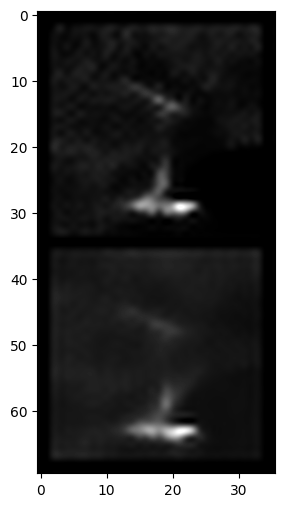

Iteration 300    Loss 0.0030908104963600636   PSNR_noisy: 20.407370795922823   PSRN_gt:21.96586998007584  PSNR_gt_sm: 20.845111953996906


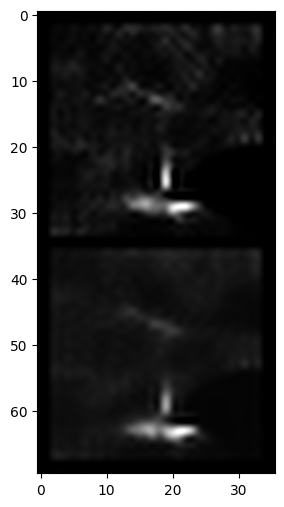

Iteration 400    Loss 0.0024750754237174988   PSNR_noisy: 20.042636293369547   PSRN_gt:21.507594411890235  PSNR_gt_sm: 21.497341437167073


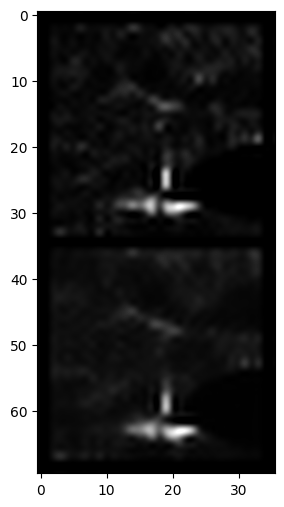

Iteration 500    Loss 0.002158068586140871   PSNR_noisy: 19.907152343588447   PSRN_gt:21.510025688043992  PSNR_gt_sm: 21.570933817507182


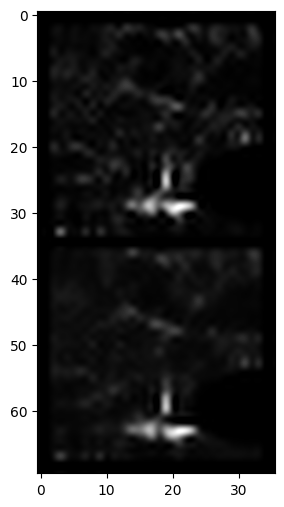

Iteration 600    Loss 0.0018185848603025079   PSNR_noisy: 19.717522802915248   PSRN_gt:21.170108501078104  PSNR_gt_sm: 21.533014154532278


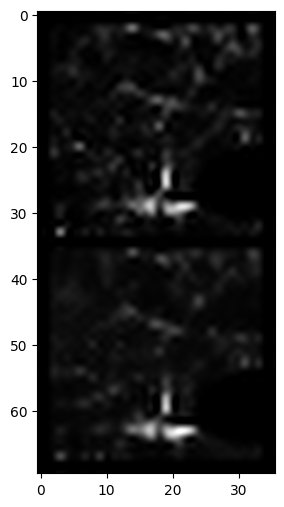

Iteration 700    Loss 0.0017105450388044119   PSNR_noisy: 19.846374632447393   PSRN_gt:21.242949021574393  PSNR_gt_sm: 21.426127853126495


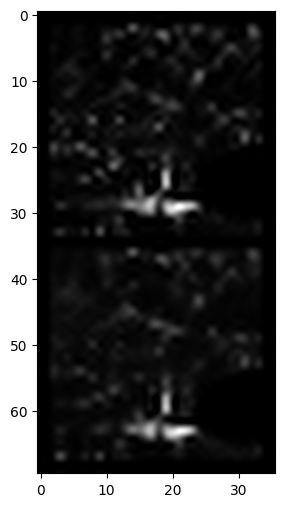

Iteration 800    Loss 0.0014373308513313532   PSNR_noisy: 19.54305083479586   PSRN_gt:20.843841006207423  PSNR_gt_sm: 21.31066167610004


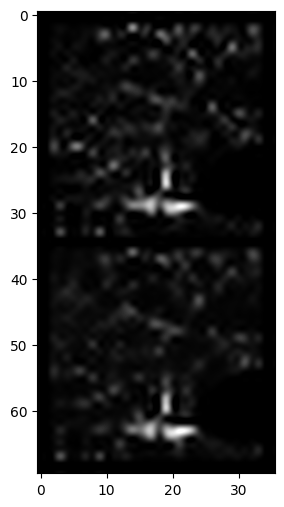

Iteration 900    Loss 0.0014174528187140822   PSNR_noisy: 19.692764926822758   PSRN_gt:20.9407955251097  PSNR_gt_sm: 21.193722179800577


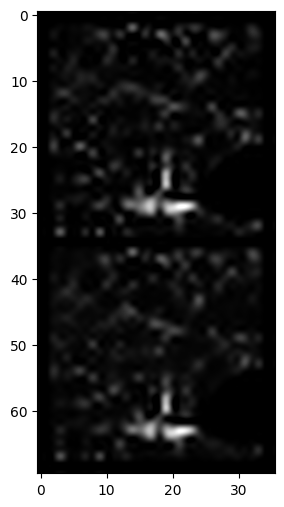

Iteration 1000    Loss 0.0011134627275168896   PSNR_noisy: 19.512749423505387   PSRN_gt:20.8149515054185  PSNR_gt_sm: 21.093643041141878


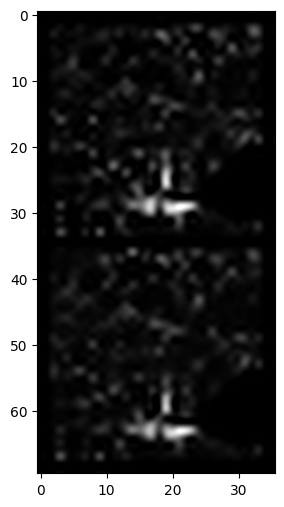

Iteration 1100    Loss 0.0011292464332655072   PSNR_noisy: 19.359493751821656   PSRN_gt:20.48676688211664  PSNR_gt_sm: 21.030022001540395


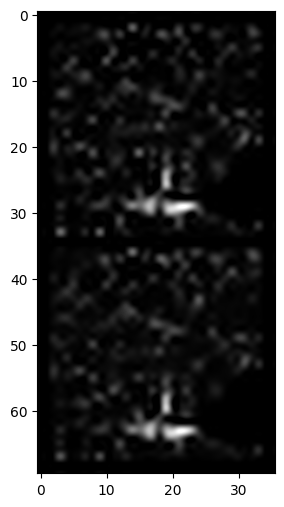

Iteration 1200    Loss 0.0008765977108851075   PSNR_noisy: 19.414246413086957   PSRN_gt:20.688375984505612  PSNR_gt_sm: 20.942127041668947


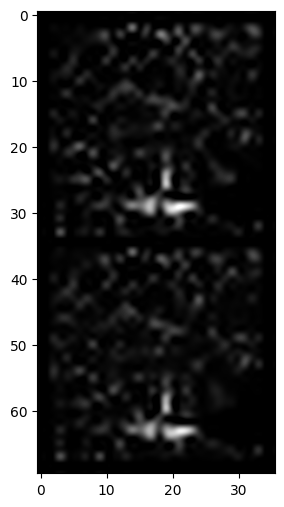

Iteration 1300    Loss 0.0007655775989405811   PSNR_noisy: 19.31113571889967   PSRN_gt:20.469515447395644  PSNR_gt_sm: 20.867248770557502


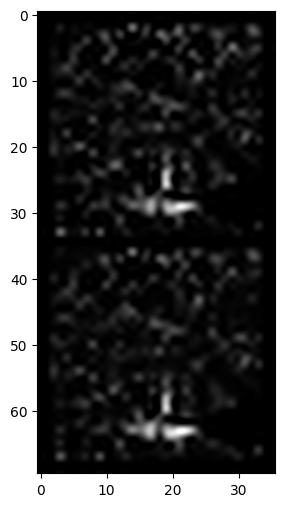

Iteration 1400    Loss 0.0006757695227861404   PSNR_noisy: 19.598999638593696   PSRN_gt:20.79372253121527  PSNR_gt_sm: 20.806297592155175


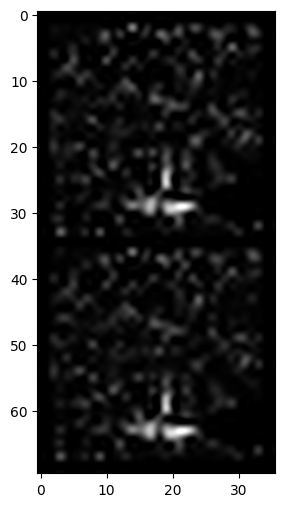

Iteration 1500    Loss 0.0006249749567359686   PSNR_noisy: 19.444635712596995   PSRN_gt:20.573841582736826  PSNR_gt_sm: 20.73759336925618


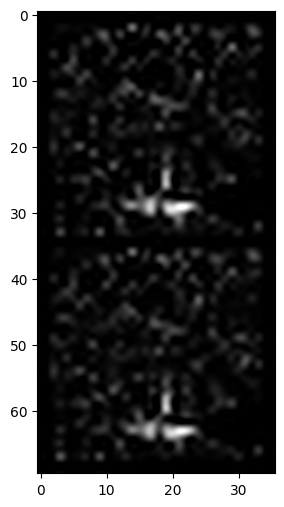

Iteration 1600    Loss 0.0005756107275374234   PSNR_noisy: 19.192907197719165   PSRN_gt:20.39681531982589  PSNR_gt_sm: 20.67933660326219


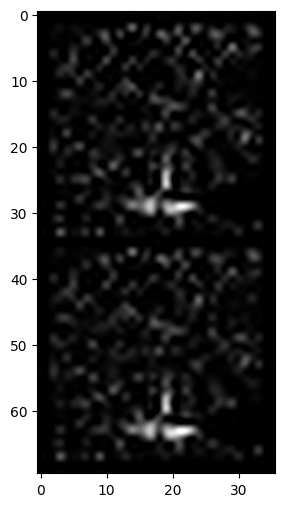

Iteration 1700    Loss 0.0004464876255951822   PSNR_noisy: 19.402370780137833   PSRN_gt:20.556414141840342  PSNR_gt_sm: 20.624683609920243


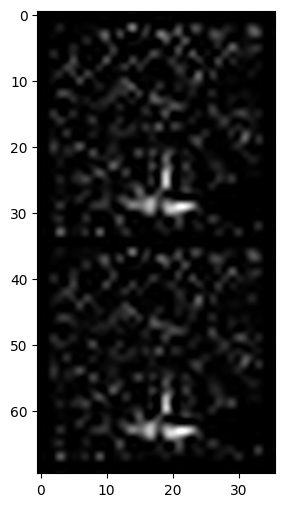

Iteration 1800    Loss 0.0004183788551017642   PSNR_noisy: 19.31429299045928   PSRN_gt:20.374798943628505  PSNR_gt_sm: 20.58632238669478


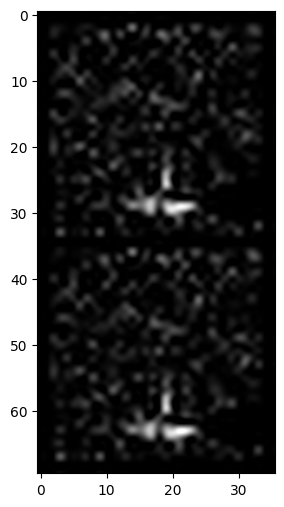

Iteration 1900    Loss 0.00036552781239151955   PSNR_noisy: 19.33896061098838   PSRN_gt:20.50015491466158  PSNR_gt_sm: 20.54656878174105


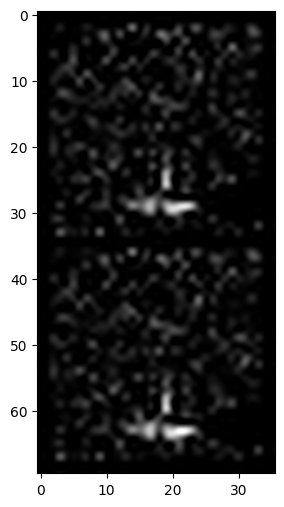

Iteration 2000    Loss 0.00038504094118252397   PSNR_noisy: 19.49904581346738   PSRN_gt:20.721412048757706  PSNR_gt_sm: 20.516536670094027


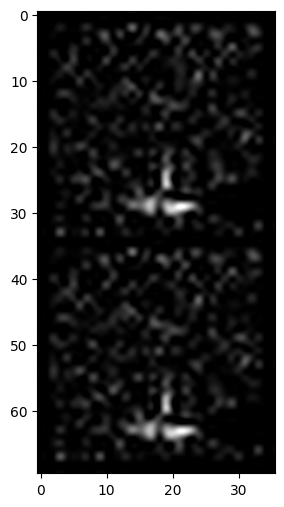

Iteration 2100    Loss 0.00029035221086815   PSNR_noisy: 19.257225354370483   PSRN_gt:20.403715148240046  PSNR_gt_sm: 20.48132398525713


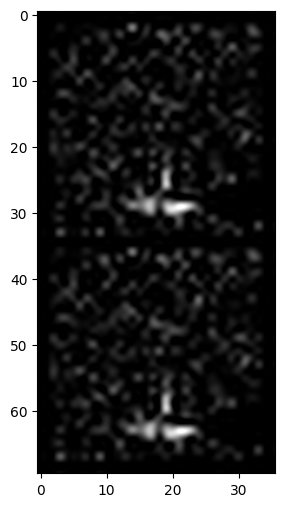

Iteration 2200    Loss 0.0002772564475890249   PSNR_noisy: 19.249385687243233   PSRN_gt:20.456743384032038  PSNR_gt_sm: 20.463786980932195


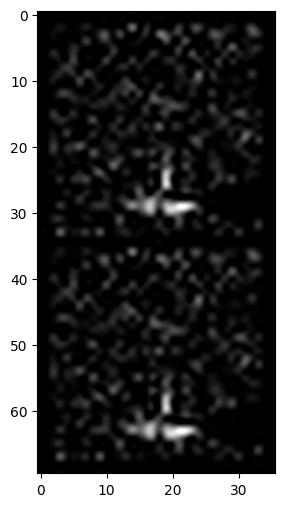

Iteration 2300    Loss 0.00021797430235892534   PSNR_noisy: 19.227186420527588   PSRN_gt:20.333597873468214  PSNR_gt_sm: 20.437038787696984


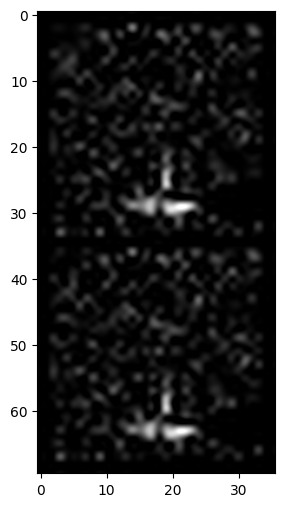

Iteration 2400    Loss 0.00026562297716736794   PSNR_noisy: 19.12201920227903   PSRN_gt:20.216553727956246  PSNR_gt_sm: 20.423666572280787


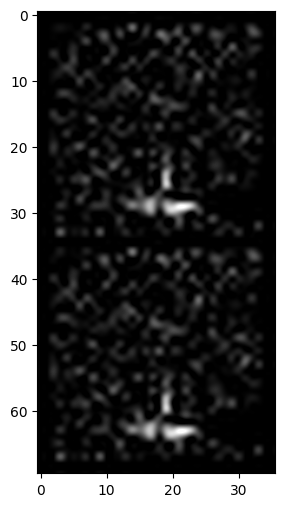

Iteration 2500    Loss 0.0002008486189879477   PSNR_noisy: 19.32125799484505   PSRN_gt:20.499429525579977  PSNR_gt_sm: 20.417154943853227


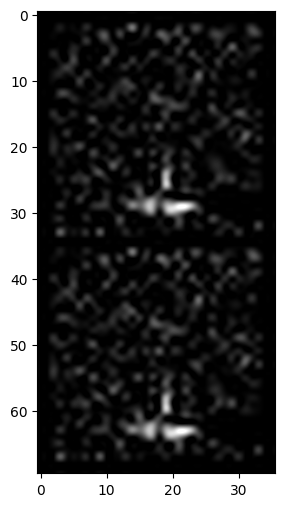

Iteration 2600    Loss 0.00019107158004771918   PSNR_noisy: 19.302265409045397   PSRN_gt:20.542483508748223  PSNR_gt_sm: 20.39847242775948


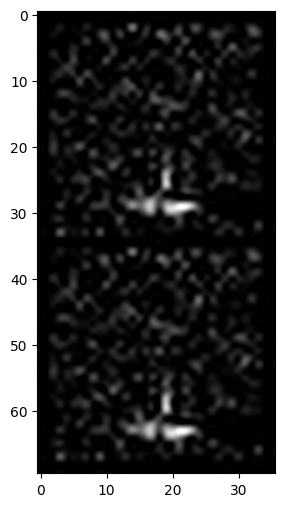

Iteration 2700    Loss 0.00014834271860308945   PSNR_noisy: 19.23483036327768   PSRN_gt:20.364876773244077  PSNR_gt_sm: 20.390246658411737


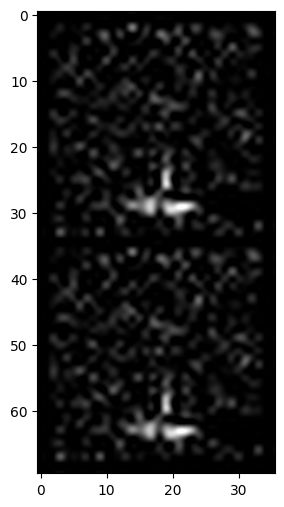

Iteration 2800    Loss 0.00015438097761943936   PSNR_noisy: 19.13503102364192   PSRN_gt:20.22309827120196  PSNR_gt_sm: 20.372093811875573


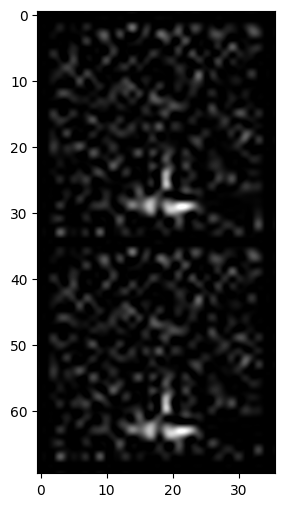

Iteration 2900    Loss 0.00014901682152412832   PSNR_noisy: 19.2407473478221   PSRN_gt:20.359764002002542  PSNR_gt_sm: 20.36824343757629
Starting optimization with ADAM


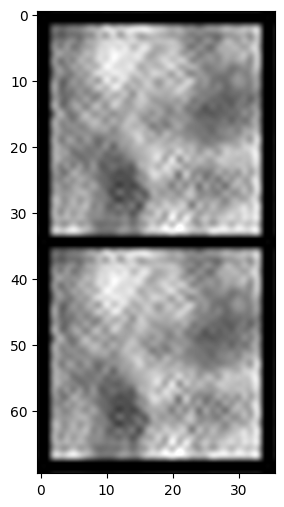

Iteration 0    Loss 0.19744127988815308   PSNR_noisy: 7.840273891503818   PSRN_gt:7.539797394543947  PSNR_gt_sm: 7.539797394543947


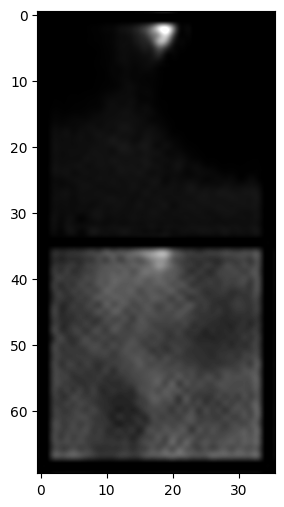

Iteration 100    Loss 0.004836986307054758   PSNR_noisy: 6.2364225222403675   PSRN_gt:6.379884594915609  PSNR_gt_sm: 7.890062366650536


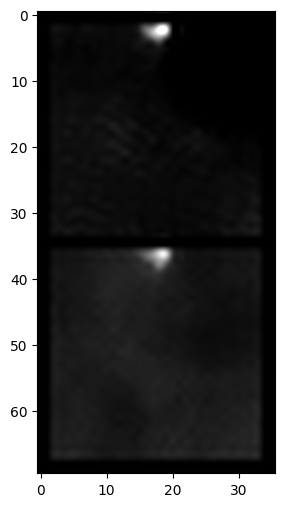

Iteration 200    Loss 0.003956331871449947   PSNR_noisy: 6.22817900202401   PSRN_gt:6.366817258079845  PSNR_gt_sm: 6.988836762226438


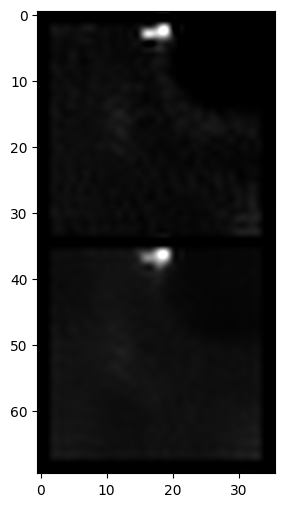

Iteration 300    Loss 0.0034616996999830008   PSNR_noisy: 6.3097026988155775   PSRN_gt:6.44944124097393  PSNR_gt_sm: 6.625221658516493


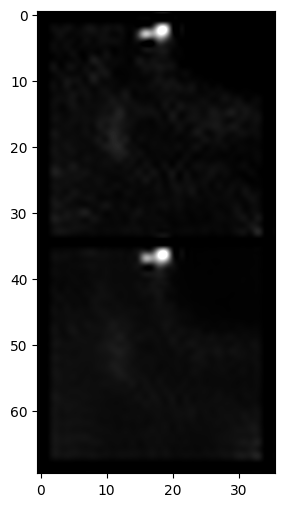

Iteration 400    Loss 0.003214586526155472   PSNR_noisy: 6.317838065381107   PSRN_gt:6.459513929709369  PSNR_gt_sm: 6.505791034550542


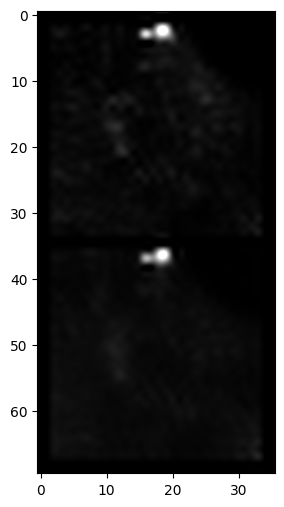

Iteration 500    Loss 0.0029441819060593843   PSNR_noisy: 6.338023550257569   PSRN_gt:6.482927199311755  PSNR_gt_sm: 6.486156341690174


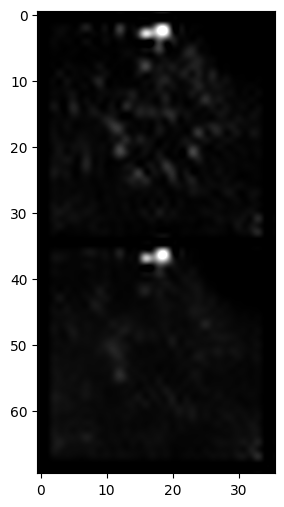

Iteration 600    Loss 0.002725131344050169   PSNR_noisy: 6.362529871693241   PSRN_gt:6.505278400170625  PSNR_gt_sm: 6.480649452775866


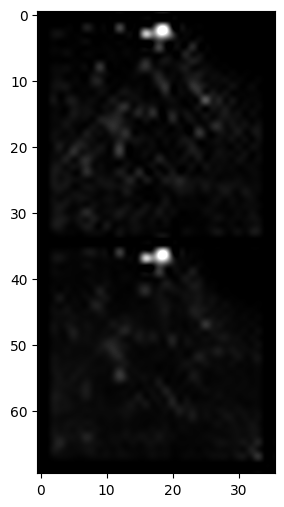

Iteration 700    Loss 0.002342053921893239   PSNR_noisy: 6.357229190696476   PSRN_gt:6.499798173957235  PSNR_gt_sm: 6.471210579753986


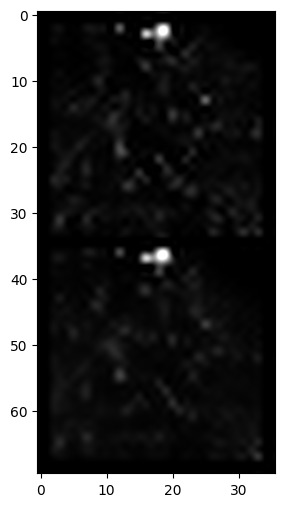

Iteration 800    Loss 0.0021400442346930504   PSNR_noisy: 6.31170352706441   PSRN_gt:6.448337348233661  PSNR_gt_sm: 6.466971330398593


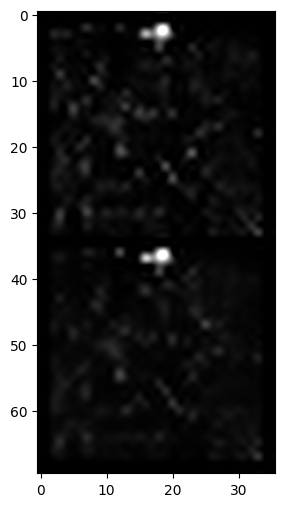

Iteration 900    Loss 0.0018580862088128924   PSNR_noisy: 6.336462378688862   PSRN_gt:6.466772376181246  PSNR_gt_sm: 6.471480360013151


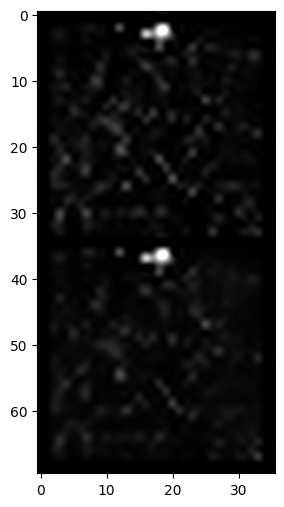

Iteration 1000    Loss 0.001419686246663332   PSNR_noisy: 6.341524050791167   PSRN_gt:6.475715618832465  PSNR_gt_sm: 6.475429806664543


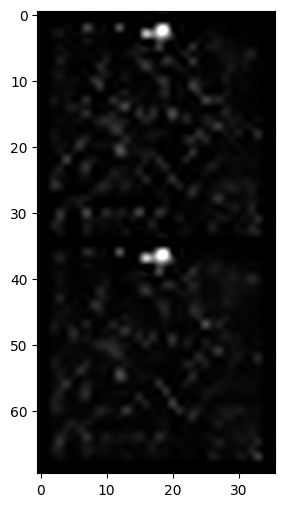

Iteration 1100    Loss 0.0013845462817698717   PSNR_noisy: 6.359305125483456   PSRN_gt:6.498385900702679  PSNR_gt_sm: 6.476967407390775


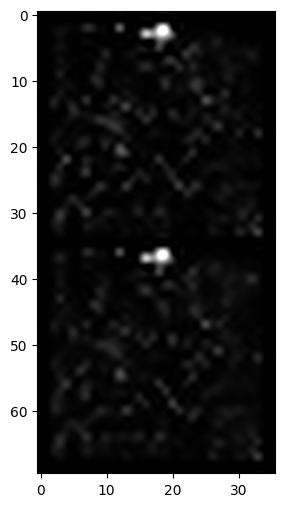

Iteration 1200    Loss 0.001274486305192113   PSNR_noisy: 6.350627686587896   PSRN_gt:6.489215722581944  PSNR_gt_sm: 6.478232121567443


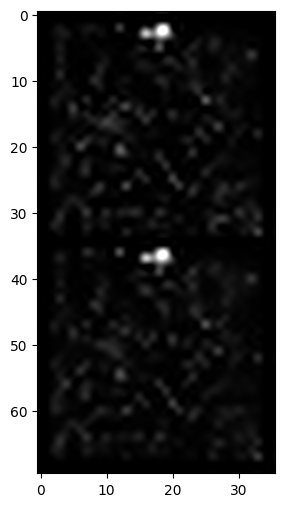

Iteration 1300    Loss 0.001118080923333764   PSNR_noisy: 6.340965230444988   PSRN_gt:6.474099505892253  PSNR_gt_sm: 6.477348983411333


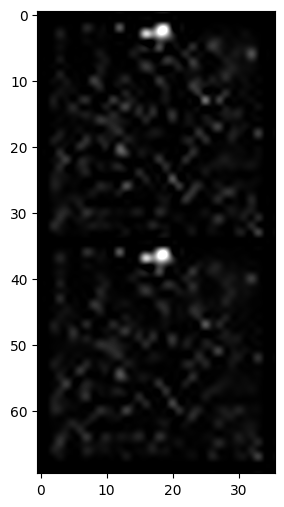

Iteration 1400    Loss 0.0009343351703137159   PSNR_noisy: 6.346509621843238   PSRN_gt:6.48119876244492  PSNR_gt_sm: 6.475758253939143


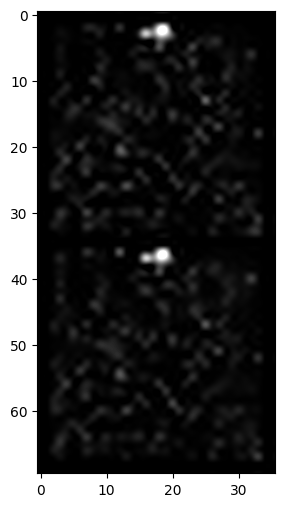

Iteration 1500    Loss 0.0009026821353472769   PSNR_noisy: 6.363105790590597   PSRN_gt:6.4973223436418  PSNR_gt_sm: 6.473481643689012


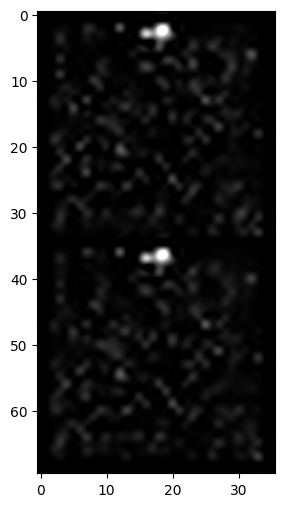

Iteration 1600    Loss 0.00080865592462942   PSNR_noisy: 6.30672273029206   PSRN_gt:6.434598869758518  PSNR_gt_sm: 6.470386292451508


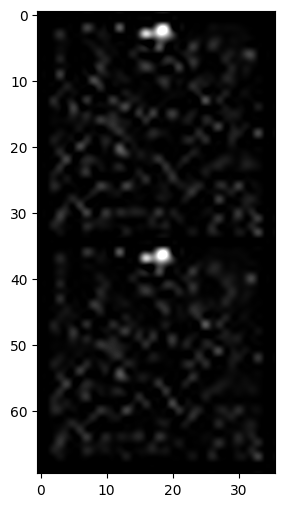

Iteration 1700    Loss 0.0006714307237416506   PSNR_noisy: 6.336208751276928   PSRN_gt:6.4660857503663784  PSNR_gt_sm: 6.466092357587742


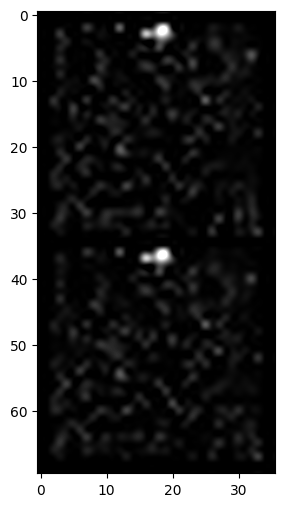

Iteration 1800    Loss 0.0006902696331962943   PSNR_noisy: 6.306162088115186   PSRN_gt:6.436578171935574  PSNR_gt_sm: 6.462568816456694


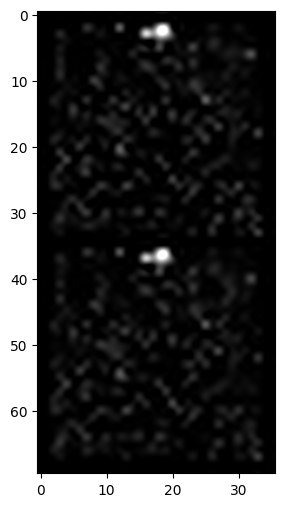

Iteration 1900    Loss 0.0004930648719891906   PSNR_noisy: 6.333800080291359   PSRN_gt:6.462004924581459  PSNR_gt_sm: 6.459243461308612


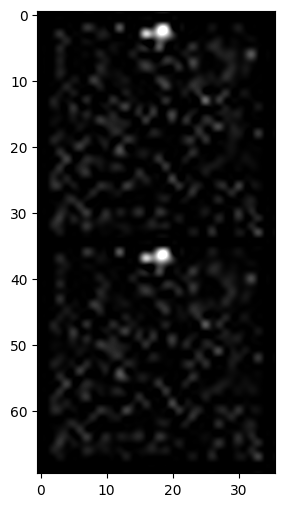

Iteration 2000    Loss 0.000423428020440042   PSNR_noisy: 6.312847335508755   PSRN_gt:6.444293886799628  PSNR_gt_sm: 6.456659346024303


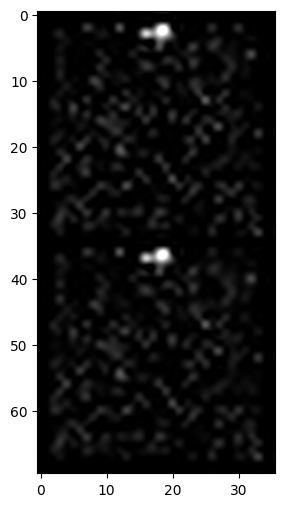

Iteration 2100    Loss 0.0003064071061089635   PSNR_noisy: 6.33231448738413   PSRN_gt:6.460958017682582  PSNR_gt_sm: 6.455310822164774


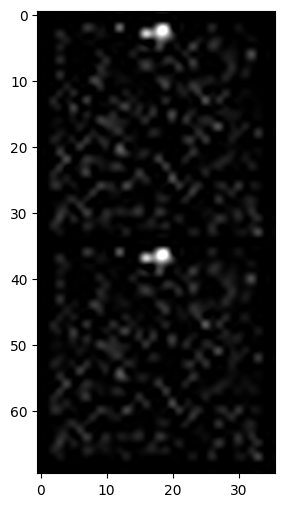

Iteration 2200    Loss 0.000366006453987211   PSNR_noisy: 6.349691799418476   PSRN_gt:6.479726471923487  PSNR_gt_sm: 6.453354992840455


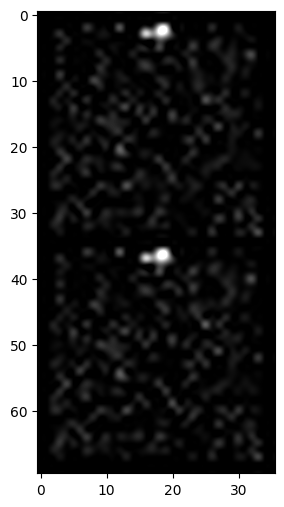

Iteration 2300    Loss 0.0004002191126346588   PSNR_noisy: 6.31696745812654   PSRN_gt:6.446867278476511  PSNR_gt_sm: 6.451669825191079


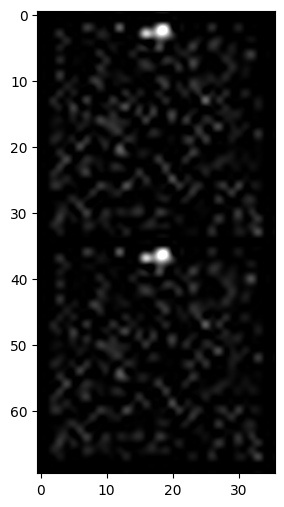

Iteration 2400    Loss 0.00023410297580994666   PSNR_noisy: 6.3394233971856195   PSRN_gt:6.470369200491945  PSNR_gt_sm: 6.449303085584347


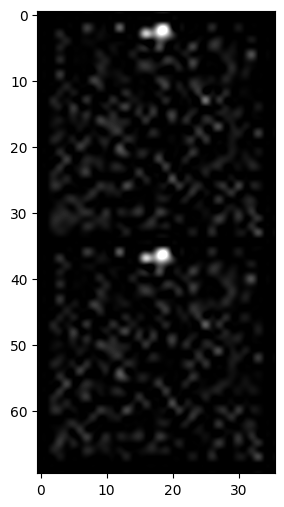

Iteration 2500    Loss 0.0002812903840094805   PSNR_noisy: 6.325613891273589   PSRN_gt:6.45383757986176  PSNR_gt_sm: 6.447343535712675


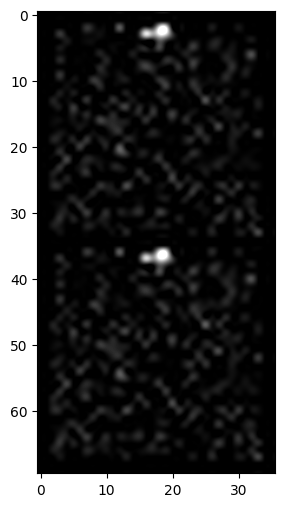

Iteration 2600    Loss 0.00022215236094780266   PSNR_noisy: 6.309926637828952   PSRN_gt:6.441711131566549  PSNR_gt_sm: 6.445292839266052


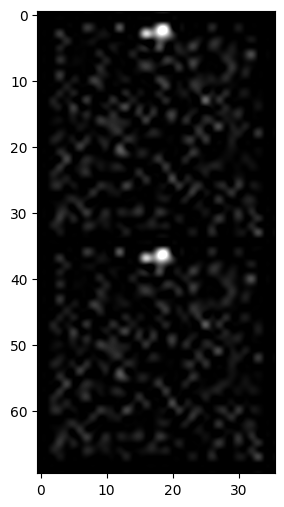

Iteration 2700    Loss 0.0001832255074987188   PSNR_noisy: 6.324554503797128   PSRN_gt:6.455358278749637  PSNR_gt_sm: 6.444296553176651


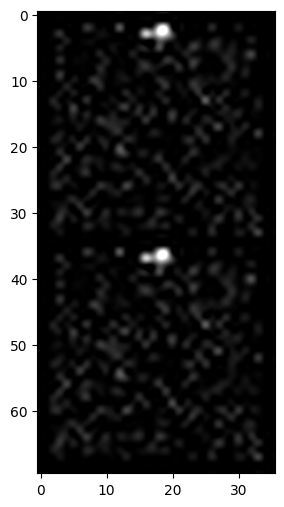

Iteration 2800    Loss 0.00015095420530997217   PSNR_noisy: 6.310861519476717   PSRN_gt:6.441346999785294  PSNR_gt_sm: 6.443021693163262


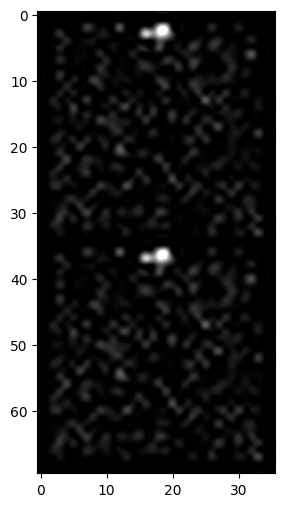

Iteration 2900    Loss 0.00011791422730311751   PSNR_noisy: 6.2978274291598115   PSRN_gt:6.4279388325289  PSNR_gt_sm: 6.442193863803661
Starting optimization with ADAM


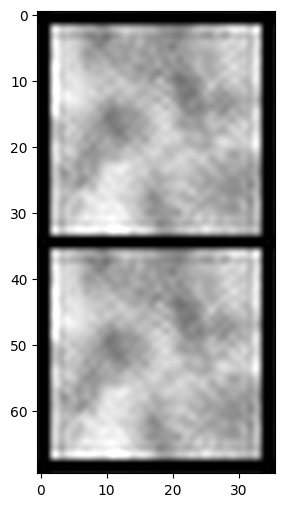

Iteration 0    Loss 0.2152365744113922   PSNR_noisy: 5.126966327181992   PSRN_gt:4.615540779148883  PSNR_gt_sm: 4.615540779148883


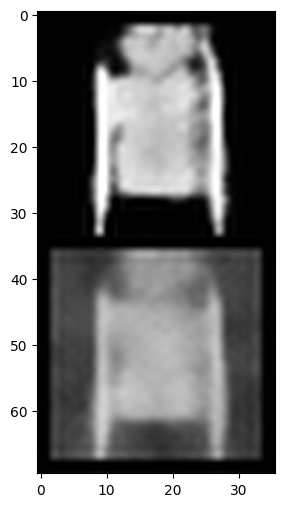

Iteration 100    Loss 0.02927849069237709   PSNR_noisy: 6.468759268434228   PSRN_gt:6.104501782174952  PSNR_gt_sm: 6.712622415475132


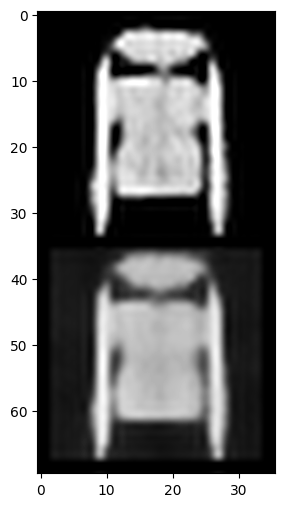

Iteration 200    Loss 0.010334262624382973   PSNR_noisy: 6.298951619246624   PSRN_gt:5.944401061621864  PSNR_gt_sm: 6.623959288319035


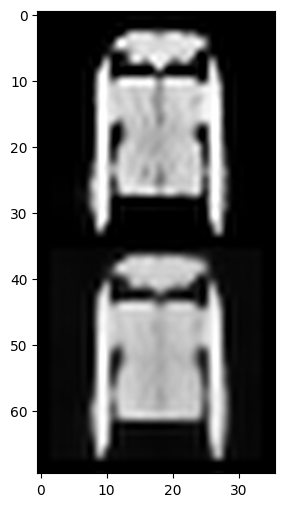

Iteration 300    Loss 0.00693491380661726   PSNR_noisy: 6.381827572576256   PSRN_gt:6.0280583773771  PSNR_gt_sm: 6.327844739398907


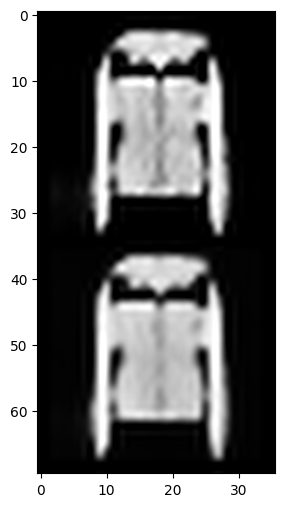

Iteration 400    Loss 0.005712885409593582   PSNR_noisy: 6.508270887965477   PSRN_gt:6.156291922638175  PSNR_gt_sm: 6.170469234658256


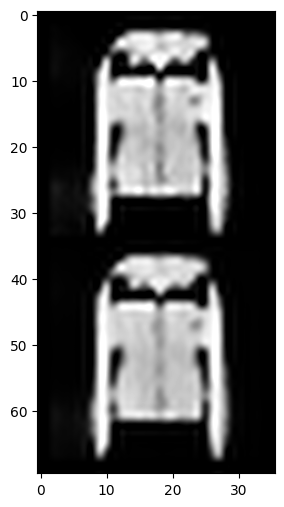

Iteration 500    Loss 0.004693018272519112   PSNR_noisy: 6.3104430865453285   PSRN_gt:5.957827559071917  PSNR_gt_sm: 6.1030932075908115


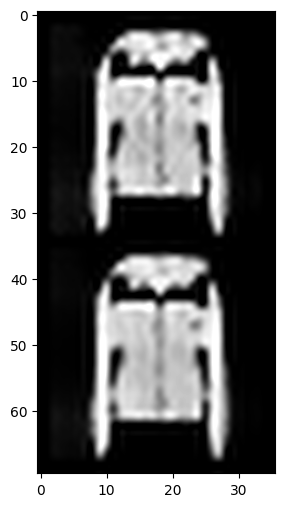

Iteration 600    Loss 0.00418085977435112   PSNR_noisy: 6.355716838632803   PSRN_gt:5.998514519269442  PSNR_gt_sm: 6.071575836653126


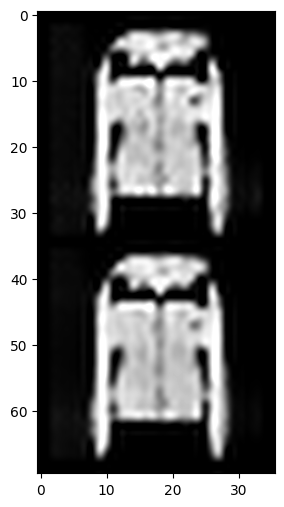

Iteration 700    Loss 0.0036779618822038174   PSNR_noisy: 6.388763073333039   PSRN_gt:6.034080738904769  PSNR_gt_sm: 6.05904659366381


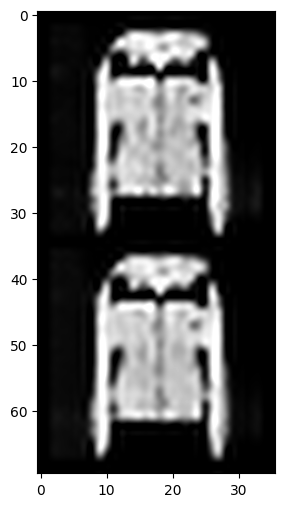

Iteration 800    Loss 0.003623680677264929   PSNR_noisy: 6.346200824394322   PSRN_gt:5.992138000999949  PSNR_gt_sm: 6.050200119684169


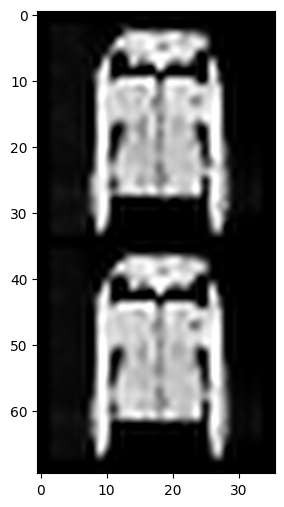

Iteration 900    Loss 0.003211911069229245   PSNR_noisy: 6.40430264507112   PSRN_gt:6.04036987569668  PSNR_gt_sm: 6.045327845875287


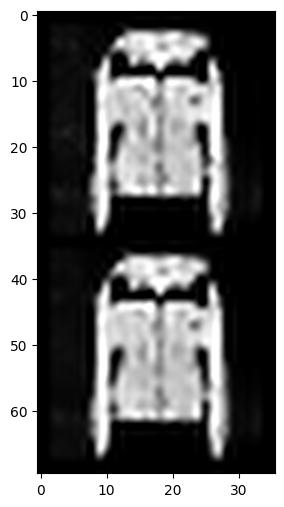

Iteration 1000    Loss 0.00266419630497694   PSNR_noisy: 6.4030716998829815   PSRN_gt:6.0403687236120485  PSNR_gt_sm: 6.040112938864402


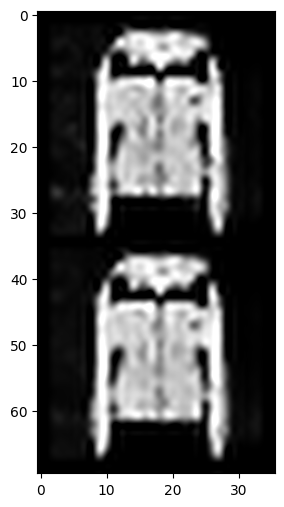

Iteration 1100    Loss 0.0028017153963446617   PSNR_noisy: 6.46193694167411   PSRN_gt:6.102989299136027  PSNR_gt_sm: 6.036318857912946


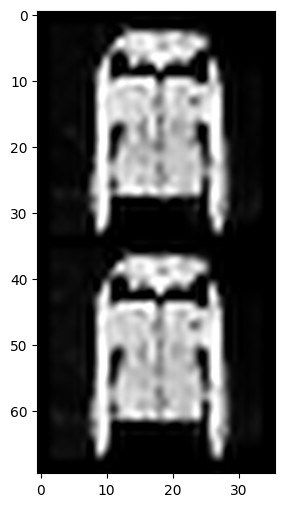

Iteration 1200    Loss 0.002780681475996971   PSNR_noisy: 6.364260547728632   PSRN_gt:6.00509281139797  PSNR_gt_sm: 6.03184586248309


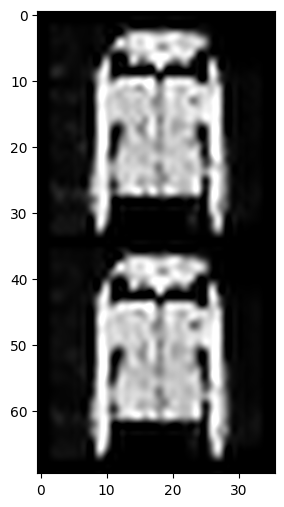

Iteration 1300    Loss 0.002596162725239992   PSNR_noisy: 6.399242328252882   PSRN_gt:6.037869122237396  PSNR_gt_sm: 6.027589459623513


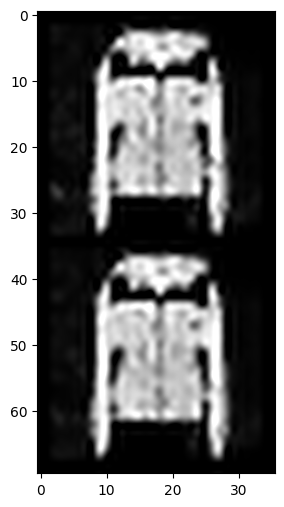

Iteration 1400    Loss 0.0021889666095376015   PSNR_noisy: 6.29812297815464   PSRN_gt:5.940799373999415  PSNR_gt_sm: 6.023364590177276


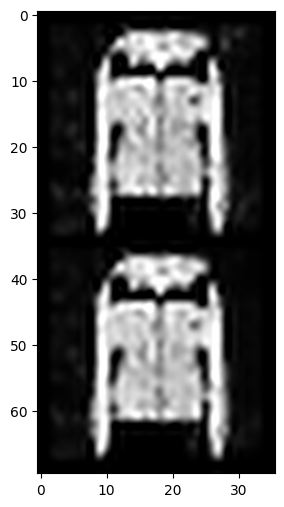

Iteration 1500    Loss 0.001965579576790333   PSNR_noisy: 6.4520456583920085   PSRN_gt:6.085346240003824  PSNR_gt_sm: 6.019463522950311


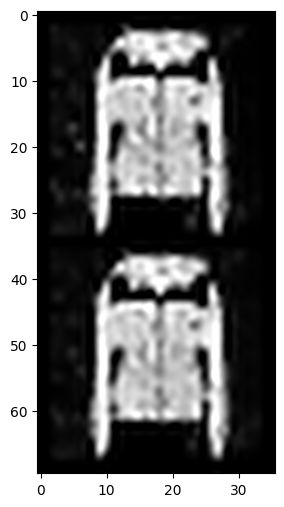

Iteration 1600    Loss 0.001976056955754757   PSNR_noisy: 6.31093839759939   PSRN_gt:5.949732139731417  PSNR_gt_sm: 6.014006326161806


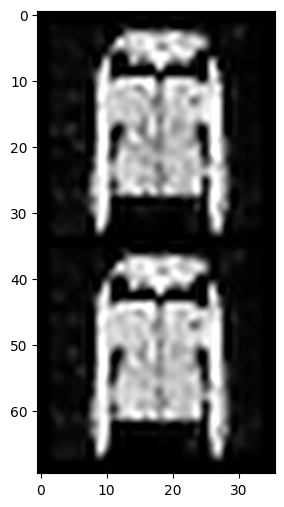

Iteration 1700    Loss 0.0020179711282253265   PSNR_noisy: 6.5049182019839655   PSRN_gt:6.134488160263497  PSNR_gt_sm: 6.011897693968859


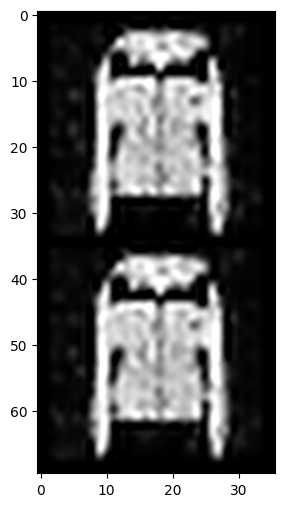

Iteration 1800    Loss 0.0015329391462728381   PSNR_noisy: 6.326330104612303   PSRN_gt:5.962962171462535  PSNR_gt_sm: 6.00710834523772


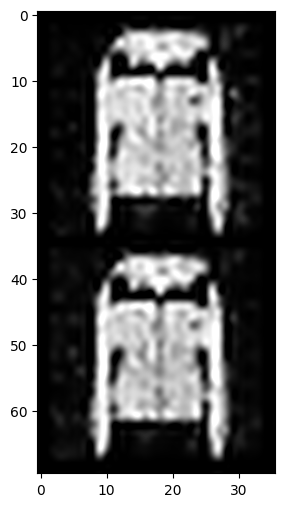

Iteration 1900    Loss 0.002149860141798854   PSNR_noisy: 6.159204641154191   PSRN_gt:5.799793588477895  PSNR_gt_sm: 6.001826942046589


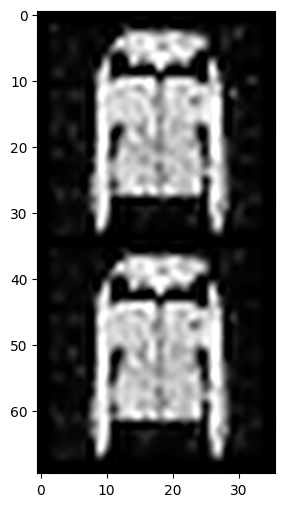

Iteration 2000    Loss 0.0012713046744465828   PSNR_noisy: 6.348882757733928   PSRN_gt:5.981304232272544  PSNR_gt_sm: 6.000403452507793


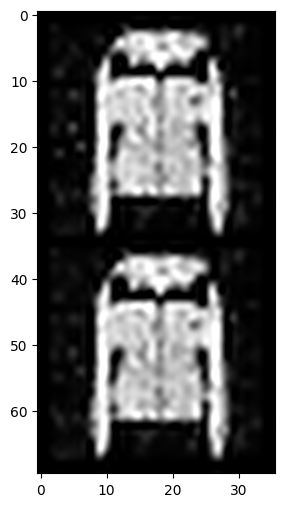

Iteration 2100    Loss 0.0011277657467871904   PSNR_noisy: 6.288872730888303   PSRN_gt:5.926687359171238  PSNR_gt_sm: 5.997432521995387


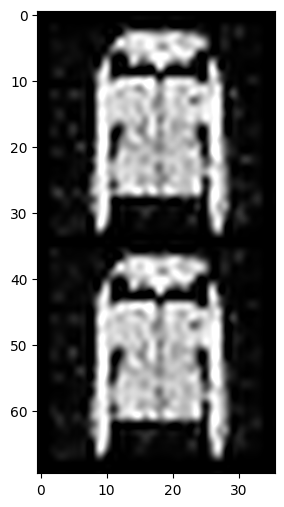

Iteration 2200    Loss 0.0010761120356619358   PSNR_noisy: 6.292096243185011   PSRN_gt:5.929653452128472  PSNR_gt_sm: 5.9948773001811855


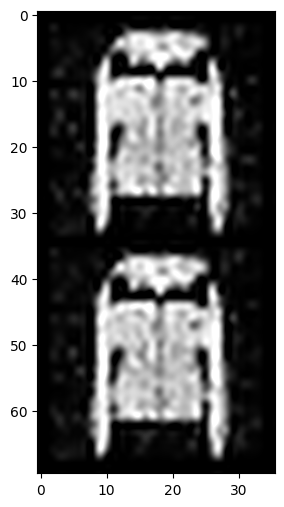

Iteration 2300    Loss 0.001177544821985066   PSNR_noisy: 6.263116335341272   PSRN_gt:5.901831958711026  PSNR_gt_sm: 5.991041649676196


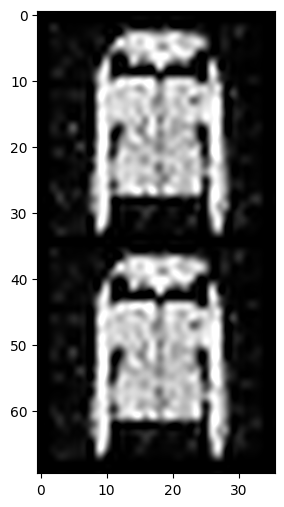

Iteration 2400    Loss 0.0009548085508868098   PSNR_noisy: 6.335700048527436   PSRN_gt:5.969956101595157  PSNR_gt_sm: 5.9885817041146305


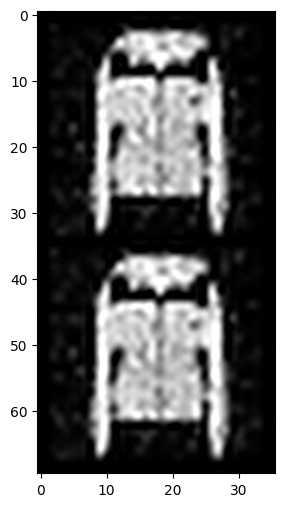

Iteration 2500    Loss 0.000806547119282186   PSNR_noisy: 6.334835879236941   PSRN_gt:5.9724525239534385  PSNR_gt_sm: 5.986709626912759


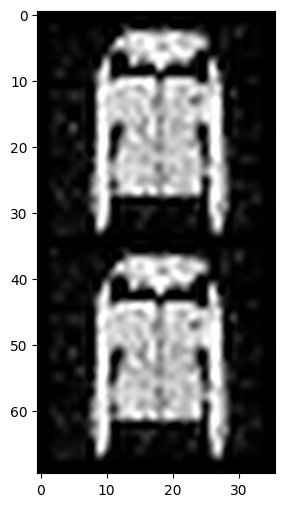

Iteration 2600    Loss 0.0008098965045064688   PSNR_noisy: 6.275958152326526   PSRN_gt:5.913765653104077  PSNR_gt_sm: 5.984189773375393


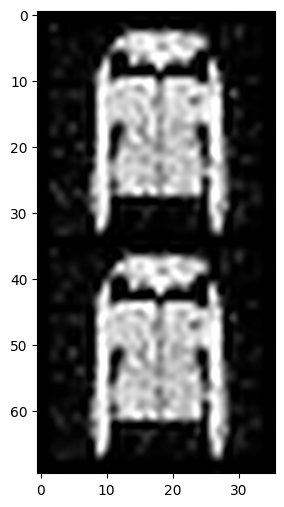

Iteration 2700    Loss 0.0008390502771362662   PSNR_noisy: 6.295488509275687   PSRN_gt:5.933328006314285  PSNR_gt_sm: 5.981224425614945


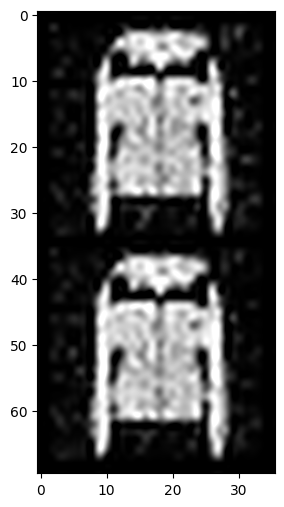

Iteration 2800    Loss 0.0009213523007929325   PSNR_noisy: 6.416955772412014   PSRN_gt:6.047928248477859  PSNR_gt_sm: 5.982733376457223


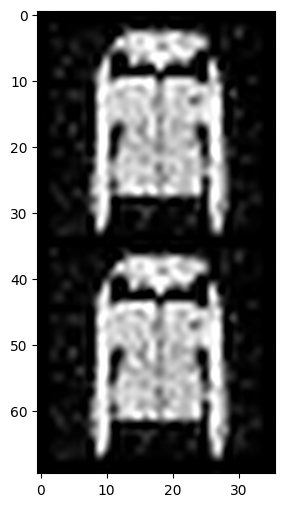

Iteration 2900    Loss 0.0006985440850257874   PSNR_noisy: 6.287795216265197   PSRN_gt:5.926237801228237  PSNR_gt_sm: 5.979006904275246
Starting optimization with ADAM


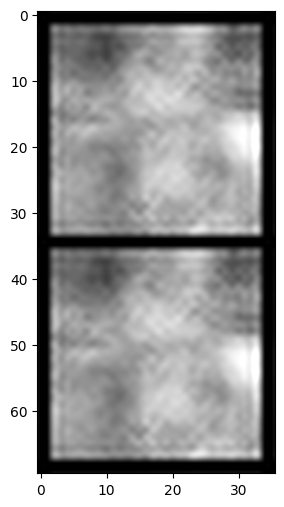

Iteration 0    Loss 0.21810145676136017   PSNR_noisy: 6.676336491588418   PSRN_gt:6.10877910698795  PSNR_gt_sm: 6.10877910698795


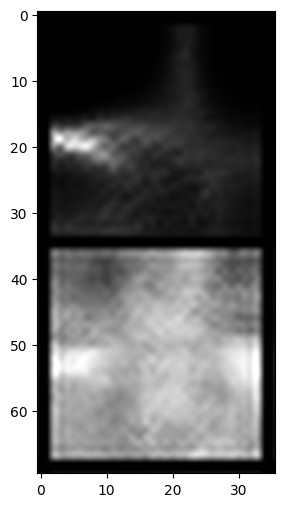

Iteration 100    Loss 0.005584811791777611   PSNR_noisy: 17.8849630811542   PSRN_gt:18.954546685011  PSNR_gt_sm: 13.38263669321082


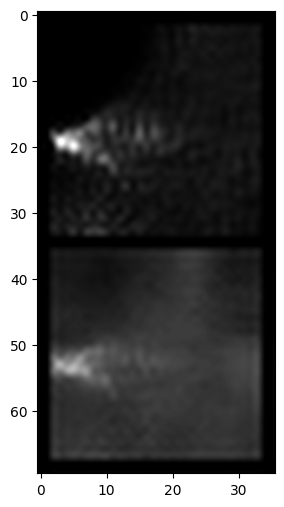

Iteration 200    Loss 0.004812263883650303   PSNR_noisy: 17.90068060772993   PSRN_gt:18.83179873947317  PSNR_gt_sm: 17.471345298870844


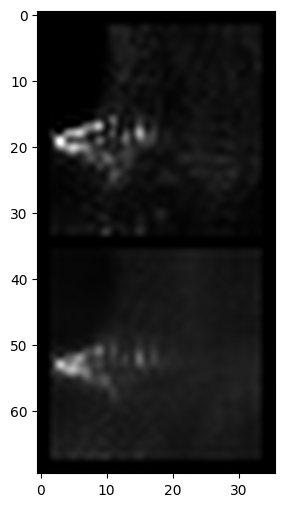

Iteration 300    Loss 0.004342455882579088   PSNR_noisy: 17.807192436245543   PSRN_gt:18.61179515669455  PSNR_gt_sm: 18.64639415498267


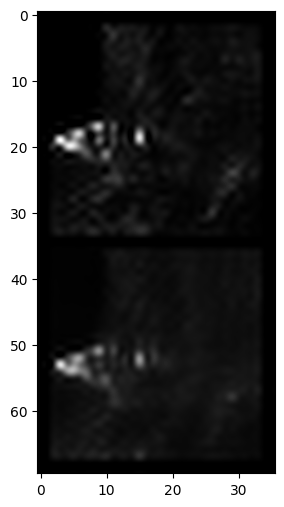

Iteration 400    Loss 0.0035578093957155943   PSNR_noisy: 17.58867122775967   PSRN_gt:18.448767654065964  PSNR_gt_sm: 18.75213853841109


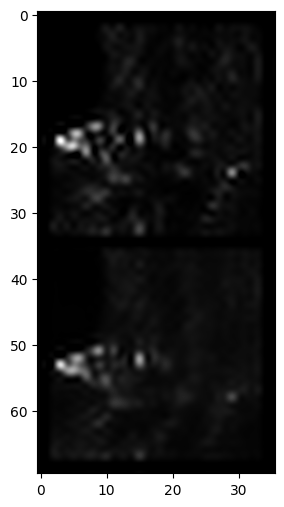

Iteration 500    Loss 0.0030307816341519356   PSNR_noisy: 17.477759895707948   PSRN_gt:18.2376580453801  PSNR_gt_sm: 18.657204804637747


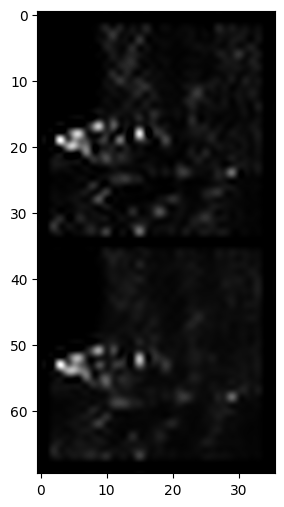

Iteration 600    Loss 0.0027541890740394592   PSNR_noisy: 17.53342612583296   PSRN_gt:18.290068161723468  PSNR_gt_sm: 18.546982122590713


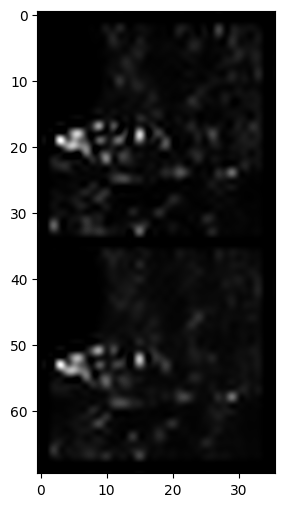

Iteration 700    Loss 0.002478466834872961   PSNR_noisy: 17.317457728530737   PSRN_gt:18.08550058432797  PSNR_gt_sm: 18.43269350816324


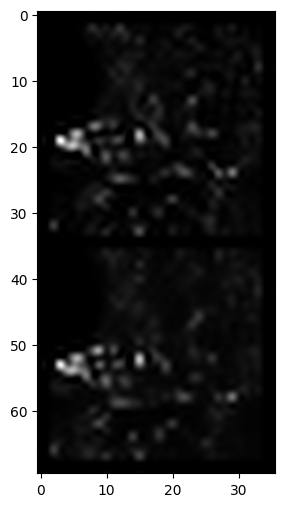

Iteration 800    Loss 0.0024388027377426624   PSNR_noisy: 17.509146457903896   PSRN_gt:18.30999988933143  PSNR_gt_sm: 18.352570302872266


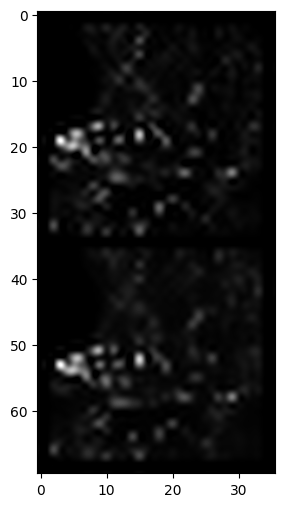

Iteration 900    Loss 0.0021131718531250954   PSNR_noisy: 17.428968131469468   PSRN_gt:18.215670199379687  PSNR_gt_sm: 18.265976450793644


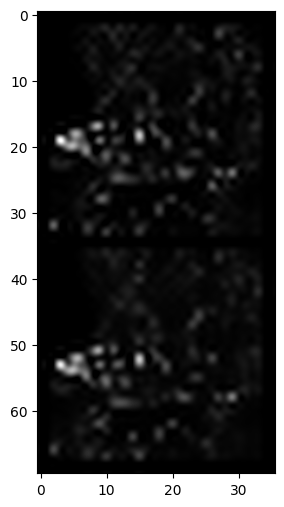

Iteration 1000    Loss 0.0017803595401346684   PSNR_noisy: 17.37495339641177   PSRN_gt:18.052174402300864  PSNR_gt_sm: 18.18634618831329


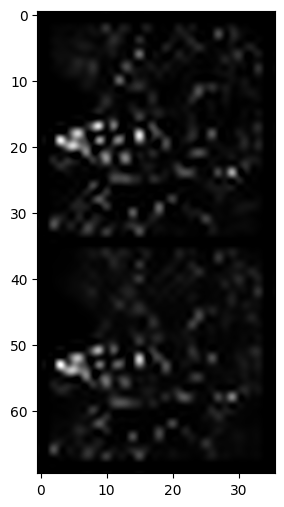

Iteration 1100    Loss 0.0015824460424482822   PSNR_noisy: 17.090198239447567   PSRN_gt:17.742317486725018  PSNR_gt_sm: 18.127186025345118


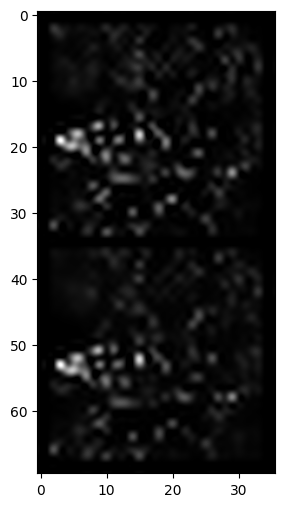

Iteration 1200    Loss 0.001402976573444903   PSNR_noisy: 17.13158184235357   PSRN_gt:17.712619795980377  PSNR_gt_sm: 18.04881071775816


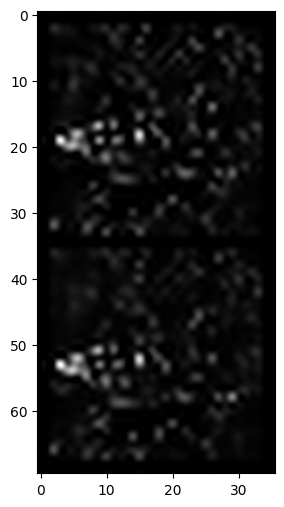

Iteration 1300    Loss 0.0012255626497790217   PSNR_noisy: 17.285471229806568   PSRN_gt:17.907624510426096  PSNR_gt_sm: 17.99786577593029


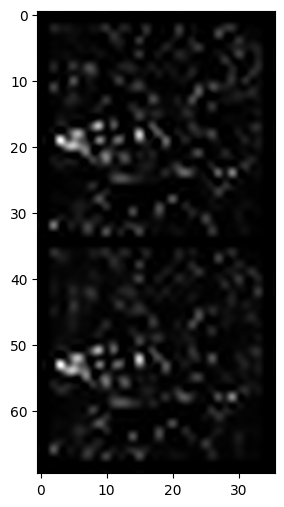

Iteration 1400    Loss 0.0010521950898692012   PSNR_noisy: 17.180076171390972   PSRN_gt:17.794029500801848  PSNR_gt_sm: 17.91892298370241


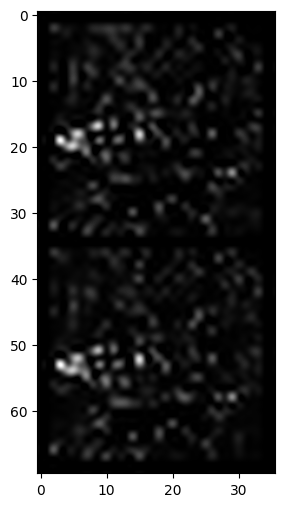

Iteration 1500    Loss 0.0011292695999145508   PSNR_noisy: 17.211099042780397   PSRN_gt:17.842564275541758  PSNR_gt_sm: 17.86985234055656


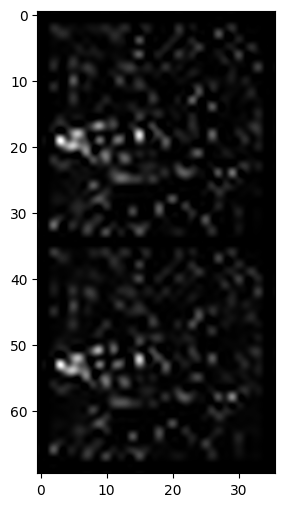

Iteration 1600    Loss 0.0008125194581225514   PSNR_noisy: 17.058351235908404   PSRN_gt:17.61044595969938  PSNR_gt_sm: 17.807934000550205


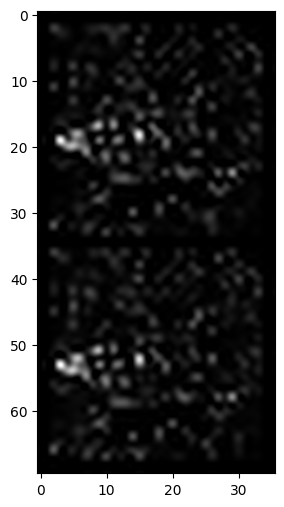

Iteration 1700    Loss 0.0007666255114600062   PSNR_noisy: 17.138262622548798   PSRN_gt:17.72150728144007  PSNR_gt_sm: 17.754322668291586


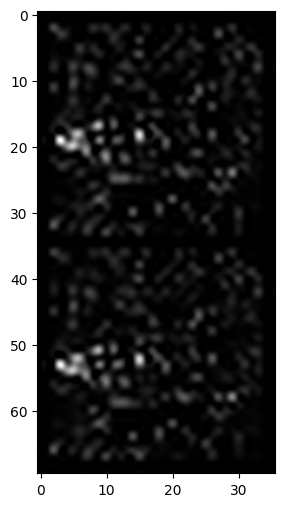

Iteration 1800    Loss 0.0005434450577013195   PSNR_noisy: 16.990965683338754   PSRN_gt:17.56233580255582  PSNR_gt_sm: 17.71571924592652


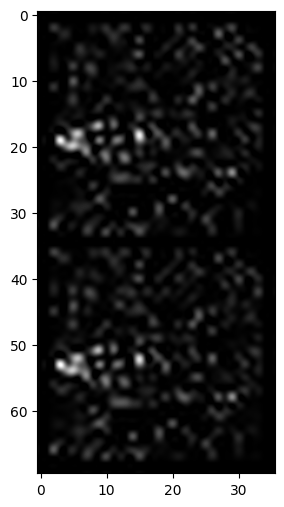

Iteration 1900    Loss 0.0005418393993750215   PSNR_noisy: 16.943024777693772   PSRN_gt:17.5285706454999  PSNR_gt_sm: 17.675546353505574


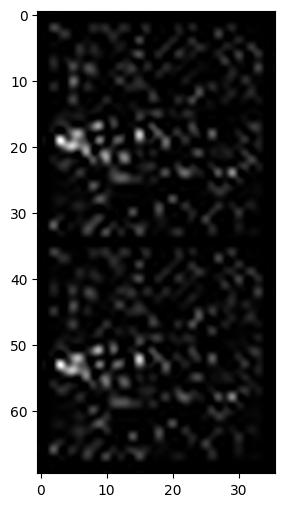

Iteration 2000    Loss 0.0005685667274519801   PSNR_noisy: 16.89408766651177   PSRN_gt:17.45166923813272  PSNR_gt_sm: 17.65160922312468


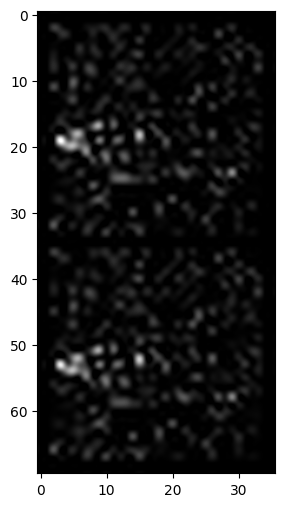

Iteration 2100    Loss 0.0003746338770724833   PSNR_noisy: 16.917266446257344   PSRN_gt:17.46701089728554  PSNR_gt_sm: 17.619135379216818


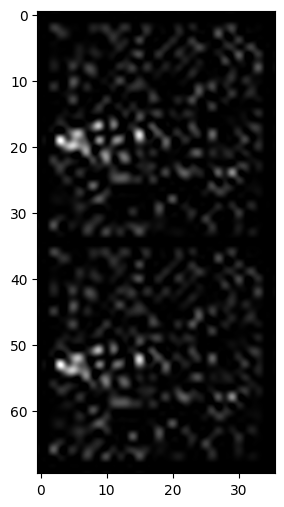

Iteration 2200    Loss 0.0003800432023126632   PSNR_noisy: 16.87226247272767   PSRN_gt:17.399410824413117  PSNR_gt_sm: 17.59590358249326


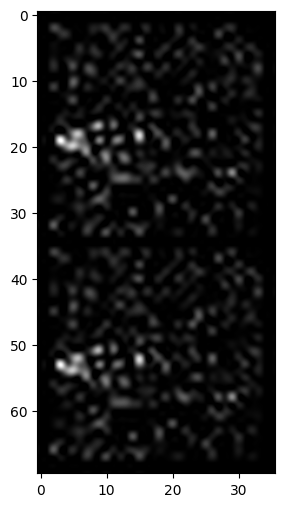

Iteration 2300    Loss 0.0002956640091724694   PSNR_noisy: 16.823339158014086   PSRN_gt:17.33665342470659  PSNR_gt_sm: 17.571666768221892


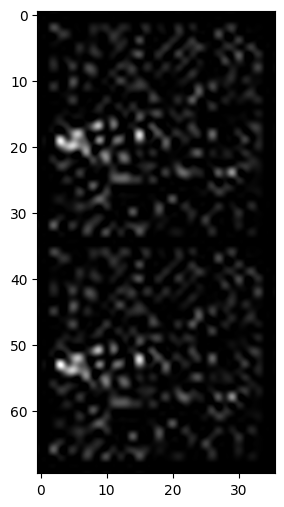

Iteration 2400    Loss 0.0002645677886903286   PSNR_noisy: 16.881868220461868   PSRN_gt:17.429122552073217  PSNR_gt_sm: 17.55322597911842


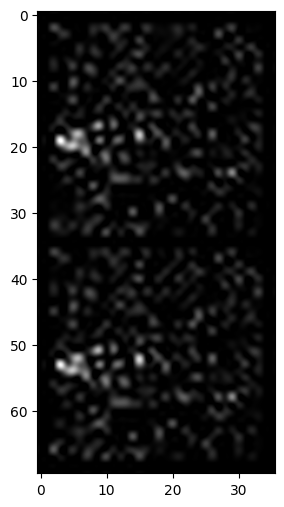

Iteration 2500    Loss 0.0002742926008068025   PSNR_noisy: 16.9368273556853   PSRN_gt:17.49215675716207  PSNR_gt_sm: 17.53666897926928


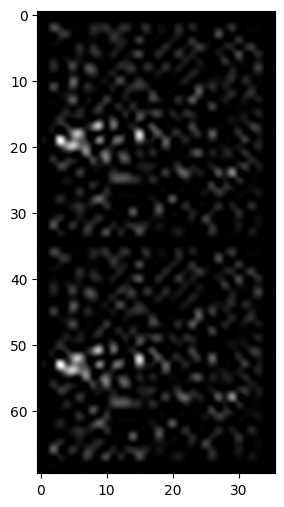

Iteration 2600    Loss 0.00016030386905185878   PSNR_noisy: 16.9502790258322   PSRN_gt:17.52338404988913  PSNR_gt_sm: 17.52266943867739


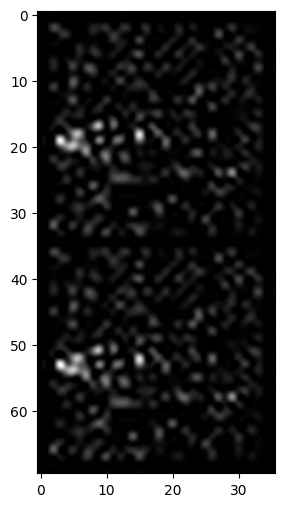

Iteration 2700    Loss 0.00018091395031660795   PSNR_noisy: 16.931381065067747   PSRN_gt:17.5213549916214  PSNR_gt_sm: 17.517502183013253


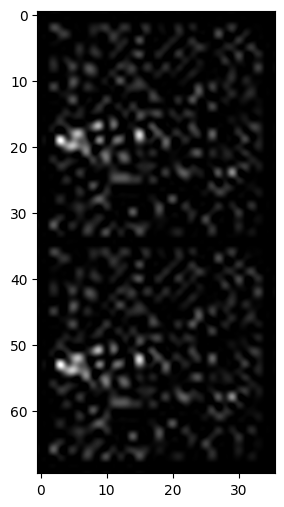

Iteration 2800    Loss 0.00011327315587550402   PSNR_noisy: 16.923998818045987   PSRN_gt:17.466484538191366  PSNR_gt_sm: 17.50217613257171


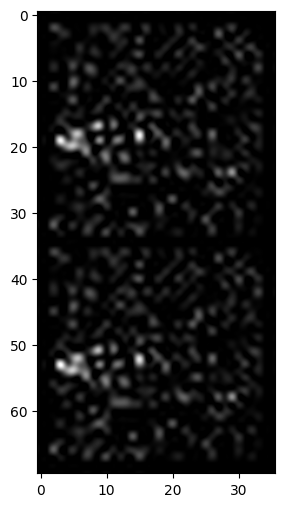

Iteration 2900    Loss 0.00016082673391792923   PSNR_noisy: 16.849502656846504   PSRN_gt:17.389176863224673  PSNR_gt_sm: 17.492799951795863
Starting optimization with ADAM


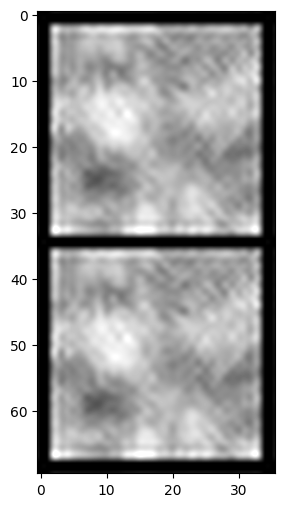

Iteration 0    Loss 0.19758164882659912   PSNR_noisy: 7.526196084991574   PSRN_gt:7.004538279856506  PSNR_gt_sm: 7.004538279856506


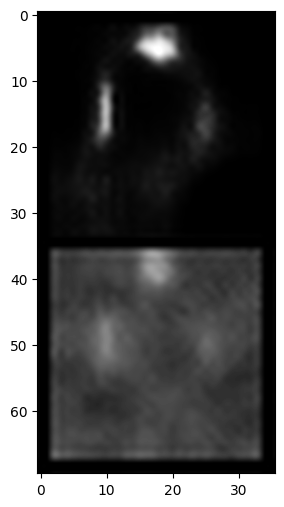

Iteration 100    Loss 0.00625311303883791   PSNR_noisy: 14.696547846649786   PSRN_gt:15.023664770180634  PSNR_gt_sm: 13.636635244375777


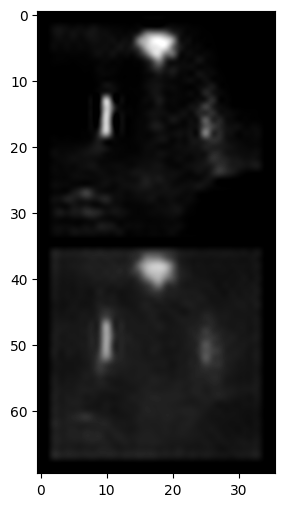

Iteration 200    Loss 0.004210885614156723   PSNR_noisy: 14.636765431688465   PSRN_gt:14.969196963835358  PSNR_gt_sm: 15.516206847683291


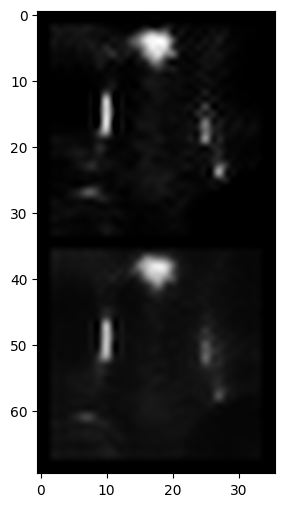

Iteration 300    Loss 0.0035947253927588463   PSNR_noisy: 14.488052381571093   PSRN_gt:14.804125927954814  PSNR_gt_sm: 15.332645410087437


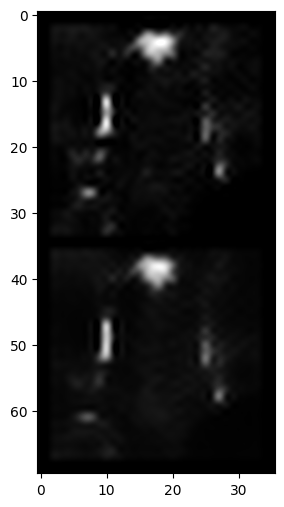

Iteration 400    Loss 0.0029233754612505436   PSNR_noisy: 14.577205921542154   PSRN_gt:14.841676862425203  PSNR_gt_sm: 15.131036286011529


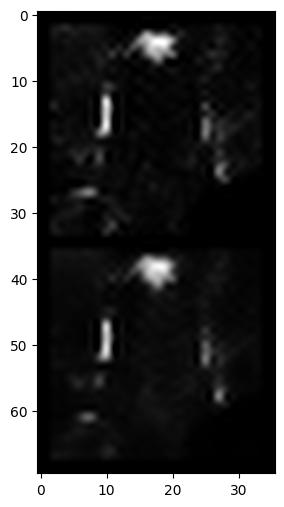

Iteration 500    Loss 0.002717698458582163   PSNR_noisy: 14.571736199017566   PSRN_gt:14.824426985434167  PSNR_gt_sm: 15.02054936234838


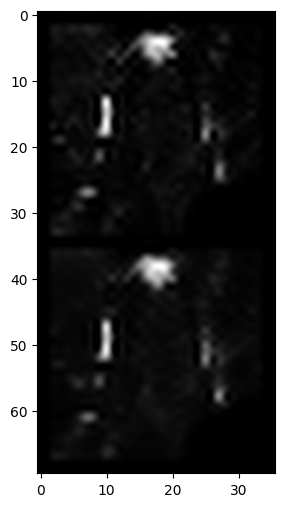

Iteration 600    Loss 0.002419827738776803   PSNR_noisy: 14.510808312718872   PSRN_gt:14.820136511229476  PSNR_gt_sm: 14.960571778803542


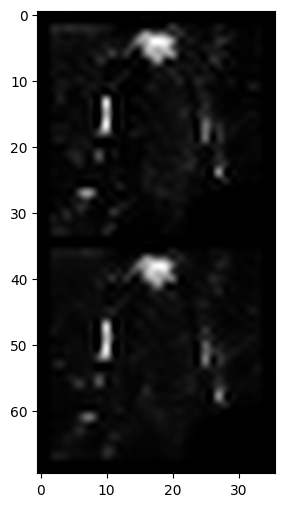

Iteration 700    Loss 0.002350832335650921   PSNR_noisy: 14.45840479460534   PSRN_gt:14.706872169067653  PSNR_gt_sm: 14.915765200889993


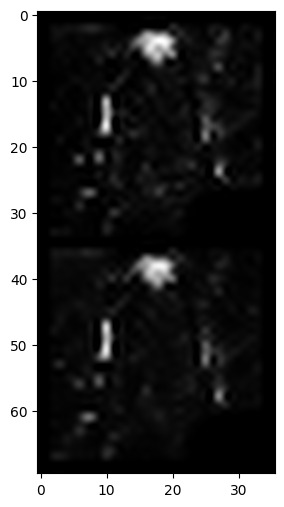

Iteration 800    Loss 0.0020705540664494038   PSNR_noisy: 14.381934879215613   PSRN_gt:14.63449451983001  PSNR_gt_sm: 14.880399594620265


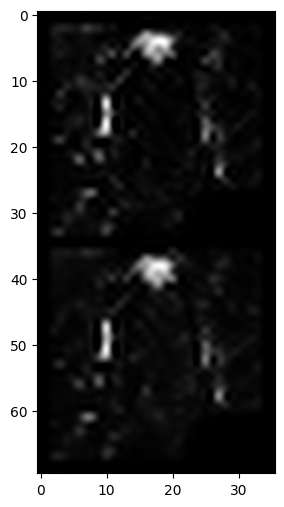

Iteration 900    Loss 0.001963074551895261   PSNR_noisy: 14.35002029350352   PSRN_gt:14.61102286785762  PSNR_gt_sm: 14.84891554983836


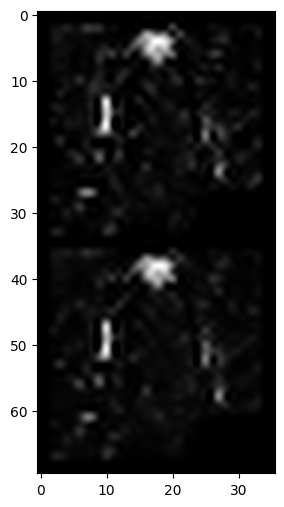

Iteration 1000    Loss 0.0014772198628634214   PSNR_noisy: 14.437838149089702   PSRN_gt:14.686438511911678  PSNR_gt_sm: 14.82112717246443


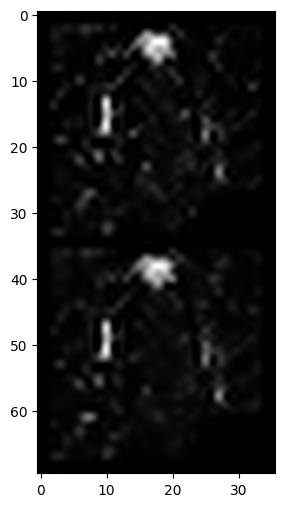

Iteration 1100    Loss 0.0013687675818800926   PSNR_noisy: 14.437627995966684   PSRN_gt:14.703738702061266  PSNR_gt_sm: 14.79962419233394


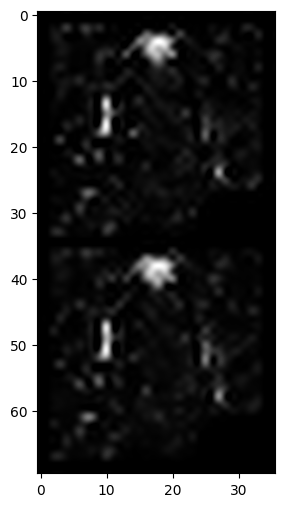

Iteration 1200    Loss 0.001530543202534318   PSNR_noisy: 14.561080236943052   PSRN_gt:14.830393916709513  PSNR_gt_sm: 14.783846623366905


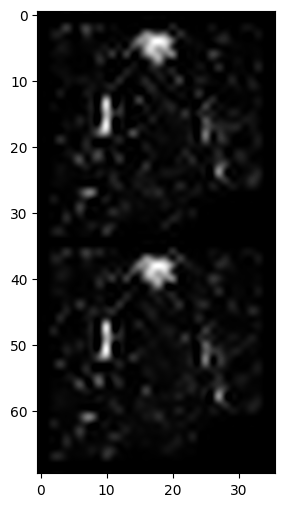

Iteration 1300    Loss 0.0010718726553022861   PSNR_noisy: 14.474054664325688   PSRN_gt:14.743414567228497  PSNR_gt_sm: 14.753098981429911


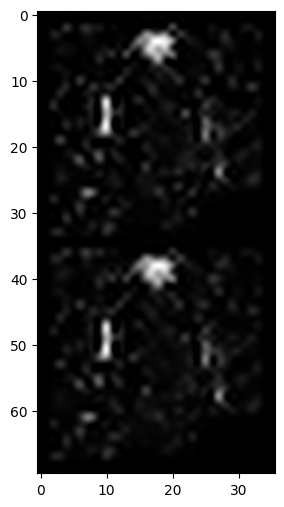

Iteration 1400    Loss 0.0008714551804587245   PSNR_noisy: 14.397943534894909   PSRN_gt:14.660704195440522  PSNR_gt_sm: 14.73373246300624


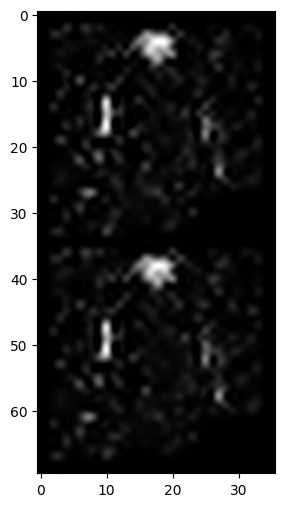

Iteration 1500    Loss 0.0008625459158793092   PSNR_noisy: 14.359687433809619   PSRN_gt:14.619363432100133  PSNR_gt_sm: 14.715426554965862


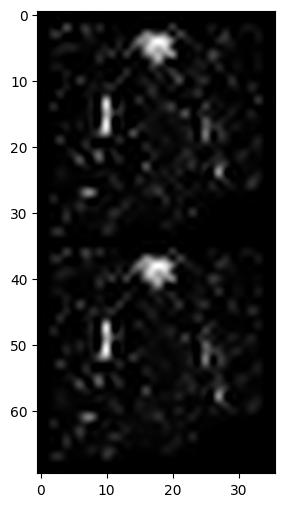

Iteration 1600    Loss 0.0007813539123162627   PSNR_noisy: 14.40965143248723   PSRN_gt:14.65176539661222  PSNR_gt_sm: 14.696196090295174


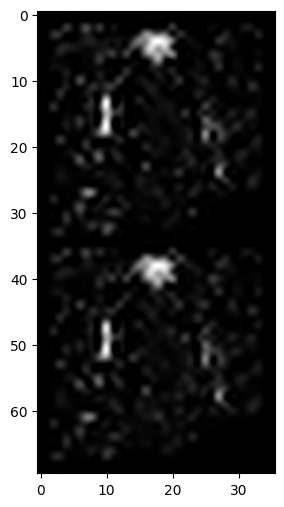

Iteration 1700    Loss 0.0007588727166876197   PSNR_noisy: 14.309052893379   PSRN_gt:14.55136626216169  PSNR_gt_sm: 14.677990077197906


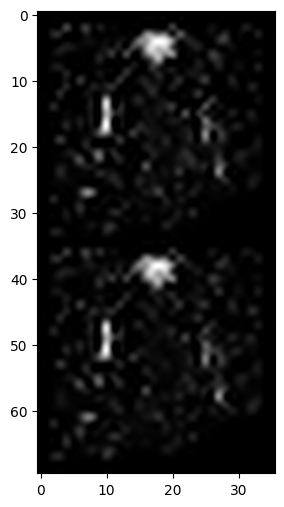

Iteration 1800    Loss 0.0007482632645405829   PSNR_noisy: 14.364922129950644   PSRN_gt:14.616498893057514  PSNR_gt_sm: 14.66590747150046


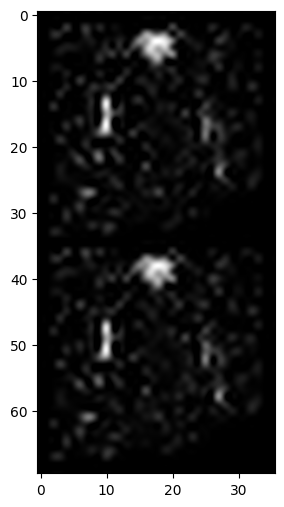

Iteration 1900    Loss 0.0005741745699197054   PSNR_noisy: 14.276160222270036   PSRN_gt:14.510065641438404  PSNR_gt_sm: 14.647615459696288


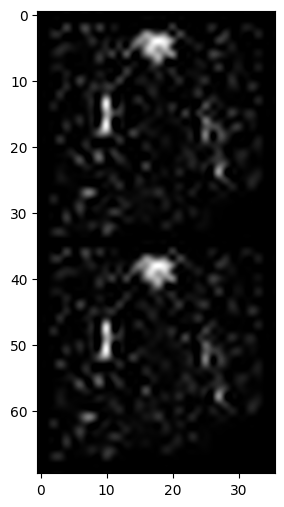

Iteration 2000    Loss 0.00047781504690647125   PSNR_noisy: 14.3424331374431   PSRN_gt:14.570308643387136  PSNR_gt_sm: 14.635677445311687


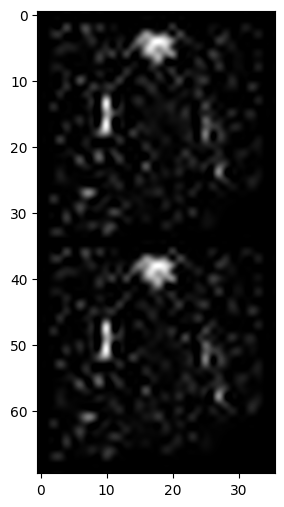

Iteration 2100    Loss 0.0005027313018217683   PSNR_noisy: 14.332166819356193   PSRN_gt:14.571869855785772  PSNR_gt_sm: 14.625655348666594


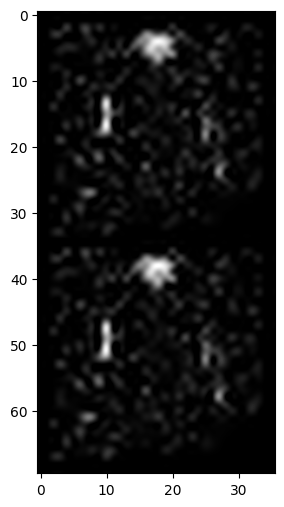

Iteration 2200    Loss 0.00036778603680431843   PSNR_noisy: 14.435499757790684   PSRN_gt:14.676828556973653  PSNR_gt_sm: 14.61690744396002


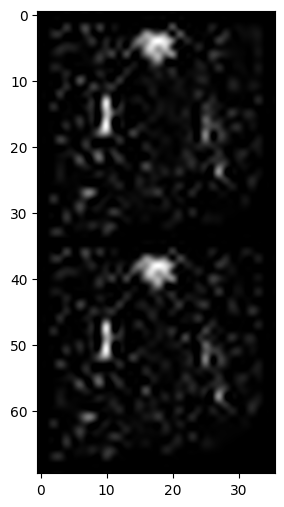

Iteration 2300    Loss 0.0005555027164518833   PSNR_noisy: 14.28482968562041   PSRN_gt:14.514990255782617  PSNR_gt_sm: 14.609128782011487


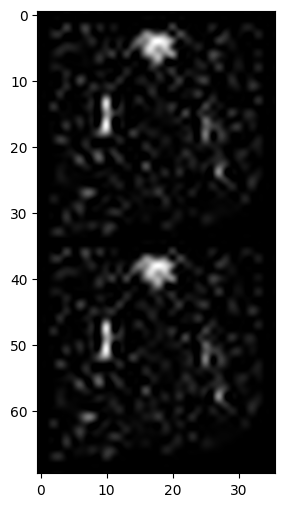

Iteration 2400    Loss 0.0003183832159265876   PSNR_noisy: 14.326985807146391   PSRN_gt:14.573280154865156  PSNR_gt_sm: 14.601521832297696


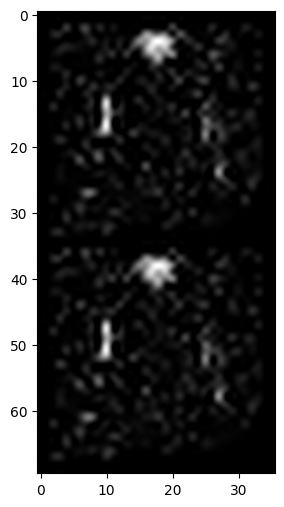

Iteration 2500    Loss 0.0003453406970947981   PSNR_noisy: 14.309578001298535   PSRN_gt:14.53406683071  PSNR_gt_sm: 14.592978995258083


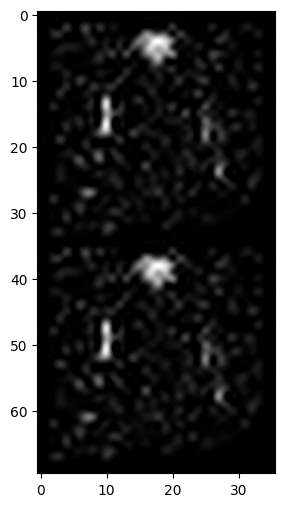

Iteration 2600    Loss 0.00024347790167666972   PSNR_noisy: 14.385459058191852   PSRN_gt:14.616634724106603  PSNR_gt_sm: 14.586834019655155


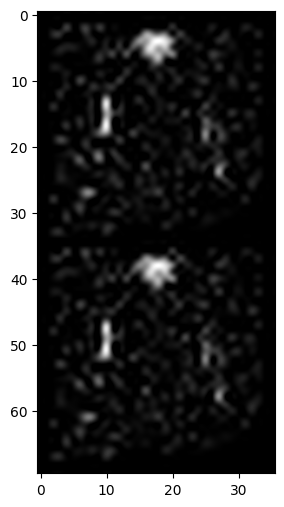

Iteration 2700    Loss 0.00027518568094819784   PSNR_noisy: 14.240186572569083   PSRN_gt:14.4559466601345  PSNR_gt_sm: 14.579990580386927


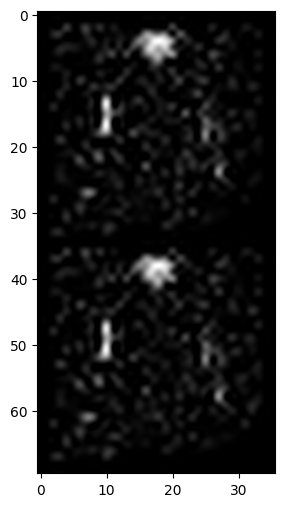

Iteration 2800    Loss 0.0003367436584085226   PSNR_noisy: 14.321146797240283   PSRN_gt:14.544296016409863  PSNR_gt_sm: 14.577782059684301


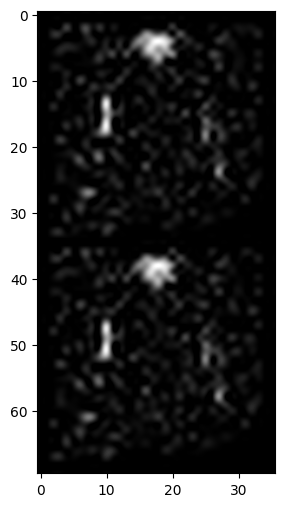

Iteration 2900    Loss 0.00019610358867794275   PSNR_noisy: 14.28848646433326   PSRN_gt:14.494875560271094  PSNR_gt_sm: 14.572175646193589
Starting optimization with ADAM


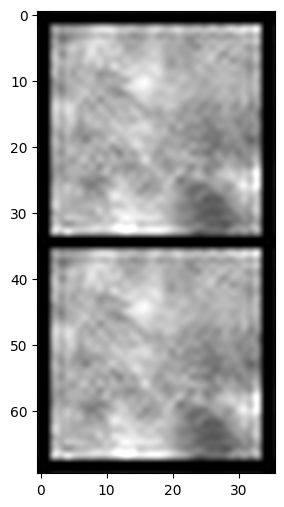

Iteration 0    Loss 0.17754927277565002   PSNR_noisy: 8.522236860376593   PSRN_gt:8.14387745961875  PSNR_gt_sm: 8.14387745961875


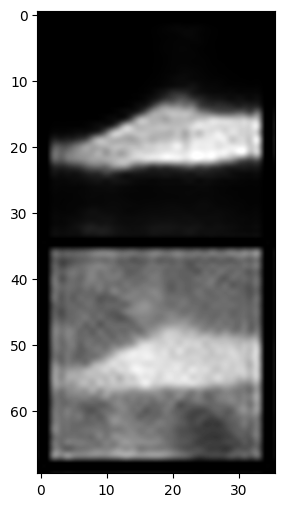

Iteration 100    Loss 0.00763830216601491   PSNR_noisy: 8.192576974478992   PSRN_gt:8.259455266323528  PSNR_gt_sm: 9.629678500078342


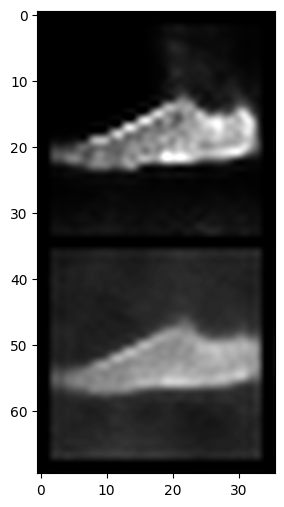

Iteration 200    Loss 0.005387394689023495   PSNR_noisy: 8.149489672468968   PSRN_gt:8.20456674105881  PSNR_gt_sm: 8.86596183663002


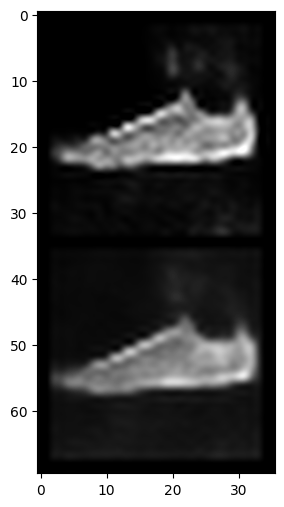

Iteration 300    Loss 0.004429598338901997   PSNR_noisy: 8.182918820251121   PSRN_gt:8.238034994560525  PSNR_gt_sm: 8.445908260570494


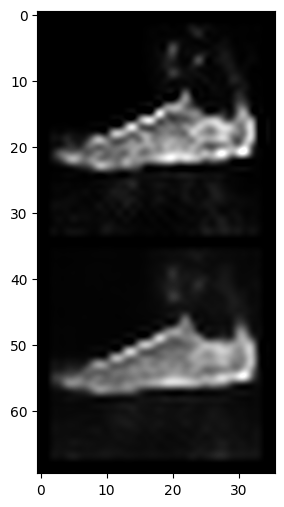

Iteration 400    Loss 0.003860663389787078   PSNR_noisy: 8.106719844551737   PSRN_gt:8.172256113008643  PSNR_gt_sm: 8.277487483640968


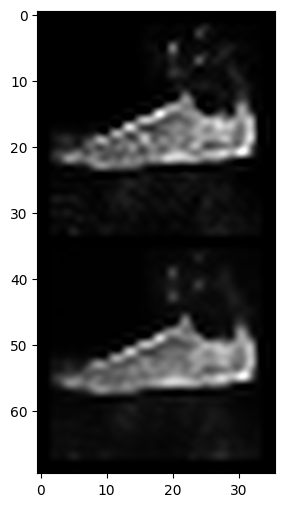

Iteration 500    Loss 0.0032289689406752586   PSNR_noisy: 8.115076410576798   PSRN_gt:8.167707680099772  PSNR_gt_sm: 8.210588218322311


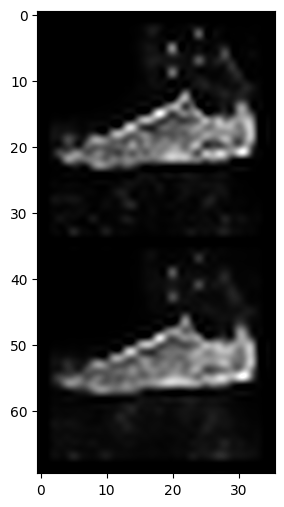

Iteration 600    Loss 0.0030436660163104534   PSNR_noisy: 8.013183407742051   PSRN_gt:8.057009224777312  PSNR_gt_sm: 8.185473610430172


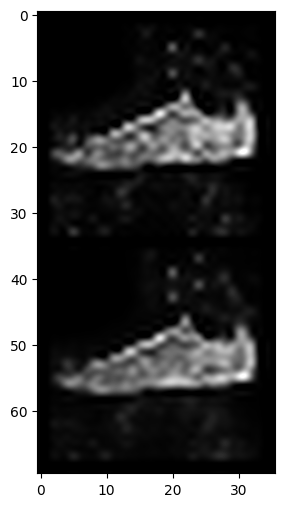

Iteration 700    Loss 0.0029195700772106647   PSNR_noisy: 8.161275755615966   PSRN_gt:8.223817417048672  PSNR_gt_sm: 8.190281706024567


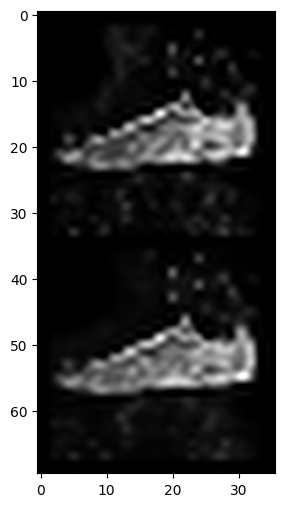

Iteration 800    Loss 0.002548541873693466   PSNR_noisy: 8.052936210221741   PSRN_gt:8.104445073013125  PSNR_gt_sm: 8.204573183095107


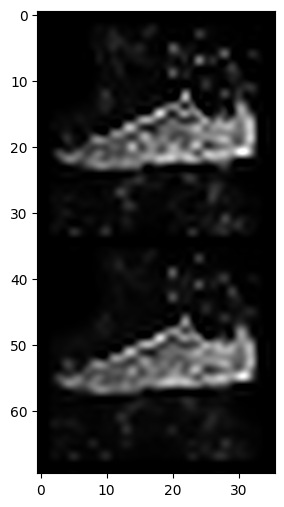

Iteration 900    Loss 0.0020759394392371178   PSNR_noisy: 8.148092414471368   PSRN_gt:8.194129092280262  PSNR_gt_sm: 8.223481247080066


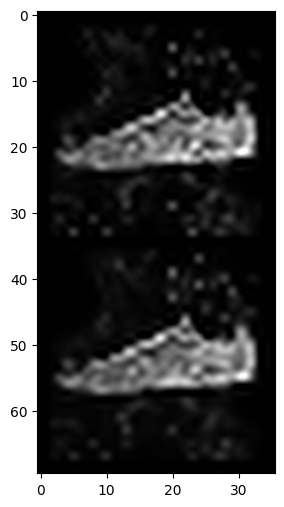

Iteration 1000    Loss 0.0018272367306053638   PSNR_noisy: 8.141149906462786   PSRN_gt:8.186719176248523  PSNR_gt_sm: 8.222752206383829


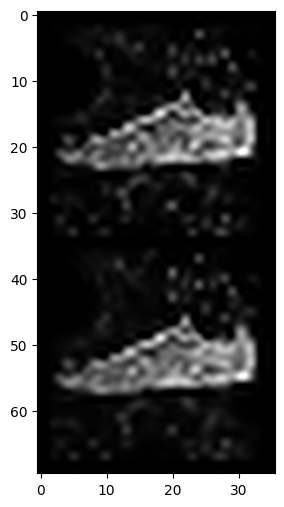

Iteration 1100    Loss 0.0015191345009952784   PSNR_noisy: 8.147740449101848   PSRN_gt:8.197397227790388  PSNR_gt_sm: 8.219424177466033


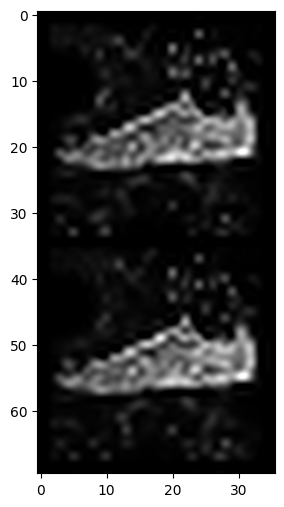

Iteration 1200    Loss 0.001562311896122992   PSNR_noisy: 8.13054240197012   PSRN_gt:8.178377126685268  PSNR_gt_sm: 8.216776062171046


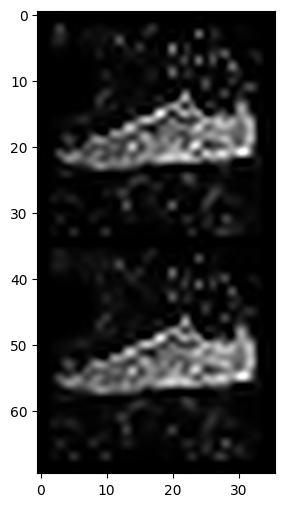

Iteration 1300    Loss 0.0011231066891923547   PSNR_noisy: 8.098004633042867   PSRN_gt:8.137953738353742  PSNR_gt_sm: 8.213870788098808


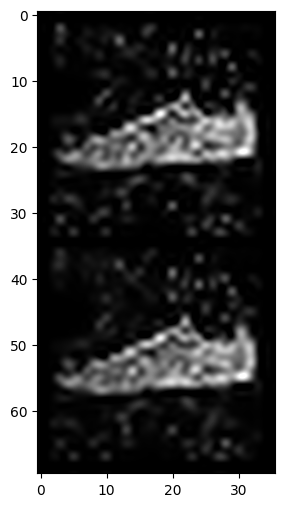

Iteration 1400    Loss 0.0009463007445447147   PSNR_noisy: 8.195858987088174   PSRN_gt:8.23968121015514  PSNR_gt_sm: 8.207943890800847


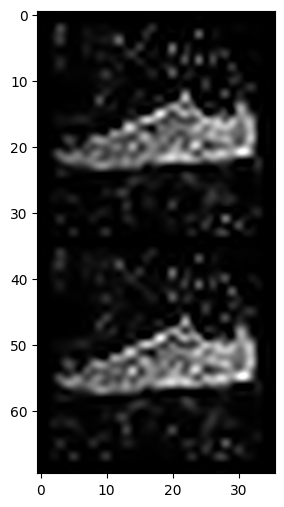

Iteration 1500    Loss 0.0009653849992901087   PSNR_noisy: 8.097430862246144   PSRN_gt:8.144317378345509  PSNR_gt_sm: 8.202727999689554


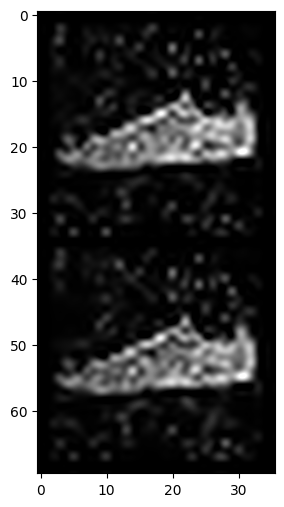

Iteration 1600    Loss 0.0010588027071207762   PSNR_noisy: 8.260556438627644   PSRN_gt:8.30916346397856  PSNR_gt_sm: 8.201092683142836


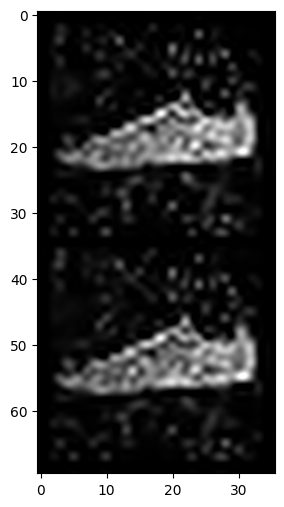

Iteration 1700    Loss 0.0009349138126708567   PSNR_noisy: 8.207984874966673   PSRN_gt:8.25641651543579  PSNR_gt_sm: 8.200131842014263


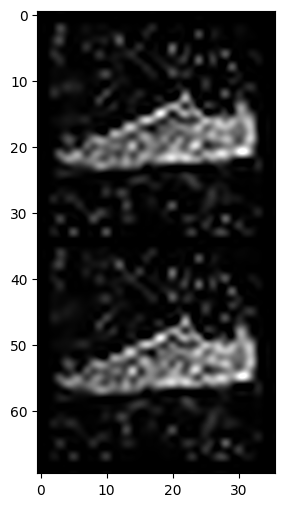

Iteration 1800    Loss 0.0006723328260704875   PSNR_noisy: 8.144852828087135   PSRN_gt:8.188509126631565  PSNR_gt_sm: 8.19677191840086


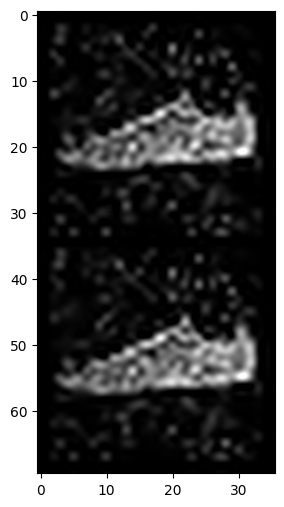

Iteration 1900    Loss 0.0005301664932630956   PSNR_noisy: 8.150468344090315   PSRN_gt:8.197579264986937  PSNR_gt_sm: 8.193146866687522


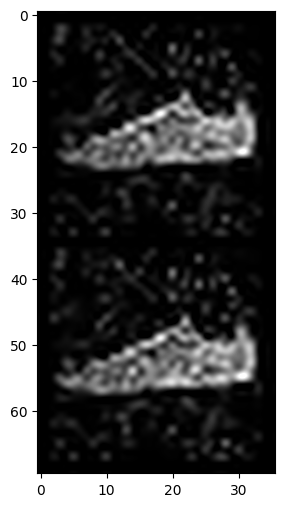

Iteration 2000    Loss 0.00087451480794698   PSNR_noisy: 8.16893897690582   PSRN_gt:8.219192716581455  PSNR_gt_sm: 8.188310041028101


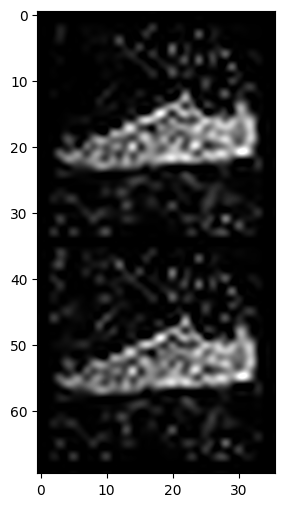

Iteration 2100    Loss 0.0008979765698313713   PSNR_noisy: 8.212797408492014   PSRN_gt:8.254899229984156  PSNR_gt_sm: 8.185762702146404


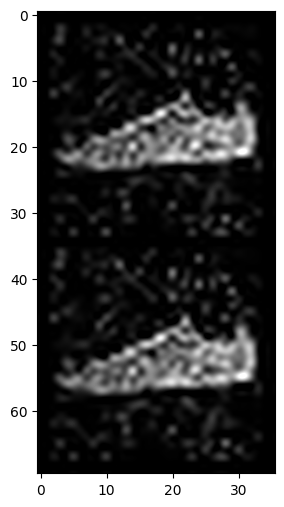

Iteration 2200    Loss 0.000408023945055902   PSNR_noisy: 8.120001984954667   PSRN_gt:8.168040647687288  PSNR_gt_sm: 8.183961589051723


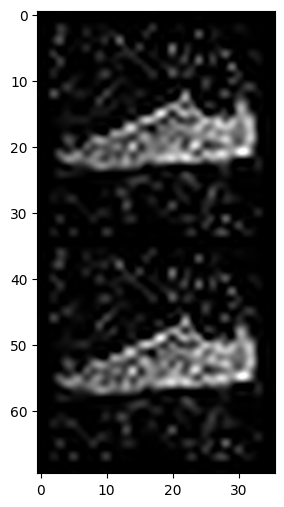

Iteration 2300    Loss 0.00038908730493858457   PSNR_noisy: 8.140163073138895   PSRN_gt:8.186687836669977  PSNR_gt_sm: 8.181080361663497


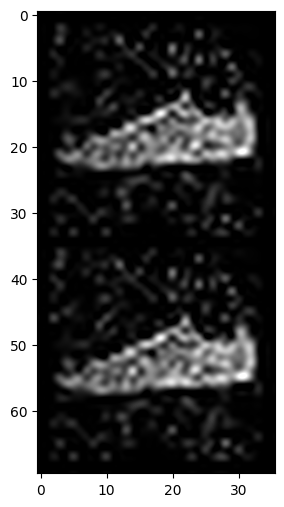

Iteration 2400    Loss 0.00035937409847974777   PSNR_noisy: 8.154941977259467   PSRN_gt:8.200418845647025  PSNR_gt_sm: 8.179225570225876


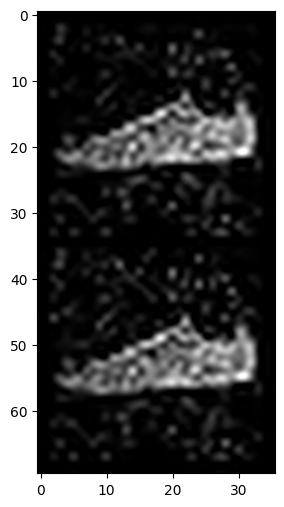

Iteration 2500    Loss 0.0005335015011951327   PSNR_noisy: 8.151581071516077   PSRN_gt:8.197020108656401  PSNR_gt_sm: 8.176409487576546


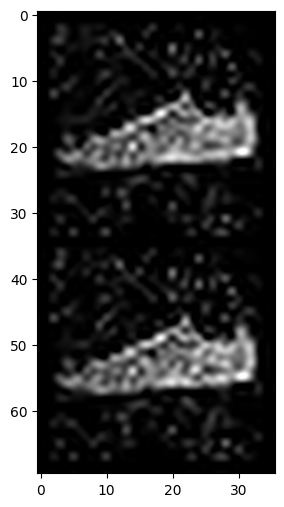

Iteration 2600    Loss 0.00048626872012391686   PSNR_noisy: 8.134818107789684   PSRN_gt:8.181957665034082  PSNR_gt_sm: 8.175244984184838


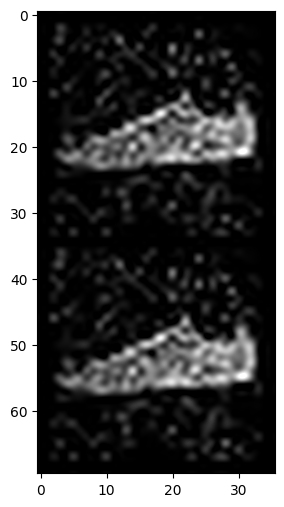

Iteration 2700    Loss 0.00022111512953415513   PSNR_noisy: 8.119810207690822   PSRN_gt:8.1639967846707  PSNR_gt_sm: 8.173802008869236


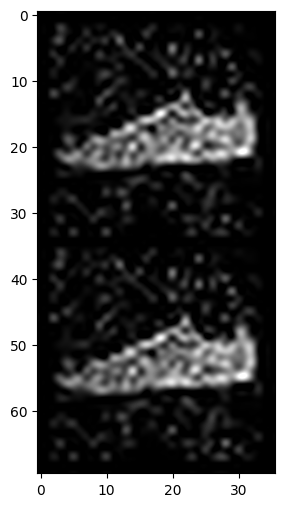

Iteration 2800    Loss 0.0002445305581204593   PSNR_noisy: 8.160047869609299   PSRN_gt:8.205414812787943  PSNR_gt_sm: 8.172286684755388


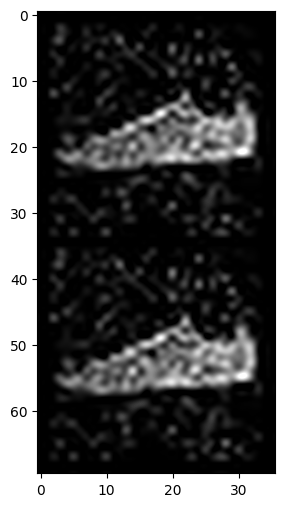

Iteration 2900    Loss 0.00020589730411302298   PSNR_noisy: 8.10894919132706   PSRN_gt:8.152286415958105  PSNR_gt_sm: 8.170106015156003
Starting optimization with ADAM


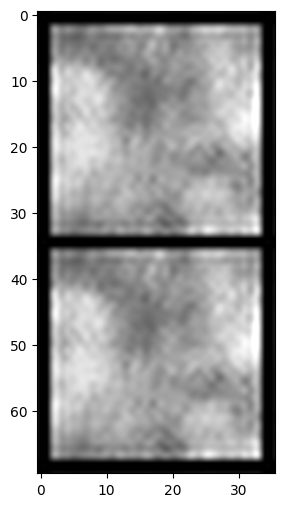

Iteration 0    Loss 0.134646475315094   PSNR_noisy: 8.027144580216998   PSRN_gt:7.578139122618303  PSNR_gt_sm: 7.578139122618303


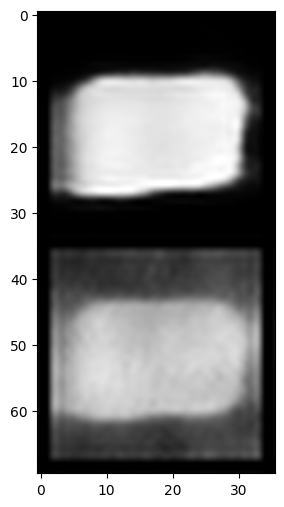

Iteration 100    Loss 0.013398829847574234   PSNR_noisy: 9.591187590816899   PSRN_gt:9.449287604714211  PSNR_gt_sm: 9.697584482610377


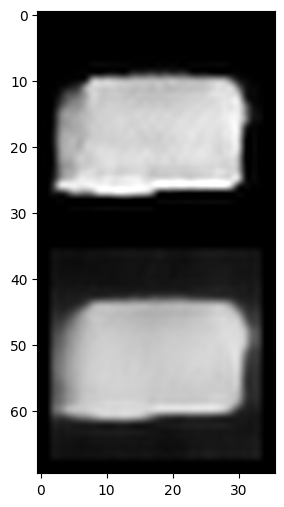

Iteration 200    Loss 0.009658237919211388   PSNR_noisy: 9.147396681691445   PSRN_gt:9.032315479699921  PSNR_gt_sm: 9.61312658885916


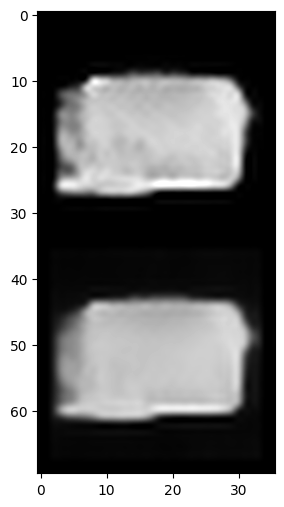

Iteration 300    Loss 0.007876940071582794   PSNR_noisy: 9.0940377774855   PSRN_gt:8.975604519555585  PSNR_gt_sm: 9.332912965564768


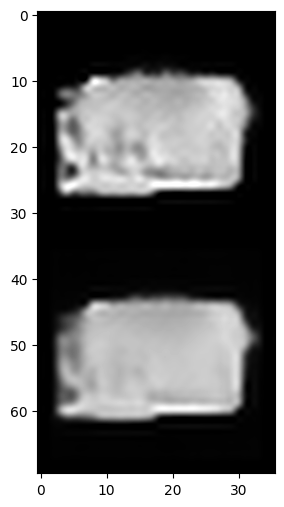

Iteration 400    Loss 0.006634166464209557   PSNR_noisy: 9.018819981389735   PSRN_gt:8.893511187508956  PSNR_gt_sm: 9.169580868995734


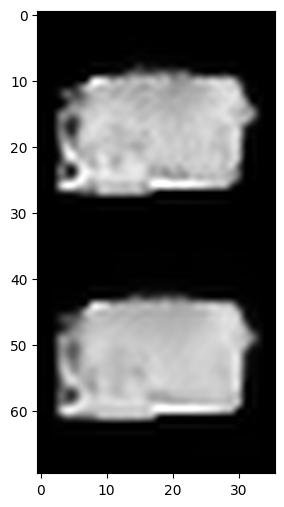

Iteration 500    Loss 0.006518763955682516   PSNR_noisy: 9.195005622386336   PSRN_gt:9.079269216608758  PSNR_gt_sm: 9.086339041426708


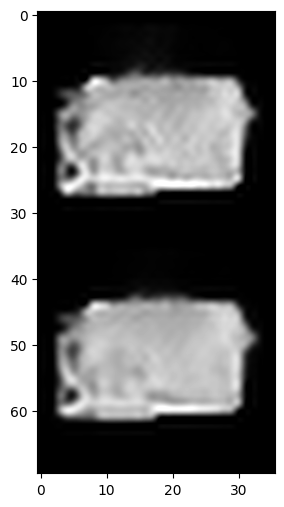

Iteration 600    Loss 0.0050395759753882885   PSNR_noisy: 9.117761771188794   PSRN_gt:9.008037631815728  PSNR_gt_sm: 9.04753859611705


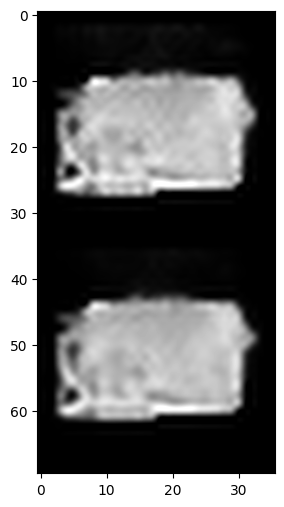

Iteration 700    Loss 0.004567310679703951   PSNR_noisy: 8.939297960573803   PSRN_gt:8.81119070668232  PSNR_gt_sm: 9.026449605041597


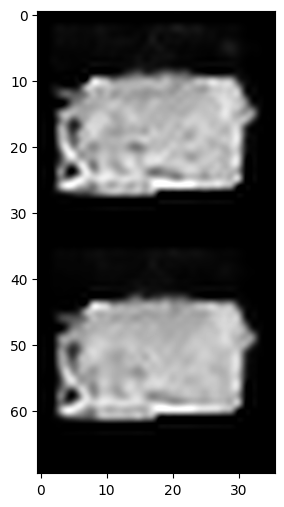

Iteration 800    Loss 0.003921568393707275   PSNR_noisy: 9.09981625839483   PSRN_gt:8.97346401392703  PSNR_gt_sm: 9.011829598714838


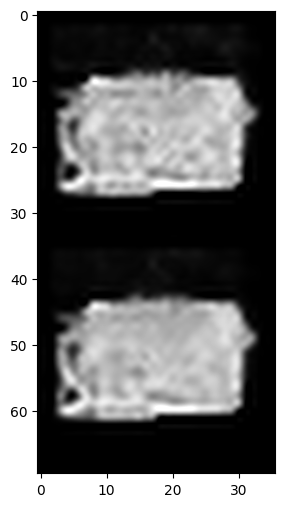

Iteration 900    Loss 0.004047261085361242   PSNR_noisy: 9.081933463848843   PSRN_gt:8.953126326166732  PSNR_gt_sm: 8.994704133250153


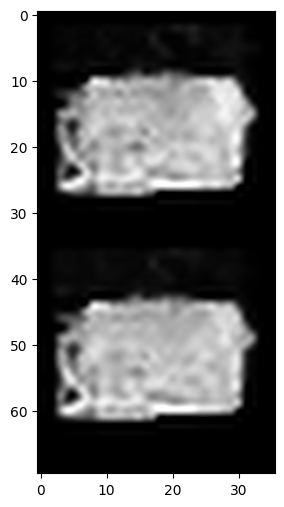

Iteration 1000    Loss 0.0039234766736626625   PSNR_noisy: 9.194888064388142   PSRN_gt:9.069792422418526  PSNR_gt_sm: 8.980372914563025


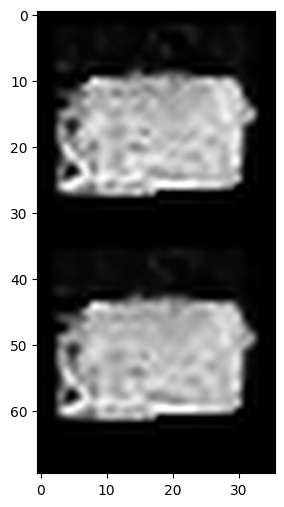

Iteration 1100    Loss 0.0032219039276242256   PSNR_noisy: 8.970330682443347   PSRN_gt:8.846410796945095  PSNR_gt_sm: 8.968742815764061


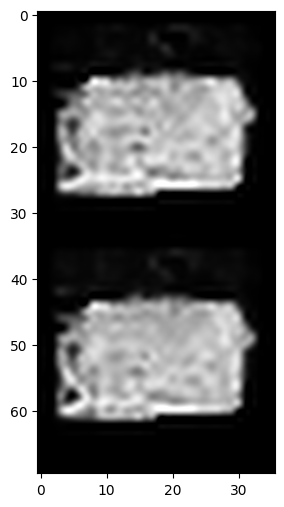

Iteration 1200    Loss 0.003398892469704151   PSNR_noisy: 8.991893604530485   PSRN_gt:8.861409458275366  PSNR_gt_sm: 8.959704718763042


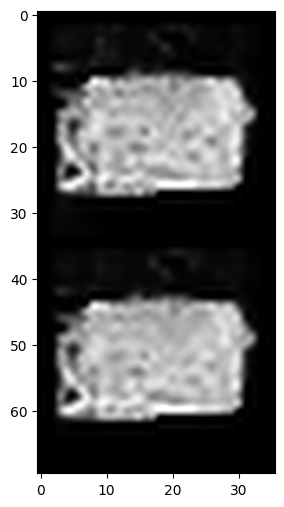

Iteration 1300    Loss 0.002872026991099119   PSNR_noisy: 9.155343744731685   PSRN_gt:9.024803314547906  PSNR_gt_sm: 8.954246996306406


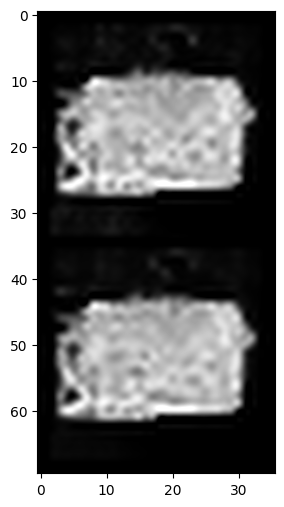

Iteration 1400    Loss 0.002679001074284315   PSNR_noisy: 8.956038874522715   PSRN_gt:8.819093922211218  PSNR_gt_sm: 8.94732991519646


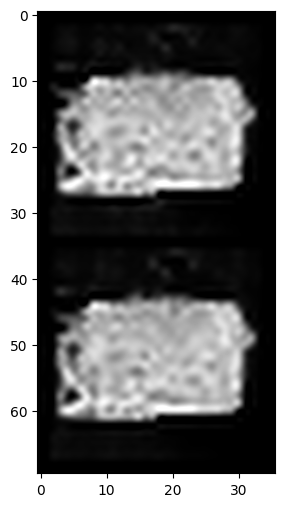

Iteration 1500    Loss 0.0022424948401749134   PSNR_noisy: 8.937784030262513   PSRN_gt:8.793020748342506  PSNR_gt_sm: 8.939158998215095


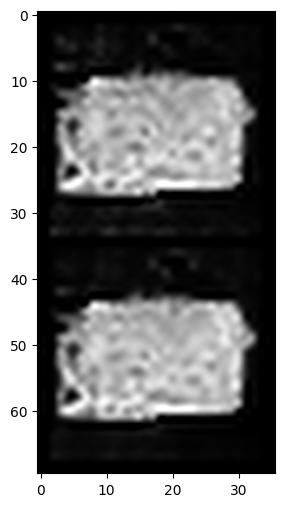

Iteration 1600    Loss 0.002608102047815919   PSNR_noisy: 9.171172553992822   PSRN_gt:9.02176335510578  PSNR_gt_sm: 8.933417804855045


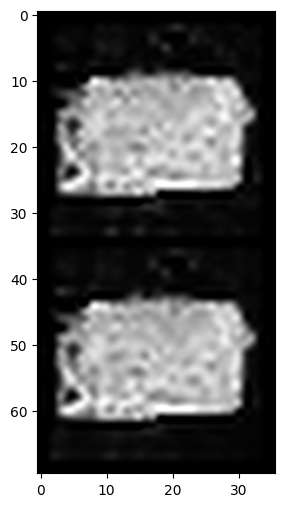

Iteration 1700    Loss 0.0019521735375747085   PSNR_noisy: 9.060628846065086   PSRN_gt:8.916156762546505  PSNR_gt_sm: 8.92741274313445


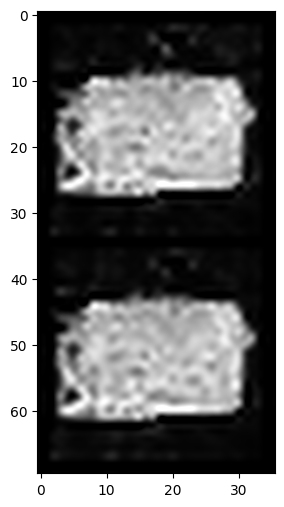

Iteration 1800    Loss 0.0020817755721509457   PSNR_noisy: 8.971268338341126   PSRN_gt:8.827045824949268  PSNR_gt_sm: 8.919126205472269


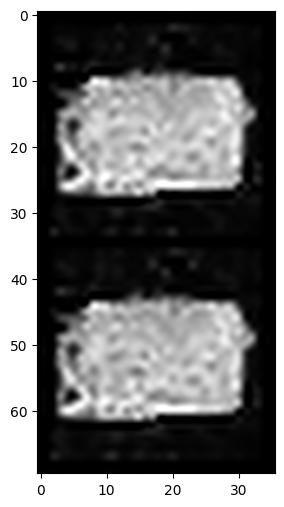

Iteration 1900    Loss 0.001759903272613883   PSNR_noisy: 8.905771789249332   PSRN_gt:8.758517496479216  PSNR_gt_sm: 8.914083032748819


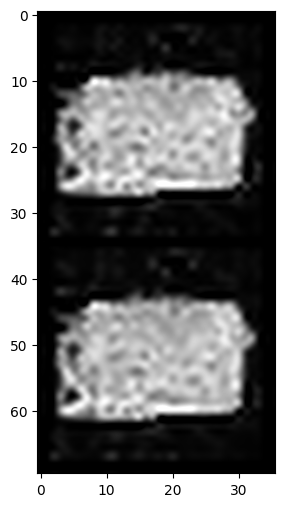

Iteration 2000    Loss 0.0015587511006742716   PSNR_noisy: 8.886151982099076   PSRN_gt:8.73821623660396  PSNR_gt_sm: 8.908305548664162


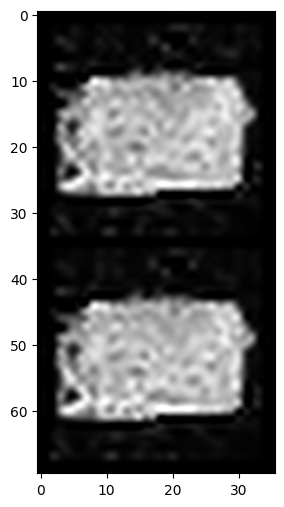

Iteration 2100    Loss 0.0015292954631149769   PSNR_noisy: 9.100445987624736   PSRN_gt:8.957522481882258  PSNR_gt_sm: 8.909403781136962


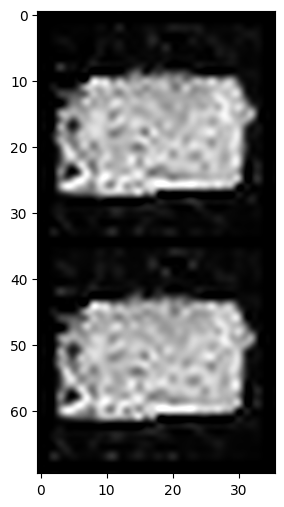

Iteration 2200    Loss 0.0014383273664861917   PSNR_noisy: 8.887915436046299   PSRN_gt:8.74238849071243  PSNR_gt_sm: 8.90316368514631


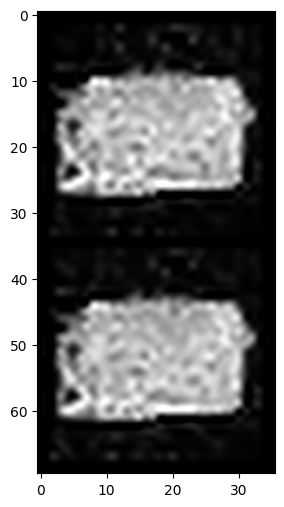

Iteration 2300    Loss 0.0013999873772263527   PSNR_noisy: 8.936523991615308   PSRN_gt:8.788669971332567  PSNR_gt_sm: 8.900118430785877


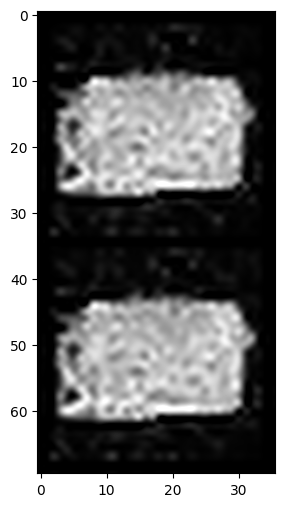

Iteration 2400    Loss 0.0011919988319277763   PSNR_noisy: 8.971529653217322   PSRN_gt:8.825845091793536  PSNR_gt_sm: 8.895730625105944


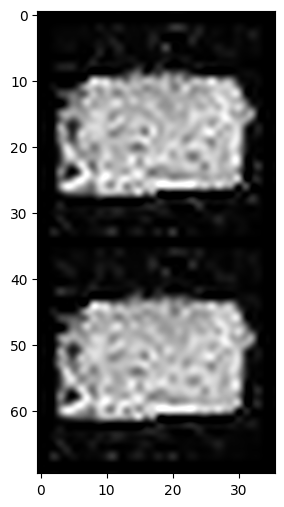

Iteration 2500    Loss 0.0011473707854747772   PSNR_noisy: 9.007513107172107   PSRN_gt:8.864444901686214  PSNR_gt_sm: 8.89104711067647


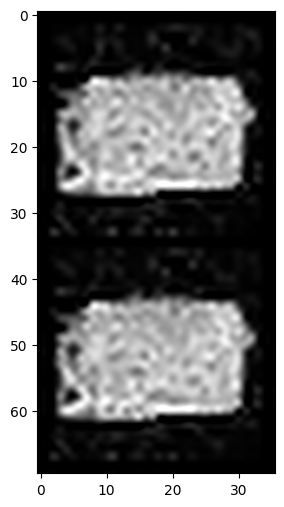

Iteration 2600    Loss 0.0010883306385949254   PSNR_noisy: 8.907390805808365   PSRN_gt:8.763871593012123  PSNR_gt_sm: 8.885868465856866


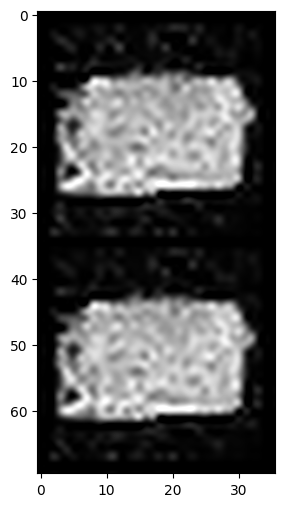

Iteration 2700    Loss 0.0009789974428713322   PSNR_noisy: 9.077963467482595   PSRN_gt:8.92860560120444  PSNR_gt_sm: 8.886638230710833


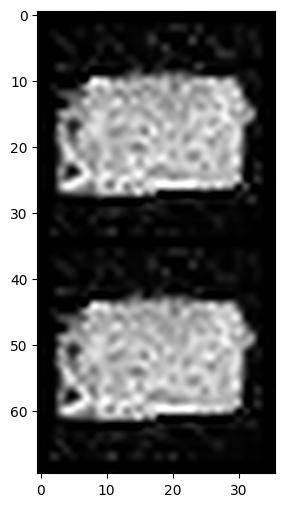

Iteration 2800    Loss 0.0007641669362783432   PSNR_noisy: 9.011502345770936   PSRN_gt:8.86566711025406  PSNR_gt_sm: 8.878808957780658


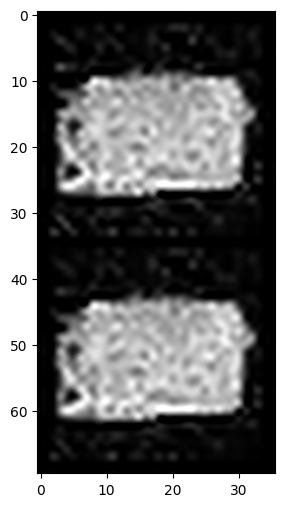

Iteration 2900    Loss 0.0008602954330854118   PSNR_noisy: 9.111085932756303   PSRN_gt:8.966894504151192  PSNR_gt_sm: 8.875644351997463


In [24]:
nets = list()
outs = list()

for j in range(len(images)):

  net = get_net(input_depth, 'skip', pad,
                  skip_n33d=128,
                  skip_n33u=128,
                  skip_n11=4,
                  num_scales=3,
                  upsample_mode='bilinear').type(dtype)

  net_input = get_noise(input_depth, INPUT, (img_pil.size[1], img_pil.size[0])).type(dtype).detach()
  # print(f"net_input.shape:{net_input.shape}")

  net_input_saved = net_input.detach().clone()
  noise = net_input.detach().clone()

  img_noisy_torch = np_to_torch(img_noisy_np).type(dtype)

  out_json = []
  out_avg = None
  last_net = None
  psrn_noisy_last = 0
  i = 0
  img_noisy_np = images[j][1]
  img_np = images[j][0]
  # print(f"img_np.shape:{img_np.shape}")

  p = get_params(OPT_OVER, net, net_input)
  optimize(OPTIMIZER, p, closure, LR, num_iter)

  nets.append(net)
  outs.append(out_json)


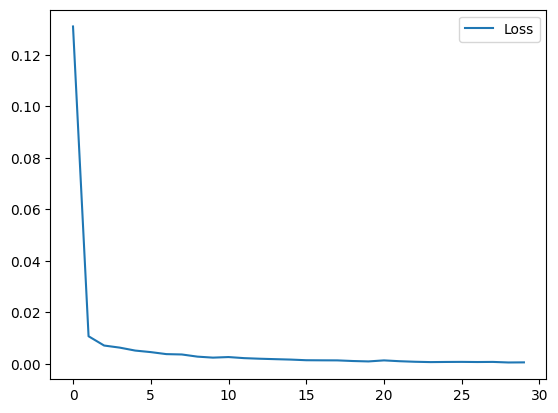

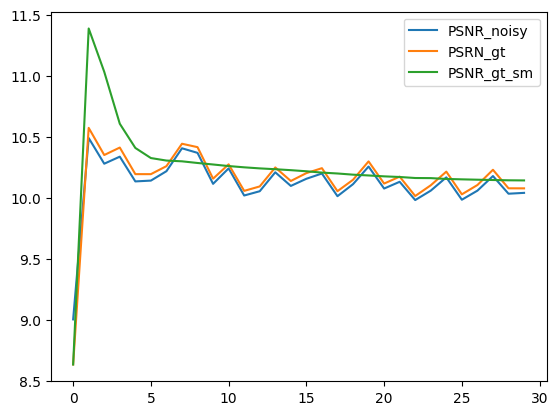

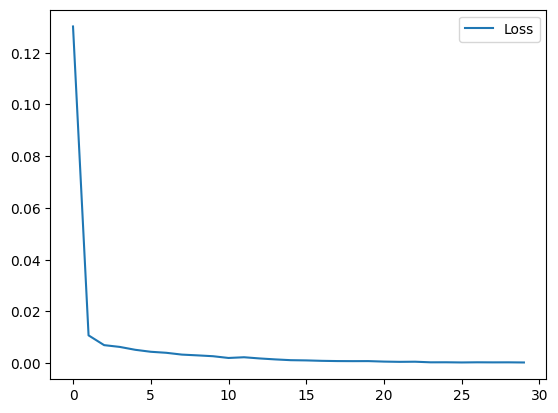

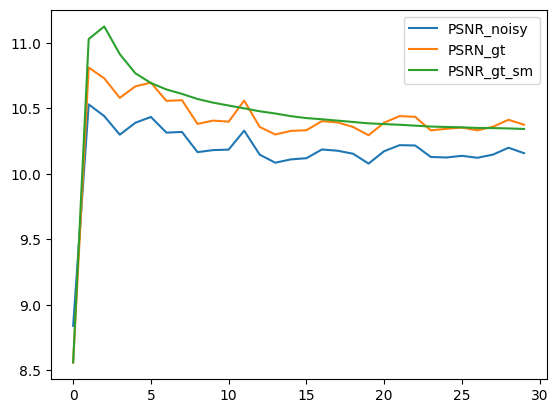

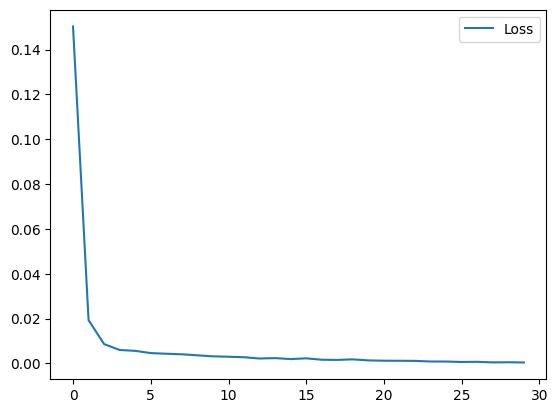

...

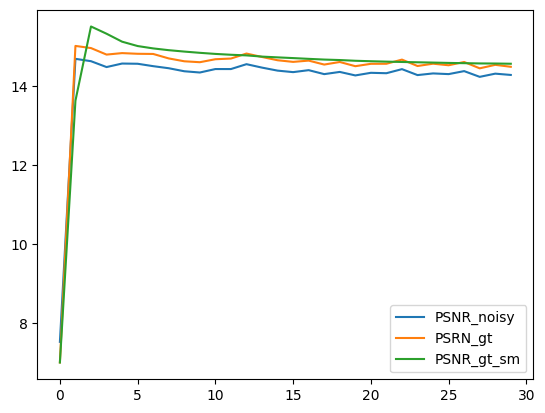

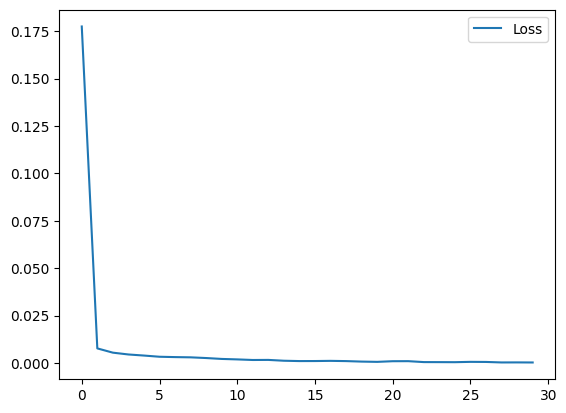

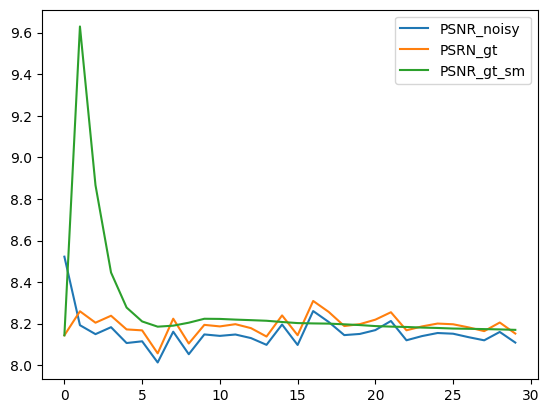

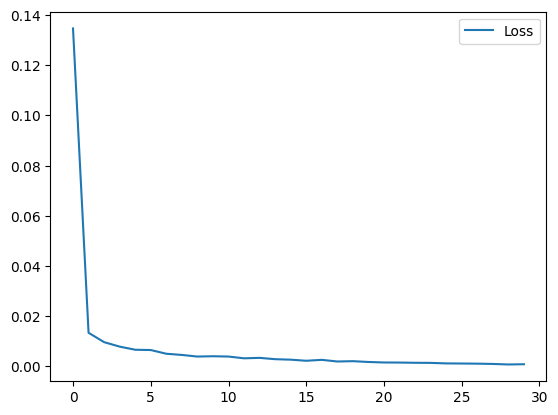

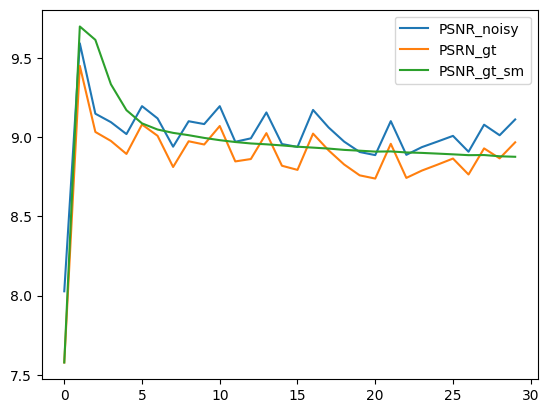

In [25]:
num=0
for out in outs:
  df = pd.DataFrame(out)
  df.columns = ['Loss','PSNR_noisy','PSRN_gt','PSNR_gt_sm']
  df.plot(y='Loss')
  df.plot(y=['PSNR_noisy','PSRN_gt','PSNR_gt_sm'])
  df.to_csv(f'/content/drive/MyDrive/Colab Notebooks/GAI_project4/results/DIP_result_{num}.csv',encoding = 'utf-8',index = False)
  num+=1

In [26]:
summary(net, net_input.squeeze(dim=0).shape)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ReflectionPad2d-1            [-1, 1, 32, 32]               0
            Conv2d-2            [-1, 4, 32, 32]               8
       BatchNorm2d-3            [-1, 4, 32, 32]               8
         LeakyReLU-4            [-1, 4, 32, 32]               0
   ReflectionPad2d-5            [-1, 1, 34, 34]               0
            Conv2d-6          [-1, 128, 16, 16]           1,280
       BatchNorm2d-7          [-1, 128, 16, 16]             256
         LeakyReLU-8          [-1, 128, 16, 16]               0
   ReflectionPad2d-9          [-1, 128, 18, 18]               0
           Conv2d-10          [-1, 128, 16, 16]         147,584
      BatchNorm2d-11          [-1, 128, 16, 16]             256
        LeakyReLU-12          [-1, 128, 16, 16]               0
  ReflectionPad2d-13          [-1, 128, 16, 16]               0
           Conv2d-14            [-1, 4,

In [27]:
# Defining model
n_steps, min_beta, max_beta = 1000, 10 ** -4, 0.02  # Originally used by the authors
ddpm = MyDDPM(MyUNet(n_steps), n_steps=n_steps, min_beta=min_beta, max_beta=max_beta, device=device)

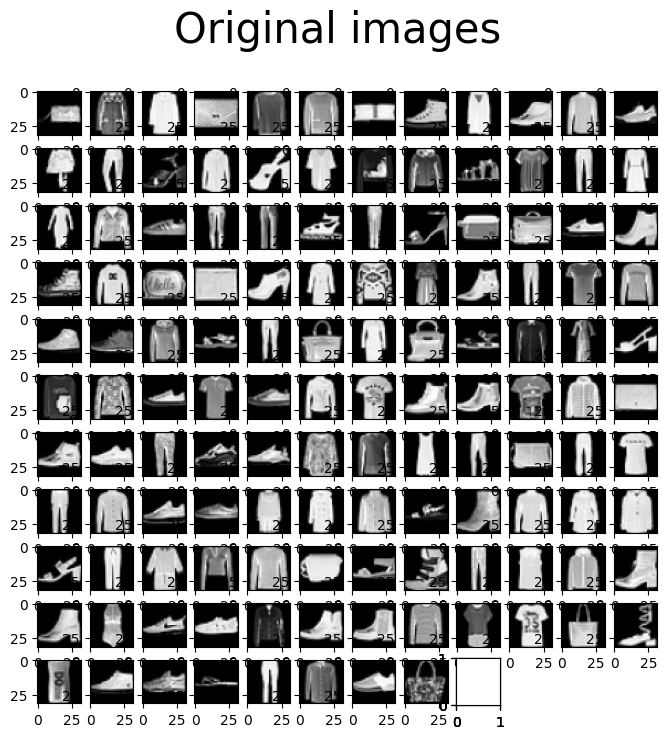

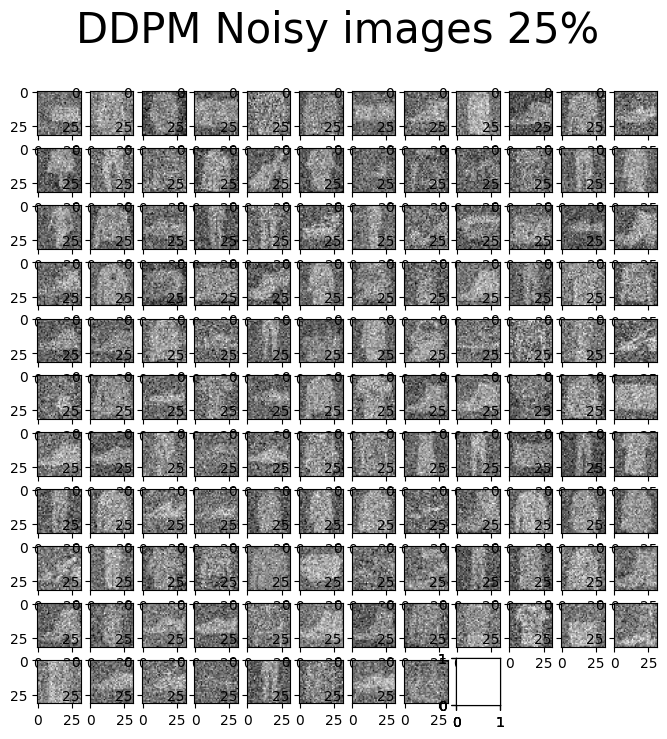

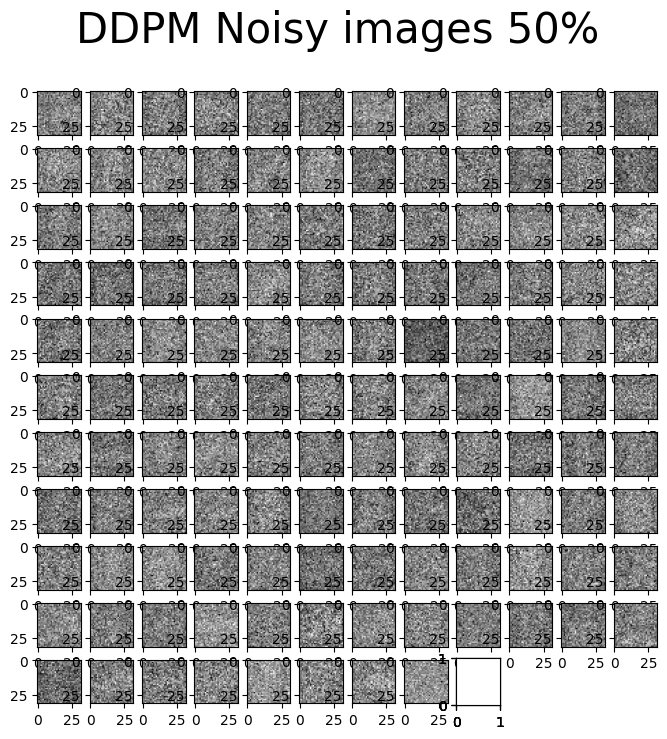

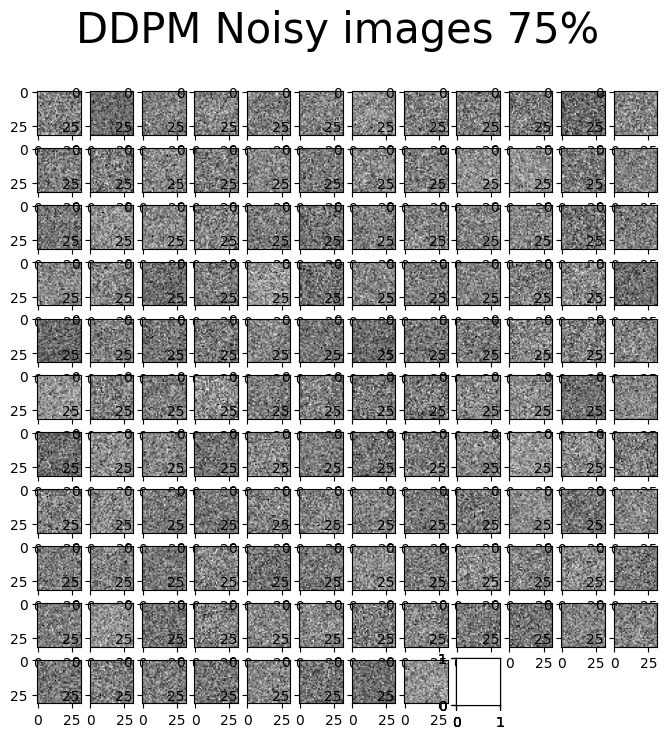

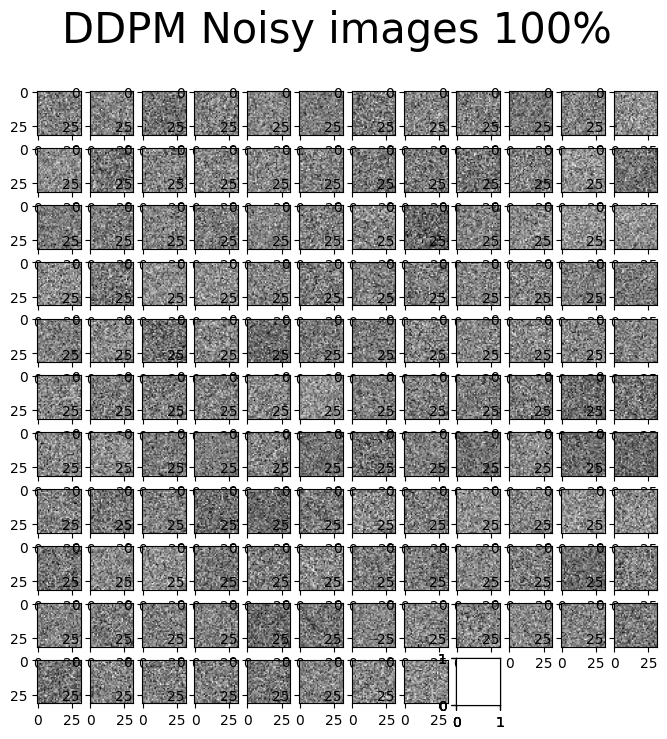

In [28]:
# Optionally, show the diffusion (forward) process
show_forward(ddpm, loader, device)

In [87]:
def training_loop(ddpm, loader, n_epochs, optim, device, display=False, store_path="ddpm_model.pt"):
    mse = nn.MSELoss()
    best_loss = float("inf")
    n_steps = ddpm.n_steps

    for epoch in tqdm(range(n_epochs), desc=f"Training progress", colour="#00ff00"):
        epoch_loss = 0.0
        for step, batch in enumerate(tqdm(loader, leave=False, desc=f"Epoch {epoch + 1}/{n_epochs}", colour="#005500")):
            # Loading data
            x0 = batch[0].to(device)
            y = batch[1].to(device)
            n = len(x0)
            # out = batch[0].detach().cpu().numpy()[0]
            # out_pil = np_to_pil(out)
            # out_np = pil_to_np(out_pil)

            # Picking some noise for each of the images in the batch, a timestep and the respective alpha_bars
            eta = torch.randn_like(x0).to(device)
            t = torch.randint(0, n_steps, (n,)).to(device)

            # Computing the noisy image based on x0 and the time-step (forward process)
            noisy_imgs = ddpm(x0, t, eta)

            # DIP
            noisy_imgs_dip = nets[0](noisy_imgs)

            # Getting model estimation of noise based on the images and the time-step
            eta_theta = ddpm.backward(noisy_imgs_dip, t.reshape(n, -1))

            # Optimizing the MSE between the noise plugged and the predicted noise
            loss = mse(eta_theta, eta)
            optim.zero_grad()
            loss.backward()
            optim.step()

            # noisy_pil = np_to_pil(noisy_imgs[0])
            # noisy_np = pil_to_np(noisy_pil)

            # print(noisy_np.shape)
            # print(out_np.shape)
            # psrn_noisy = compare_psnr(noisy_imgs.detach().cpu().numpy(), out_np)
            # psrn_dip    = compare_psnr(noisy_imgs_dip.detach().cpu().numpy(),out_np)
            # psrn_eta_theta = compare_psnr(eta_theta.detach().cpu().numpy(), out_np)

            epoch_loss += loss.item() * len(x0) / len(loader.dataset)

        log_string = f"Loss at epoch {epoch + 1}: {epoch_loss:.3f}"
        # log_string += f" psrn_noisy:{psrn_noisy} psrn_dip:{psrn_dip} psrn_eta_theta:{psrn_eta_theta}"

        # Storing the model
        if best_loss > epoch_loss:
            best_loss = epoch_loss
            torch.save(ddpm.state_dict(), store_path)
            log_string += " --> Best model ever (stored)"

        print(log_string)

In [88]:
store_path = "ddpm_dip_model_ver2.pt"
# Training
if not no_train:
  training_loop(ddpm, loader, n_epochs, optim=Adam(ddpm.parameters(), lr), device=device, store_path=store_path)


Training progress:   0%|          | 0/100 [00:00<?, ?it/s]

Epoch 1/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 1: 0.982 --> Best model ever (stored)


Epoch 2/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 2: 0.948 --> Best model ever (stored)


Epoch 3/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 3: 0.932 --> Best model ever (stored)


Epoch 4/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 4: 0.917 --> Best model ever (stored)


Epoch 5/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 5: 0.907 --> Best model ever (stored)


Epoch 6/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 6: 0.900 --> Best model ever (stored)


Epoch 7/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 7: 0.896 --> Best model ever (stored)


Epoch 8/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 8: 0.892 --> Best model ever (stored)


Epoch 9/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 9: 0.888 --> Best model ever (stored)


Epoch 10/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 10: 0.885 --> Best model ever (stored)


Epoch 11/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 11: 0.882 --> Best model ever (stored)


Epoch 12/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 12: 0.881 --> Best model ever (stored)


Epoch 13/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 13: 0.878 --> Best model ever (stored)


Epoch 14/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 14: 0.876 --> Best model ever (stored)


Epoch 15/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 15: 0.874 --> Best model ever (stored)


Epoch 16/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 16: 0.873 --> Best model ever (stored)


Epoch 17/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 17: 0.871 --> Best model ever (stored)


Epoch 18/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 18: 0.870 --> Best model ever (stored)


Epoch 19/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 19: 0.868 --> Best model ever (stored)


Epoch 20/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 20: 0.867 --> Best model ever (stored)


Epoch 21/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 21: 0.866 --> Best model ever (stored)


Epoch 22/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 22: 0.864 --> Best model ever (stored)


Epoch 23/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 23: 0.863 --> Best model ever (stored)


Epoch 24/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 24: 0.862 --> Best model ever (stored)


Epoch 25/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 25: 0.861 --> Best model ever (stored)


Epoch 26/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 26: 0.860 --> Best model ever (stored)


Epoch 27/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 27: 0.860 --> Best model ever (stored)


Epoch 28/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 28: 0.859 --> Best model ever (stored)


Epoch 29/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 29: 0.857 --> Best model ever (stored)


Epoch 30/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 30: 0.857 --> Best model ever (stored)


Epoch 31/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 31: 0.856 --> Best model ever (stored)


Epoch 32/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 32: 0.856 --> Best model ever (stored)


Epoch 33/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 33: 0.855 --> Best model ever (stored)


Epoch 34/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 34: 0.855 --> Best model ever (stored)


Epoch 35/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 35: 0.854 --> Best model ever (stored)


Epoch 36/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 36: 0.853 --> Best model ever (stored)


Epoch 37/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 37: 0.853 --> Best model ever (stored)


Epoch 38/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 38: 0.852 --> Best model ever (stored)


Epoch 39/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 39: 0.852


Epoch 40/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 40: 0.851 --> Best model ever (stored)


Epoch 41/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 41: 0.850 --> Best model ever (stored)


Epoch 42/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 42: 0.850 --> Best model ever (stored)


Epoch 43/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 43: 0.850 --> Best model ever (stored)


Epoch 44/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 44: 0.850 --> Best model ever (stored)


Epoch 45/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 45: 0.849 --> Best model ever (stored)


Epoch 46/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 46: 0.848 --> Best model ever (stored)


Epoch 47/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 47: 0.848 --> Best model ever (stored)


Epoch 48/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 48: 0.847 --> Best model ever (stored)


Epoch 49/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 49: 0.847 --> Best model ever (stored)


Epoch 50/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 50: 0.846 --> Best model ever (stored)


Epoch 51/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 51: 0.846


Epoch 52/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 52: 0.846 --> Best model ever (stored)


Epoch 53/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 53: 0.845 --> Best model ever (stored)


Epoch 54/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 54: 0.845


Epoch 55/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 55: 0.845 --> Best model ever (stored)


Epoch 56/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 56: 0.845 --> Best model ever (stored)


Epoch 57/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 57: 0.844 --> Best model ever (stored)


Epoch 58/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 58: 0.844 --> Best model ever (stored)


Epoch 59/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 59: 0.843 --> Best model ever (stored)


Epoch 60/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 60: 0.843 --> Best model ever (stored)


Epoch 61/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 61: 0.842 --> Best model ever (stored)


Epoch 62/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 62: 0.843


Epoch 63/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 63: 0.842 --> Best model ever (stored)


Epoch 64/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 64: 0.842 --> Best model ever (stored)


Epoch 65/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 65: 0.842 --> Best model ever (stored)


Epoch 66/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 66: 0.841 --> Best model ever (stored)


Epoch 67/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 67: 0.841 --> Best model ever (stored)


Epoch 68/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 68: 0.841 --> Best model ever (stored)


Epoch 69/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 69: 0.840 --> Best model ever (stored)


Epoch 70/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 70: 0.840 --> Best model ever (stored)


Epoch 71/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 71: 0.840 --> Best model ever (stored)


Epoch 72/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 72: 0.840


Epoch 73/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 73: 0.839 --> Best model ever (stored)


Epoch 74/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 74: 0.838 --> Best model ever (stored)


Epoch 75/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 75: 0.839


Epoch 76/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 76: 0.838 --> Best model ever (stored)


Epoch 77/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 77: 0.838 --> Best model ever (stored)


Epoch 78/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 78: 0.838 --> Best model ever (stored)


Epoch 79/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 79: 0.838 --> Best model ever (stored)


Epoch 80/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 80: 0.839


Epoch 81/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 81: 0.837 --> Best model ever (stored)


Epoch 82/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 82: 0.837 --> Best model ever (stored)


Epoch 83/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 83: 0.837 --> Best model ever (stored)


Epoch 84/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 84: 0.837 --> Best model ever (stored)


Epoch 85/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 85: 0.836 --> Best model ever (stored)


Epoch 86/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 86: 0.836


Epoch 87/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 87: 0.836 --> Best model ever (stored)


Epoch 88/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 88: 0.835 --> Best model ever (stored)


Epoch 89/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 89: 0.835


Epoch 90/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 90: 0.835 --> Best model ever (stored)


Epoch 91/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 91: 0.835


Epoch 92/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 92: 0.835


Epoch 93/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 93: 0.834 --> Best model ever (stored)


Epoch 94/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 94: 0.834 --> Best model ever (stored)


Epoch 95/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 95: 0.834


Epoch 96/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 96: 0.834


Epoch 97/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 97: 0.834


Epoch 98/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 98: 0.833 --> Best model ever (stored)


Epoch 99/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 99: 0.833 --> Best model ever (stored)


Epoch 100/100:   0%|          | 0/469 [00:00<?, ?it/s]

Loss at epoch 100: 0.833


In [89]:
# Loading the trained model
best_model = MyDDPM(MyUNet(), n_steps=n_steps, device=device)
best_model.load_state_dict(torch.load(store_path, map_location=device))
best_model.eval()
print("Model loaded")

Model loaded


Generating new images


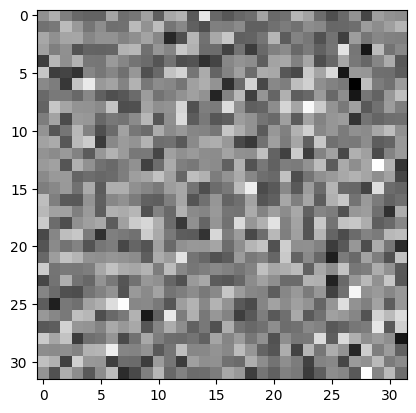

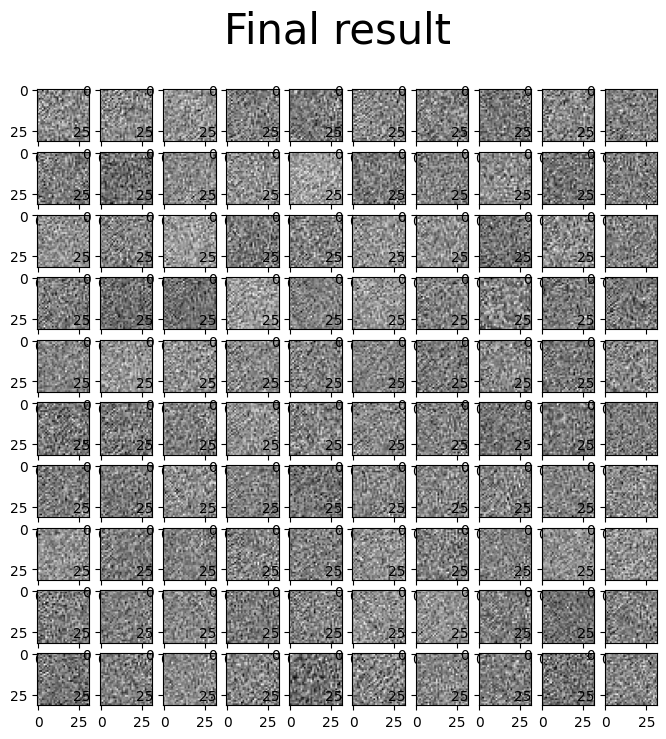

In [90]:
print("Generating new images")
generated = generate_new_images(
        best_model,
        n_samples=100,
        device=device,
        gif_name="fashion.gif" if fashion else "mnist.gif"
    )
show_images(generated, "Final result")